In [1]:
#| include: false
import pandas as pd
import numpy as np
import pickle

import re

import itables

import warnings
warnings.filterwarnings("ignore")

import csv

import dash
from dash import dcc, html
from dash.dependencies import Input, Output

import matplotlib.pyplot as plt
from matplotlib.colors import Normalize
from matplotlib.cm import ScalarMappable
from mpl_toolkits.axes_grid1 import make_axes_locatable
from matplotlib.colors import LinearSegmentedColormap

import seaborn as sns
import plotly.express as px
import plotly.graph_objs as go
from plotly.subplots import make_subplots 
from ipywidgets import interact, widgets
import plotly.offline as pyo
import plotly.io as pio

import geopandas as gpd
import shapely.geometry as sg
from shapely.geometry import MultiPolygon, Polygon
from shapely import wkt

import folium
from folium.plugins import DualMap, HeatMap

import warnings
warnings.filterwarnings("ignore")
warnings.filterwarnings("ignore", category=UserWarning, module="plotly")

from dbfread import DBF

In [2]:
#| include: false
# Year 2001
ethnicity_2001= pd.read_csv('preprocessed files/2001/ethnicity_2001.csv')
country_dissimilarity_2001 = pd.read_csv('preprocessed files/2001/country_dissimilarity_2001.csv')
LAD_dissimilarity_2001 = pd.read_csv('preprocessed files/2001/LAD_dissimilarity_2001.csv')
country_simpson_2001 = pd.read_csv('preprocessed files/2001/country_simpson_2001.csv')
LAD_simpson_2001 = pd.read_csv('preprocessed files/2001/LAD_simpson_2001.csv')
LAD_moran_2001 = pd.read_csv('preprocessed files/2001/LAD_moran_2001.csv')

LAD_2001 = gpd.read_file('preprocessed files/2001/LAD_2001.shp')

with open('preprocessed files/2001/OA_borders_2001.pkl', 'rb') as f:
    OA_borders_2001 = pickle.load(f)
with open('preprocessed files/2001/LSOA_borders_2001.pkl', 'rb') as f:
    LSOA_borders_2001 = pickle.load(f)
with open('preprocessed files/2001/MSOA_borders_2001.pkl', 'rb') as f:
    MSOA_borders_2001 = pickle.load(f)
with open('preprocessed files/2001/LAD_borders_2001.pkl', 'rb') as f:
    LAD_borders_2001 = pickle.load(f)

In [3]:
#| include: false
# Year 2011
ethnicity_2011 = pd.read_csv('preprocessed files/2011/ethnicity_2011.csv')
country_dissimilarity_2011 = pd.read_csv('preprocessed files/2011/country_dissimilarity_2011.csv')
LAD_dissimilarity_2011 = pd.read_csv('preprocessed files/2011/LAD_dissimilarity_2011.csv')
country_simpson_2011 = pd.read_csv('preprocessed files/2011/country_simpson_2011.csv')
LAD_simpson_2011 = pd.read_csv('preprocessed files/2011/LAD_simpson_2011.csv')
LAD_moran_2011 = pd.read_csv('preprocessed files/2011/LAD_moran_2011.csv')

LAD_2011 = gpd.read_file('preprocessed files/2011/LAD_2011.shp')

with open('preprocessed files/2011/OA_borders_2011.pkl', 'rb') as f:
    OA_borders_2011 = pickle.load(f)
with open('preprocessed files/2011/LSOA_borders_2011.pkl', 'rb') as f:
    LSOA_borders_2011 = pickle.load(f)
with open('preprocessed files/2011/MSOA_borders_2011.pkl', 'rb') as f:
    MSOA_borders_2011 = pickle.load(f)
with open('preprocessed files/2011/LAD_borders_2011.pkl', 'rb') as f:
    LAD_borders_2011 = pickle.load(f)

In [4]:
#| include: false
# Year 2021
ethnicity_2021= pd.read_csv('preprocessed files/2021/ethnicity_2021.csv')
country_dissimilarity_2021 = pd.read_csv('preprocessed files/2021/country_dissimilarity_2021.csv')
LAD_dissimilarity_2021 = pd.read_csv('preprocessed files/2021/LAD_dissimilarity_2021.csv')
country_simpson_2021 = pd.read_csv('preprocessed files/2021/country_simpson_2021.csv')
LAD_simpson_2021 = pd.read_csv('preprocessed files/2021/LAD_simpson_2021.csv')
LAD_moran_2021 = pd.read_csv('preprocessed files/2021/LAD_moran_2021.csv')

LAD_2021 = gpd.read_file('preprocessed files/2021/LAD_2021.shp')

with open('preprocessed files/2021/OA_borders_2021.pkl', 'rb') as f:
    OA_borders_2021 = pickle.load(f)
with open('preprocessed files/2021/LSOA_borders_2021.pkl', 'rb') as f:
    LSOA_borders_2021 = pickle.load(f)
with open('preprocessed files/2021/MSOA_borders_2021.pkl', 'rb') as f:
    MSOA_borders_2021 = pickle.load(f)
with open('preprocessed files/2021/LAD_borders_2021.pkl', 'rb') as f:
    LAD_borders_2021 = pickle.load(f)

# Executive Summary
<p style="text-align: justify;" >
This study presents a detailed analysis of ethnic segregation in England, utilizing census data from 2001, 2011, and 2021. The analysis covers the country level, Local Authority District (LAD) level, and specific cities, including Birmingham, Leicester, Bradford, Blackburn with Darwen, Oldham, Pendle, and London. Three key segregation indices were calculated: the Dissimilarity Index, the Simpson Index, and Moran's I.
<p style="text-align: justify;" >
There is a notable decrease in the dissimilarity index across the study period (2001-2021), indicating a reduction in ethnic segregation at both the country and LAD levels. This trend suggests improved spatial integration of ethnic groups within England.
<p style="text-align: justify;" >
The Simpson Index, which measures diversity within neighbourhoods, shows a general decline over the study period. This decrease suggests that neighbourhoods are becoming more ethnically diverse. At the Output Area (OA) level, some neighbourhoods with high ethnic concentrations have higher Simpson Index values, indicating lower diversity within those specific areas. However, when these values are aggregated across entire cities or LADs, the overall Simpson Index is lower, reflecting a balance of diverse neighbourhoods within larger geographic units.
<p style="text-align: justify;" >
Moran's I, which measures spatial autocorrelation, indicates a decrease at the country level for White, Asian, and Black ethnic groups, suggesting reduced clustering and greater dispersion of these populations.
Conversely, at the OA level within each LAD, Moran's I is increasing for all ethnic groups, indicating that within these smaller areas, ethnic groups are becoming more clustered over time.
<p style="text-align: justify;" >
In the next phase, Birmingham, Leicester, Bradford, Blackburn with Darwen, Oldham, Pendle, and London were selected for detailed analysis due to significant differences between their town-wide and OA-based Simpson Index values.
In these cities, localized ethnic concentrations result in higher Simpson Index values at the OA level, highlighting pockets of low diversity. However, at the city-wide level, the diversity is higher, reflecting a mix of different neighbourhoods.
<p style="text-align: justify" >

# Introduction
<p style="text-align: justify;" >
Segregation, particularly residential segregation, refers to the spatial separation of different social groups within a city or metropolitan area. This phenomenon often results in the clustering of individuals from similar socioeconomic backgrounds, ethnicities, or races in distinct neighbourhoods or regions. 
<p style="text-align: justify;" >
Research on segregation is traditionally associated with studies on residential segregation and the patterns of spatial clustering of minority ethnic groups or residents with immigrant backgrounds.
<p style="text-align: justify;" >
Spatial segregation might happen in various types of spaces, in living places, work, leisure, means of transport and daily encounters. Spatial separation mirrors the way societies are organized, produce and distribute resources. Segregation reflects a preference for living in more homogenous areas and is usually connected with ethnic minority or immigrant communities. [@Piekut2021]
<p style="text-align: justify;" >
In this thesis, the ethnic segregation the UK, will be computed and its changes during the time will be observed. Although English neighbourhoods have become more ethnically diverse, ethnic segregation is still prevalent and the extent of segregation varies greatly by ethnicity. Immigrants from particular ethnic groups tend to co-locate in space forming segregated communities because of their limited opportunities in an urban area. The segregation of minority populations in England varies among ethnic groups. [@patias2023]
</p>

# Data Source
<p style="text-align: justify;" >
This analysis uses the aggregated Census data (2001, 2011 and 2021) which is available in geographical areas used in National Statistics work. The data of ethnic groups are available in OA, LSOA and MSOA. 
<p style="text-align: justify;" >
<b>Output Areas (OA)</b> were created for Census data, specifically for the output of census estimates. The OA is the lowest geographical level at which census estimates are provided, typically encompassing approximately 300 people.
<p style="text-align: justify;" >
<b>Super Output Areas (SOA)</b> are a geography hierarchy designed to improve the reporting of small-area statistics. In England and Wales <b>Lower Layer SOAs (LSOA)</b> with a minimum population of 1,000 and <b>Middle Layer SOAs (MSOA)</b> with a minimum population of 5,000 were introduced in 2004. LSOAs and MSOAs are of consistent size across the country and will not be subject to regular boundary change. 
<p style="text-align: justify;" >
<b>Local Authority District (LAD)</b> or also known as local authority districts or local government districts (to distinguish from unofficial city districts) are a level of subnational division of England used for the purposes of local government.[@LADdef]
<p style="text-align: justify;" >
Spatially, the Output Areas (OAs) exhibit a fine-grained nature, with a median radius of 105 meters. To enhance social homogeneity, the OAs were combined into LSOAs. Typically, each LSOA encompasses five OAs. The units at each scale are nested hierarchically within one another. Within this spatial framework, we examine the distributions of four ethnic groups. These ethnic categories stem from a larger pool of 16 to 19 groups, each representing distinct classifications based on various criteria such as country of ancestry and skin colour.[@Jones2015]. 

The datasets used in this analysis were gotten from:

- <b>Census Data</b>: The dataset provides information about the ethnic group of the usual resident population of England and Wales as at census day. It contains the OA codes and the observation of ethnic groups in each OA.[@CensusData]

- <b>Lookup</b>: This file links and aggregate data at different geographic levels (e.g., from OA to larger areas like LSOAs or MSOAs) for spatial analysis.[@ShapeData]

- <b>Census boundaries (Shape Files)</b>: This file contains the polygons of boundaries of each OA.[@ShapeData]

In this section, an analysis of segregation patterns in the UK at both the country and Local Authority District (LAD) levels is conducted across three different years: 2001, 2011, and 2021. 
</p>

# Data Pre-processing
<p style="text-align: justify;" >
The census data available is available for years of 2001, 2011, 2021 without any missing values. But in order to perform the analysis, the data should be manipulated. in this section, the pre-processing of each year is briefly explained.



## Data of 2001
<p style="text-align: justify;" >
In 2001, the primary census data exhibited the following structure: There were 175,434 rows and 18 columns, without any missing values. The initial two columns contained OA data, while the subsequent 16 columns represented the count of 16 ethnic groups within each OA. These groups were later categorized into four main ethnicities: White, Asian, Black, and Other.
<p style="text-align: justify;" >
To extract the higher levels data from OA level, a lookup file was employed. This file contained OA, LSOA and MSOA codes, as well as names for each LSOA and MSOA. However, there was a challenge in merging census dataset and lookup file as the census data utilized old OA codes, while the lookup file employed new OA codes. To resolve this disparity, a connection file was used to establish the relationship between the two datasets.
<p style="text-align: justify;" >
Additionally, in 2001, the lookup file lacked LAD codes and names. Since the LAD codes were necessary for further analysis, the 2011 lookup file was utilized to append LAD codes and names to the 2001 lookup data.
<p style="text-align: justify;" >
At the largest scale (LAD), which ranges in population from 2,151 to 977,057, there are 348 areas. At the smallest areal scale, there are 175,434 output areas (OAs), with population ranging from 96 to 4,157 and an average of 296.64. These OAs were aggregated into 34,378 lower-level super output areas (LSOAs) and 7,194 middle-level super output areas (MSOAs), with mean populations of 1,513.08 (SD = 202.7) and 7,234.04 (SD = 1,319.98), respectively. The total population was 52,041,655.
</p>


In [5]:
#| include: false
# Census Data of 2001 at a glance
ethnicity_2001.head()

,OA01CD,LSOA01CD,MSOA01CD,LAD01CD,LSOA01NM,MSOA01NM,LAD01NM,asian,black,other,white,total_pop
0,E00000001,E01000001,E02000001,E09000001,City of London 001A,City of London 001,City of London,10,0,3,202,215
1,E00000002,E01000001,E02000001,E09000001,City of London 001A,City of London 001,City of London,6,0,3,92,101
2,E00000003,E01000001,E02000001,E09000001,City of London 001A,City of London 001,City of London,14,0,4,189,207
3,E00000004,E01000001,E02000001,E09000001,City of London 001A,City of London 001,City of London,10,0,6,262,278
4,E00000005,E01000001,E02000001,E09000001,City of London 001A,City of London 001,City of London,23,3,0,208,234


## Data of 2011
<p style="text-align: justify;" >
In 2011, the primary census data exhibited the following structure: There were 181,408 rows and 19 columns, without any missing values. The first column contained OA data, while the subsequent 18 columns represented the count of 18 ethnic groups within each OA. The same as 2001, these groups were later categorized into four main ethnicities: White, Asian, Black, and Other.
<p style="text-align: justify;" >
The lookup file in 2011 contained the whole codes and names for OA, LSOA, MSOA and LAD so these 2 datasets were combined to extract the higher levels data from OA level.
<p style="text-align: justify;" >
At the largest scale (LAD), which ranges in population from 2,203 to 1,073,045, there are 348 areas. At the smallest areal scale, there are 181,408 OAs, with population ranging from 91 to 4,140 and an average of 309.11. These OAs were aggregated into 34,753 LSOAs and 7,201 MSOAs, with mean populations of 1,613.55 (SD = 303.38) and 7,787.24 (SD = 1,599.63), respectively. The total population was 56,075,912.
</p>

In [6]:
#| include: false
# Census Data of 2011 at a glance
ethnicity_2011.head()

,OA11CD,LSOA11CD,MSOA11CD,LAD11CD,LSOA11NM,MSOA11NM,LAD11NM,asian,black,other,white,total_pop
0,E00000001,E01000001,E02000001,E09000001,City of London 001A,City of London 001,City of London,6,0,13,175,194
1,E00000003,E01000001,E02000001,E09000001,City of London 001A,City of London 001,City of London,26,3,15,206,250
2,E00000005,E01000001,E02000001,E09000001,City of London 001A,City of London 001,City of London,25,4,17,321,367
3,E00000007,E01000001,E02000001,E09000001,City of London 001A,City of London 001,City of London,20,0,8,95,123
4,E00000010,E01000003,E02000001,E09000001,City of London 001C,City of London 001,City of London,12,5,5,80,102


## Data of 2021
<p style="text-align: justify;" >
In 2021, the primary census data exhibited the following structure: There were 3,777,600 rows and 5 columns, with no missing values. The first 2 columns contained OA data. However, the structure of this dataset differed from previous datasets. The ethnicity group, which consisted of 20 categories, was consolidated into one column, with the count of each ethnicity group in each OA recorded in the observation column. To maintain consistency, this dataset was converted to the format of previous datasets and merged with the lookup file.
<p style="text-align: justify;" >
At the largest scale (LAD), which ranges in population from 2,054 to 1,144,951, there are 331 areas. At the smallest areal scale, there are 188,880 OAs, with population ranging from 97 to 4,500 and an average of 315.53. These OAs were aggregated into 35,672 LSOAs and 7,264 MSOAs, with mean populations of 1,670.73 (SD = 354.21) and 8,204.63 (SD = 1,815.62), respectively. The total population was 59,598,449.

# Population and ethnicity distribution in England
<p style="text-align: justify;" >
In @fig-fracoverviewann, which illustrates the population changes in England over the years and the shifts in ethnic fractions within the population, it is noticeable that alongside the population growth, the proportion of the White ethnicity is declining, whereas the fractions of Asian, Black, and Other ethnic groups are on the rise.

In [7]:
#| include: false
# Census Data of 2021 at a glance
ethnicity_2021.head()

,OA21CD,LSOA21CD,MSOA21CD,LAD21CD,LSOA21NM,MSOA21NM,LAD21NM,asian,black,other,white,total_pop
0,E00000001,E01000001,E02000001,E09000001,City of London 001A,City of London 001,City of London,5,3,13,155,176
1,E00000003,E01000001,E02000001,E09000001,City of London 001A,City of London 001,City of London,24,5,17,209,255
2,E00000005,E01000001,E02000001,E09000001,City of London 001A,City of London 001,City of London,13,0,14,85,112
3,E00000007,E01000001,E02000001,E09000001,City of London 001A,City of London 001,City of London,24,2,12,106,144
4,E00000010,E01000003,E02000001,E09000001,City of London 001C,City of London 001,City of London,10,12,33,120,175


In [8]:
#| echo: false
#| label: fig-fracoverviewann
#| fig-cap: Ethnic Group Fractions Over Time
# Ethnic Group Fractions Over Time

country_dissimilarity_total = pd.concat([country_dissimilarity_2001, country_dissimilarity_2011, country_dissimilarity_2021], ignore_index=True)

fig = go.Figure()

# Add traces for each ethnic group fraction as stacked bars with percentage annotations outside
fig.add_trace(go.Bar(x=country_dissimilarity_total['year'], y=country_dissimilarity_total['white_frac'], 
                     name='White', legendgroup='ethnic_group', width=4, marker=dict(color='gray'),
                     text=country_dissimilarity_total['white_frac'] * 100, textposition='outside', 
                     texttemplate='%{text:.2f}%'))

fig.add_trace(go.Bar(x=country_dissimilarity_total['year'], y=country_dissimilarity_total['asian_frac'], 
                     name='Asian', legendgroup='ethnic_group', width=4, marker=dict(color='orange'),
                     text=country_dissimilarity_total['asian_frac'] * 100, textposition='outside', 
                     texttemplate='%{text:.2f}%'))

fig.add_trace(go.Bar(x=country_dissimilarity_total['year'], y=country_dissimilarity_total['black_frac'], 
                     name='Black', legendgroup='ethnic_group', width=4, marker=dict(color='black'),
                     text=country_dissimilarity_total['black_frac'] * 100, textposition='inside', 
                     texttemplate='%{text:.2f}%'))

fig.add_trace(go.Bar(x=country_dissimilarity_total['year'], y=country_dissimilarity_total['other_frac'], 
                     name='Other', legendgroup='ethnic_group', width=4, marker=dict(color='green'),
                     text=country_dissimilarity_total['other_frac'] * 100, textposition='outside', 
                     texttemplate='%{text:.2f}%'))



# Update layout
fig.update_layout(title_text="Ethnic Group Fractions Over Time",
                  title_x=0.5,
                  title_y=0.96,
                  title_font=dict(size=16),
                  xaxis_title='Year',
                  xaxis=dict(tickvals=[2001, 2011, 2021]),
                  yaxis_title='Ethnicity Fraction',
                  yaxis=dict(
                      title='Ethnicity Fraction',
                      side='left'),
                #   yaxis2=dict(
                #       title='Total Population',
                #       side='right',
                #       overlaying='y',
                #       showgrid=False),
                  barmode='relative',
                  hovermode='x unified',
                  width=700,
                  height=500,
                  legend=dict(orientation="h",
                              yanchor="top",
                              y=1.2,
                              xanchor="center",
                              x=0.5,
                              traceorder='normal'))

# Display the figure
pyo.iplot(fig)


<p style="text-align: justify;" >
In @fig-popethnicann, which illustrates the population changes across different ethnic groups, it is evident that the Asian ethnic group exhibits the highest growth rate compared to other ethnicities. The White and Black ethnic groups demonstrate the lowest growth rates.

In [9]:
#| echo: false
#| label: fig-popethnicann
#| fig-cap: Ethnicity and Total Population Line Chart
# Ethnicity and Total Population Line Chart

population_df = pd.concat([
    pd.DataFrame(ethnicity_2001[['white', 'asian', 'black', 'other']].sum(), columns=['population'])
    .reset_index().rename(columns={'index': 'ethnicity'}).assign(year=2001),
    pd.DataFrame(ethnicity_2011[['white', 'asian', 'black', 'other']].sum(), columns=['population'])
    .reset_index().rename(columns={'index': 'ethnicity'}).assign(year=2011),
    pd.DataFrame(ethnicity_2021[['white', 'asian', 'black', 'other']].sum(), columns=['population'])
    .reset_index().rename(columns={'index': 'ethnicity'}).assign(year=2021)
])


# Create subplots
fig = make_subplots(rows=2, cols=1, subplot_titles=("Ethnicity Population", "Total Population"),
                     vertical_spacing=0.15)

# Add traces for ethnicity populations
offsets = {
    'white': (0, 30),
    'asian': (0, -30),
    'black': (-30, 0),
    'other': (0, 30)
}

for ethnicity in population_df['ethnicity'].unique():
    trace = go.Scatter(
        x=population_df[population_df['ethnicity'] == ethnicity]['year'],
        y=population_df[population_df['ethnicity'] == ethnicity]['population'],
        mode='lines+markers',
        name=ethnicity,
        legendgroup=ethnicity 
    )
    fig.add_trace(trace, row=1, col=1)
    
    # Add annotations with custom offsets for each ethnicity
    for i, row in population_df[population_df['ethnicity'] == ethnicity].iterrows():
        ax, ay = offsets.get(ethnicity, (0, 0)) 
        fig.add_annotation(
            x=row['year'],
            y=row['population'],
            text=f"{row['population']:,}",
            showarrow=True,
            arrowhead=0,
            ax=ax,
            ay=ay,
            font=dict(size=10),
            xanchor='center',
            yanchor='bottom',
            row=1,
            col=1
        )

# Add trace for total population in the second subplot
total_population_trace = go.Scatter(
    x=country_dissimilarity_total['year'],
    y=country_dissimilarity_total['total_population'],
    mode='lines+markers',
    name='Total Population',
    line=dict(color='black')
)
fig.add_trace(total_population_trace, row=2, col=1)

# Add annotations for total population
for i, row in country_dissimilarity_total.iterrows():
    fig.add_annotation(
        x=row['year'],
        y=row['total_population'],
        text=f"{row['total_population']:,}",
        showarrow=True,
        arrowhead=0,
        ax=0,
        ay=-20,
        font=dict(size=10),
        xanchor='center',
        yanchor='bottom',
        row=2,
        col=1
    )

# Update x-axis and y-axis titles
fig.update_xaxes(title_text="Year", row=1, col=1)
fig.update_yaxes(title_text="Ethnicity Population", row=1, col=1)
fig.update_xaxes(title_text="Year", row=2, col=1)
fig.update_yaxes(title_text="Total Population", row=2, col=1)

# Update layout
fig.update_layout(
    height=700, 
    width=650, 
    title_text="Ethnicity and Total Population Line Chart",
    title_x=0.5,
    title_y=0.96,
    showlegend=True,
    legend=dict(orientation="h", yanchor="top", y= 1.1, xanchor="center", x=0.5)
)

# Display the figure
pyo.iplot(fig)


# Dissimilarity Index 
<p style="text-align: justify;" >
Dissimilarity index, is a demographic measure of the evenness with which two groups are distributed across component geographic areas that make up a larger area. A group is evenly distributed when each geographic unit has the same percentage of group members as the total population. A score of zero reflects a fully integrated environment; a score of 1 reflects full segregation. In terms of black–white segregation, a score of 0.60 means that 60 percent of blacks would have to exchange places with whites in other units to achieve an even geographic distribution. [@DissimilarityDef]
<p style="text-align: justify;" >

This index is calculated using the following formula: 

$$ 
D^X = \frac{\sum_{i} \frac{N_i}{N_{\text{Area}}}|P_i^X - P_{\text{Area}}^X|}{2P_{\text{Area}}^X(1-P_{\text{Area}}^X)}\ 
$$

where $P_i^X$ indicates the fraction of individuals for ethnic group $X$ in $sub\_area_i$, $P_{\text{Area}}^X$ the fraction in the whole area, $N_i$ is the number of individuals in $sub\_area_i$ and $N_{\text{Area}}$ is the number of individuals in the whole geographical area. The denominator is to normalize the Dissimilarity index to lie between zero and one.[@Zuccotti2023]

In this analysis, the index is calculated for each ethnic group at both the country and LAD levels.

At the country level, the country serves as the main area, with OA, LSOA, MSOA, and LAD considered as sub-areas.

At the LAD level, each LAD is treated as the main area, with OA, LSOA, and MSOA considered as sub-areas within each LAD.

The $D$ value is a function of how the population in each of the four groups is distributed among areal units. If all 
areas have the same proportion among the four groups, then there will be no segregation, and $D$ will be zero. If one group exclusively occupies each areal unit, then $D$ will be one, indicating a perfectly segregated situation. 
When $D$ is calculated for a given region but with data at different aggregation levels, the results are usually not consistent over scale levels. When the areal units are smaller, more variation in the population distribution is captured by the detailed data 
and thus, $D$ tends to be higher. At the more aggregated level, less variation is found in the data and therefore $D$ is lower.[@Wong2003]
In the next part of the study, the dissimilarity index is calculated at country level and LAD level. 
</p>


In [10]:
#| include: false
# defining dissimilarity function
def dissimilarity(df):
    dissimilarity_results = {}
    for col in df.columns:
        col_numerator = []
        for i in range(df.shape[0]):
            col_numerator.append((df.iloc[i,:].sum() / df.sum().sum()) *
                                 np.abs((df.loc[i, col] / df.iloc[i,:].sum() - (df[col].sum() / df.sum().sum()))))
        col_numerator = sum(col_numerator)
        col_denominator = 2 * (df[col].sum() / df.sum().sum()) * (1 - (df[col].sum() / df.sum().sum()))
        dissimilarity_results[col] = round(col_numerator / col_denominator, 3)

        # print(f'dissimilarity {col} = {col_numerator/col_denominator}')
    return dissimilarity_results              


## Dissimilarity Index at Country Level

<p style="text-align: justify;" >
For country level, the dissimilarity index is calculated four times, each time considering OA, LSOA, MSOA, and LADs as the subareas. The results are shown in @tbl-disscountry. 
</p>


In [11]:
#| echo: false
#| label: tbl-disscountry
#| tbl-cap: Dissimilarity index for all ethnicities at country level
# Dissimilarity index for all ethnicities at country level
itables.show(country_dissimilarity_total, 
             layout={'topEnd':None, 'bottomStart':None}, 
             maxBytes=1000,
             style='font-family: Arial; font-size: 14px;',
             paging= False,
             scrollX = True,
             classes= 'stripe hover order-column row-border nowrap',
             fixedColumns={"start": 2, "end": None}
)

<p style="text-align: justify;" >
In @fig-dissethlev, the Dissimilarity index for all ethnic groups at the country level is presented. As depicted in the bar chart segment of the plot, across all geographical levels and for each year, the "Other" ethnic group consistently exhibits the lowest dissimilarity index, while the "Black" ethnic group consistently demonstrates the highest dissimilarity index. Notably, the disparity in dissimilarity index between the "Asian" and "White" ethnic groups is not significant, and in some instances, the dissimilarity index of the "White" ethnic group surpassed that of the "Asian" ethnic group. This trend is particularly evident at the LAD Level in all years of the study and at MSOA levels in 2011.
<p style="text-align: justify;" >
In the line chart of @fig-dissethlev, it is evident that the dissimilarity index decreases across all ethnic groups with increasing geographical area. This trend underscores the correlation between population size and dissimilarity, demonstrating that as population density increases, dissimilarity tends to decrease.
</p>


In [12]:
#| include: false
dissimilarity_visualisation = country_dissimilarity_total.melt(id_vars=['year'], value_vars= country_dissimilarity_total.columns[6:], 
                           var_name='level_ethnic', value_name='dissimilarity')
dissimilarity_visualisation['level'] = dissimilarity_visualisation['level_ethnic'].apply(lambda x: x.split('_')[0]) 
dissimilarity_visualisation['ethnicity'] = dissimilarity_visualisation['level_ethnic'].apply(lambda x: x.split('_')[1]) 
dissimilarity_visualisation.drop(columns = ['level_ethnic'], axis = 1, inplace= True)
# dissimilarity_visualisation = dissimilarity_visualisation.pivot(index = ['level','year'], columns = 'ethnicity', values = 'dissimilarity').reset_index().rename_axis(None, axis=1)
# dissimilarity_visualisation

In [13]:
#| echo: false
#| label: fig-dissethlev
#| fig-cap: Dissimilarity Index Variation Across Ethnicity and Geographic Levels

fig = make_subplots(rows=3, cols=2, shared_xaxes=False, 
                    subplot_titles=['Dissimilarity in Ethnicities-2001','Dissimilarity in Geographical Levels-2001',
                                    'Dissimilarity in Ethnicities-2011','Dissimilarity in Geographical Levels-2011',
                                    'Dissimilarity in Ethnicities-2021','Dissimilarity in Geographical Levels-2021'],
                    column_widths=[0.6, 0.4],
                    vertical_spacing=0.09,
                    horizontal_spacing=0.04)
for annotation in fig['layout']['annotations']:
    annotation['font'] = dict(size=12)

bar_colors = ['darkgray', 'orange', 'black', 'green']
line_colors = ['#636EFA', '#EF553B', '#00CC96', '#AB63FA']

# Add traces to subplots for each year
for i, year in enumerate(dissimilarity_visualisation['year'].unique()):
    year_data = dissimilarity_visualisation[dissimilarity_visualisation['year'] == year]
    bar_traces = []
    line1_traces = []
    line2_traces = []

    # Add bar chart traces
    for j, ethnicity in enumerate(year_data['ethnicity'].unique()):
        bar_data = year_data[year_data['ethnicity'] == ethnicity]
        show_legend = False if i != 0 else True
        bar_traces.append(go.Bar(
            x=bar_data['level'],
            y=bar_data['dissimilarity'],
            name=ethnicity,
            marker=dict(color=bar_colors[j]),
            showlegend=show_legend,
            width=0.2
        ))
        line1_traces.append(go.Scatter(
            x=bar_data['level'],
            y=bar_data['dissimilarity'],
            mode='lines',
            name=ethnicity,
            line=dict(color=bar_colors[j]),
            showlegend=False
        ))
    for k, level in enumerate(dissimilarity_visualisation['level'].unique()):
        line_data = year_data[year_data['level'] == level]
        show_legend = False if i != 0 else True
        line2_traces.append(go.Scatter(
            x=line_data['ethnicity'],
            y=line_data['dissimilarity'],
            mode='lines+markers',
            name=level,
            line=dict(color=line_colors[k]),
            showlegend=show_legend
        ))
    # Add bar and line chart traces to the first column
    for trace in bar_traces:
        fig.add_trace(trace, row=i + 1, col=1)
    for trace in line1_traces:
        fig.add_trace(trace, row=i + 1, col=1)
    for trace in line2_traces:
        fig.add_trace(trace, row=i + 1, col=2)

# Update layout with appropriate titles and formatting
fig.update_layout(title_text='Dissimilarity Index Variation Across Geographic Levels',
                  title_font=dict(size=16),
                  title_x=0.5,
                  title_y=0.96,
                  barmode='group',  # relative
                  hovermode='x unified',
                  height=700,
                  width=800,
                  legend=dict(orientation="h",
                              yanchor="top",
                              y=1.1,
                              xanchor="center",
                              x=0.5,
                              traceorder='normal'))

for i in range(1, 4):
    fig.update_yaxes(title_text="Dissimilarity Index", row=i, col=1, title_font=dict(size=12))

for i in range(1, 4):
    for j in range(1, 3):
        fig.update_yaxes(range=[0, 0.75], row=i, col=j)
        if j == 1:
            fig.update_xaxes(tickvals=dissimilarity_visualisation['level'].unique(),
                             ticktext=dissimilarity_visualisation['level'].unique(),
                             row=i, col=j)
        else:
            fig.update_xaxes(tickvals=dissimilarity_visualisation['ethnicity'].unique(),
                             ticktext=dissimilarity_visualisation['ethnicity'].unique(),
                             row=i, col=j)

# fig.show()
pyo.iplot(fig)

<p style="text-align: justify;" >
The line chart shown in @fig-dissvaryear illustrates a decreasing trend in the Dissimilarity index for the ethnic groups of "white", "Asian" and "black" over time across each geographical level. The dissimilarity index for the black ethnic group, which initially has the highest value, demonstrates a steeper decline compared to the white and asian ethnic groups. For the "Other" ethnic group, a decreasing pattern is observed solely at the OA level. However, at other geographical levels, an increase is noted in 2011, followed by a decrease in 2021.
</p>


In [14]:
#| echo: false
#| label: fig-dissvaryear
#| fig-cap: Dissimilarity Index Variation Over the Time Across Geographic Levels

fig = make_subplots(rows=1, cols=4, subplot_titles=dissimilarity_visualisation['level'].unique(),
                    horizontal_spacing=0.02, print_grid= False, shared_yaxes= True)
for annotation in fig['layout']['annotations']:
    annotation['font'] = dict(size=12)

colors = ['gray', 'orange', 'black','green'] 

for i, level in enumerate(dissimilarity_visualisation['level'].unique(), 1):
    level_data = dissimilarity_visualisation[dissimilarity_visualisation['level'] == level] 
    traces= []
    for j, ethnic in enumerate(level_data['ethnicity'].unique()):
        line_data = level_data[level_data['ethnicity']==ethnic]
        show_legend = (i == 1) 
        color = colors[j]
        traces.append(go.Scatter(x=line_data['year'].unique(), 
                                 y=line_data['dissimilarity'], mode='lines+markers', 
                                 name=ethnic, line=dict(color=color),
                                 showlegend= show_legend)
                       )
        
    for trace in traces:
        fig.add_trace(trace, row=1, col=i)

fig.update_layout(title_text= 'Dissimilarity Index Variation Over the Time Across Geographic Levels',
                    title_font=dict(size=16),
                    title_x=0.5,
                    height=350,
                    width=800,
                    legend=dict(orientation="h",
                        yanchor="top",
                        y=1.25,
                        xanchor="center",
                        x=0.5,
                        traceorder='normal')
)

for i in range(1, 5):
    fig.update_xaxes(tickvals=level_data['year'].unique(), row=1, col=i)
fig.update_yaxes(title_text="Dissimilarity Index", row=1, col=1, title_font=dict(size=12))

# fig.show()
pyo.iplot(fig)

## Dissimilarity Index at LAD Level
<p style="text-align: justify;" >
For the LAD level, OAs, LSOAs, and MSOAs were considered as the subareas of interest. The results are presented in @tbl-laddiss. This comprehensive approach allowed for a detailed examination of segregation trends over time and across different geographic scales.
<p style="text-align: justify;" >
When the sub-district is equivalent to the district division (e.g., MSOA and LAD, or LSOA and LAD), the dissimilarity index of the LAD regarding the sub-area (LSOA or MSOA) becomes 0.
<p style="text-align: justify;" >
For example, the LAD of Isles of Scilly, characterized by a high proportion of the white ethnic group, exhibits the highest dissimilarity index in 2001 regarding its Output Areas (OAs). However, the dissimilarity index of the LAD regarding its LSOAs and MSOAs is zero. This means that each LSOA or MSOA perfectly fits within a single LAD. When the administrative areas are the same, there will be no dissimilarity between them.
<p style="text-align: justify;" >
This phenomenon is also observed in the LAD of City of London at the MSOA level, indicating that this LAD comprises only one MSOA.
<p style="text-align: justify;" >
In addition, when the population of an ethnic group in a district is zero, the value of the dissimilarity index is NaN, as the denominator of the dissimilarity formula would be zero.
</p>


In [15]:
#| echo: false
#| label: tbl-laddiss
#| tbl-cap: Dissimilarity Index for All Ethnicities at LAD Level
# Dissimilarity index for all ethnicities at country level
LAD_dissimilarity_total = pd.concat([LAD_dissimilarity_2001, LAD_dissimilarity_2011, LAD_dissimilarity_2021], ignore_index=True)
itables.show(LAD_dissimilarity_total, 
             layout={'topEnd':None , 'topStart':'pageLength' , 'bottomStart': 'paging' , 'bottomEnd': 'info' }, 
             maxBytes=200000,
             style="table-layout:auto;",
             column_filters='footer',
             footer= False,
             paging= True,
             classes= 'stripe hover order-column row-border compact nowrap',
             fixedColumns={"start": 2, "end": None},
             scrollCollapse= True,
             scrollX = True,
             scrollY = '300px',
             lengthMenu=[10,25,50,100]
             )

In [16]:
#| include: false
pd.concat([LAD_dissimilarity_total[LAD_dissimilarity_total['year']==2001].sort_values('OA_white',ascending= False).head(5),
LAD_dissimilarity_total[LAD_dissimilarity_total['year']==2011].sort_values('OA_white',ascending= False).head(5),
LAD_dissimilarity_total[LAD_dissimilarity_total['year']==2021].sort_values('OA_white',ascending= False).head(5)])

,year,LADNM,LADCD,LAD_population,white_frac,asian_frac,black_frac,other_frac,OA_white,LSOA_white,MSOA_white,OA_asian,LSOA_asian,MSOA_asian,OA_black,LSOA_black,MSOA_black,OA_other,LSOA_other,MSOA_other
151,2001,Isles of Scilly,E06000053,2151,0.996,0.000,0.000,0.004,0.790,0.000,0.000,NaN,NaN,NaN,NaN,NaN,NaN,0.790,0.000,0.000
76,2001,Blackburn with Darwen,E06000008,137446,0.779,0.209,0.002,0.009,0.727,0.700,0.635,0.746,0.719,0.652,0.787,0.435,0.275,0.427,0.269,0.150
36,2001,Oldham,E08000004,217266,0.862,0.122,0.006,0.011,0.706,0.682,0.663,0.772,0.742,0.719,0.602,0.377,0.282,0.405,0.273,0.204
64,2001,Bradford,E08000032,467633,0.783,0.193,0.009,0.015,0.700,0.677,0.631,0.739,0.711,0.662,0.518,0.396,0.351,0.389,0.275,0.214
242,2001,Pendle,E07000122,89321,0.849,0.143,0.001,0.007,0.695,0.636,0.591,0.712,0.653,0.605,0.864,0.604,0.371,0.494,0.268,0.224
424,2011,Blackburn with Darwen,E06000008,147489,0.692,0.281,0.006,0.021,0.709,0.677,0.618,0.726,0.692,0.631,0.538,0.356,0.254,0.336,0.251,0.182
384,2011,Oldham,E08000004,224897,0.775,0.192,0.012,0.020,0.703,0.688,0.646,0.768,0.750,0.700,0.490,0.387,0.289,0.314,0.228,0.168
563,2011,Burnley,E07000117,87059,0.874,0.110,0.002,0.014,0.700,0.682,0.636,0.754,0.735,0.688,0.644,0.401,0.250,0.392,0.290,0.246
412,2011,Bradford,E08000032,522452,0.674,0.268,0.018,0.040,0.667,0.645,0.607,0.692,0.667,0.626,0.471,0.401,0.354,0.330,0.265,0.228
568,2011,Pendle,E07000122,89452,0.799,0.188,0.001,0.012,0.665,0.625,0.588,0.687,0.643,0.605,0.755,0.447,0.297,0.345,0.220,0.192


<p style="text-align: justify;" >
To better understand the dissimilarity index, a box plot is used. In the box plot represented by @fig-laddissbox, it is evident that moving to larger geographic areas, the dissimilarity index decreases for all ethnic groups. Additionally, areas with a predominant fraction of a single ethnic group tend to exhibit higher dissimilarity indices.
By comparing OAs with other levels, it is observed that the changes in the dissimilarity index for OAs from 2001 to 2011 were more significant compared to the changes for LSOAs and MSOAs.
</p>

In [17]:
#| echo: false
#| label: fig-laddissbox
#| fig-cap: Dissimilarity Index Box-Plot by Ethnicity and Geographical Levels
# Dissimilarity Index Box-Plot by Ethnicity and Geographical Levels
fig = make_subplots(rows=4, cols=3,
                    vertical_spacing=0.07, horizontal_spacing=0.03,
                    subplot_titles=("white-OA", "white-LSOA", "white-MSOA",
                                    "asian-OA", "asian-LSOA", "asian-MSOA",
                                    "black-OA", "black-LSOA", "black-MSOA",
                                    "other-OA", "other-LSOA", "other-MSOA",))
for annotation in fig['layout']['annotations']:
    annotation['font'] = dict(size=12)
    
years = ['2001', '2011', '2021']
areas = ['OA', 'LSOA', 'MSOA']
box_colors = ['#636EFA', '#EF553B', '#00CC96', '#AB63FA']
ethnicities = ['white', 'asian', 'black', 'other']

# Define y-axis ranges for each area
y_ranges = {'OA': [0.01, 1.1], 'LSOA': [-0.03, 0.85], 'MSOA': [-0.03, 0.8]}

for row, ethnicity in enumerate(ethnicities, start=1):
    for col, area in enumerate(areas, start=1):
        for j, year in enumerate(years):
            show_legend = True if col == 1 and row == 1 else False
            df = LAD_dissimilarity_total[LAD_dissimilarity_total['year'] == int(year)]
            hover_text = df['LADNM'] 
            fig.add_trace(go.Box(y=df[f'{area}_{ethnicity}'], 
                                 name=f'{year}', 
                                 hovertext=hover_text,
                                #  boxpoints='all',
                                 showlegend=show_legend, 
                                 marker=dict(color=box_colors[j])),
                          row=row, col=col)
    # Update y-axis range for each row and area
    for col, area in enumerate(areas, start=1):
        fig.update_yaxes(range=y_ranges[area], row=row, col=col)

fig.update_layout(title_text="Dissimilarity Index Box-Plot by Ethnicity and Area",
                    title_x=0.5,
                    # title_y=0.97,
                    title_font=dict(size=16),
                    height=1000,
                    width=800,
                    legend=dict(orientation="h",
                                yanchor="top",
                                y=1.055,
                                xanchor="center",
                                x=0.5))

for i in range(1, 5):
    fig.update_yaxes(title_text="Dissimilarity Index", row=i, col=1, title_font=dict(size=12))
# fig.show()
pyo.iplot(fig)

<p style="text-align: justify;" >
The following maps are visual representations of the Dissimilarity Index on the map of England, based on OA Dissimilarity Index. The dissimilarity index quantifies the degree to which two groups are distributed across neighbourhoods. This mapping highlights geographic areas with higher or lower levels of segregation. In @fig-ladoadissmap, it can be observed that, generally for all ethnic groups, from 2001 to 2011, the dissimilarity index is decreasing, indicating more even distribution in LADs. However, from 2011 to 2021, this change is not very significant. There are some areas in the northern part of England (including Bradford, Blackburn with Darwen, Pendle, Oldham, etc.) that have higher dissimilarity indices, indicating that in the OAs corresponding to these LADs, the selected ethnicity is not evenly distributed.
<p style="text-align: justify;" >
The Black ethnicity has higher dissimilarity values in most LADs. In some areas, especially around London, the dissimilarity value even for black ethnic group is low, indicating that ethnicities are more evenly distributed in the LSOAs corresponding to the LADs. 
</p>

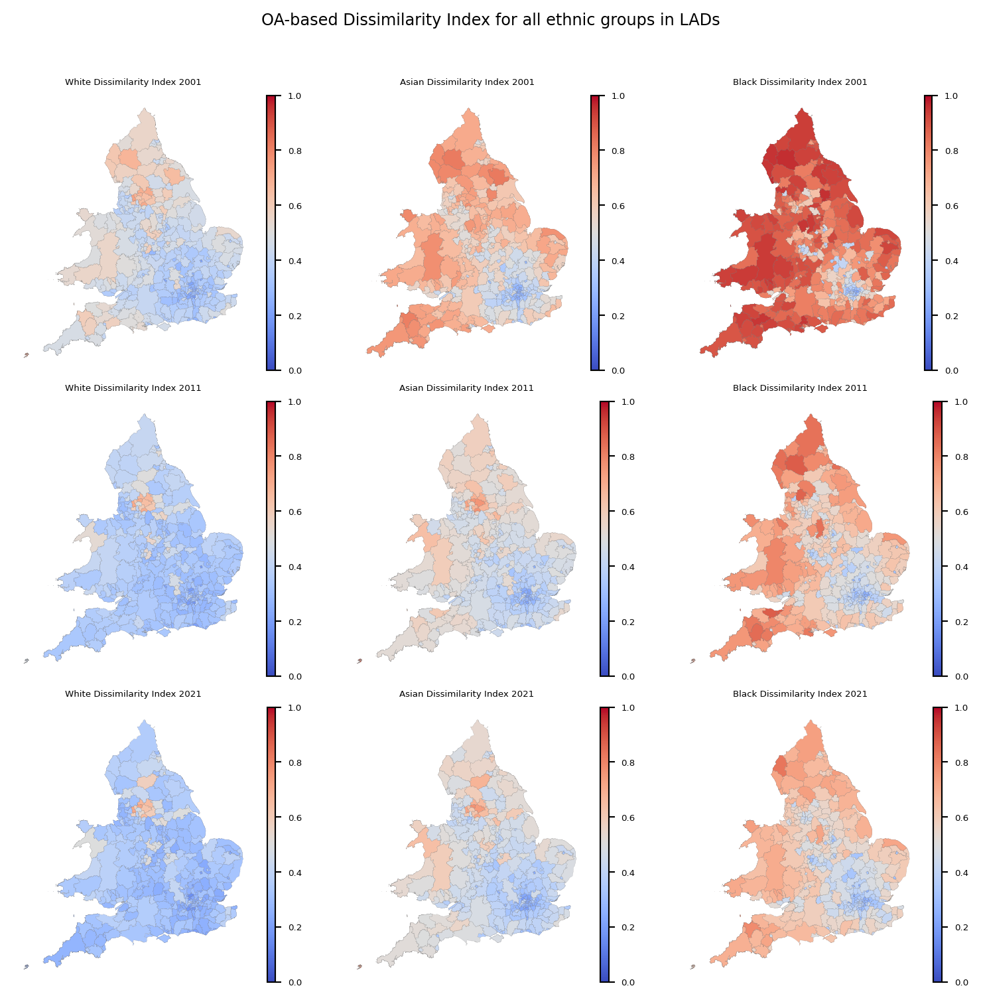

In [18]:
#| echo: false
#| label: fig-ladoadissmap
#| fig-cap: OA-based Dissimilarity Index for all ethnic groups in LADs

area = 'OA'
years = [2001, 2011, 2021]
map_data = pd.merge(LAD_dissimilarity_total, pd.concat([LAD_2001, LAD_2011, LAD_2021])[['LADCD', 'geometry']], on='LADCD')
map_data = gpd.GeoDataFrame(map_data, geometry='geometry')

# Reverse the colormap for the last column
fig, axes = plt.subplots(nrows=3, ncols=3, figsize=(8, 8))

# Flatten the axes array for easier iteration
axes = axes.flatten()

# Variables and titles for the plots
variables = [
    (f'{area}_white', 0, 1, 'White Dissimilarity Index', 'coolwarm'),
    (f'{area}_asian', 0, 1, 'Asian Dissimilarity Index', 'coolwarm'),
    (f'{area}_black', 0, 1, 'Black Dissimilarity Index', 'coolwarm'),
]

# Loop through years and variables to plot the maps
for j, year in enumerate(years):
    for i, (variable, min_val, max_val, title, cmap) in enumerate(variables):
        # Filter data for the given year
        data_year = map_data[map_data['year'] == year]

        # Determine the correct subplot index
        ax_index = j * 3 + i
        
        # Plot the variable
        ax = axes[ax_index]
        divider = make_axes_locatable(ax)
        cax = divider.append_axes("right", size="3.5%", pad=0.1)
        data_year.plot(column=variable, cmap=cmap, linewidth=0.05, ax=ax, edgecolor='0.5',
                       vmin=min_val, vmax=max_val, legend=False)
        
        # Manually create the colorbar
        norm = plt.Normalize(vmin=min_val, vmax=max_val)
        cbar = plt.colorbar(plt.cm.ScalarMappable(norm=norm, cmap=cmap), cax=cax)
        cbar.ax.tick_params(labelsize=5)

        ax.set_title(f'{title} {year}', fontsize=5)
        ax.axis('off')

fig.suptitle(f'{area}-based Dissimilarity Index for all ethnic groups in LADs', fontsize=9, y=0.97)

# Adjust layout
plt.subplots_adjust(hspace=0)
plt.tight_layout(rect=[0, 0, 1, 0.96])
plt.show()

# Simpson Index 
<p style="text-align: justify;" >
Simpson Index, which is a measure of ethnic concentration, can be calculated for each OA, LSOA, MSOA, LAD and for the whole country. It expresses the probability that two randomly selected individuals from the geographic area have the same ethnicity. 

This Average Local Simpson Index is calculated using the following formula: 

$$ 
S = {\sum_{i} (\frac{N_i} {N_{\text{Area}}} {\sum_{X} (P_i^X)^2})}
$$

Calculated for each $sub\_area_i$ as $S_i = {\sum_{X} (P_i^X)^2}$. The lower $S_i$, the more ethnically diverse is the $sub\_area_i$. The maximal value is achieved when the district is populated exclusively by one ethnic group. To calculate this index, only White British, Asians, and Blacks are considered, and “Other” ethnic groups is left outside. It has been done upon the consideration that individuals from this group are less likely to recognize each other as similar in terms of ethnic preferences. The Simpson Index is mathematically closely related to entropy, a measure of disorder which is also sometimes used in segregation studies to quantify the unequal distribution of ethnic groups between neighbourhoods or between the global and the local level.
[@Zuccotti2023]

In this analysis, Simpson Index is also calculated at both LAD and Country level.

At the country level, the country serves as the main area, with each of the OA, LSOA, MSOA, and LAD considered as sub-areas.

At the LAD level, each LAD is treated as the main area, with OA, LSOA, and MSOA considered as sub-areas within each LAD.

</p>


In [19]:
#| include: false
# defining simpson function

def simpson(df):
    simpson_series = []
    for i in range(df.shape[0]):
        area_ethnic_fraction_2 = []
        for col in df.columns:
            if col != 'other':
                area_ethnic_fraction_2.append((df.loc[i,col]/(df.iloc[i,:].sum()))**2)
        sum_area_ethnic_fraction_2 = sum(area_ethnic_fraction_2)
        simpson_series.append(sum_area_ethnic_fraction_2)
        
    simpson_series = pd.Series(simpson_series)
    simpson_index = 0
    for i in range(df.shape[0]):
        simpson_index += (simpson_series.iloc[i] * df.iloc[i, :].sum() / df.sum().sum())
    
    area_simpson = []
    for col in df.columns:
        if col != 'other':
            area_simpson.append((df[col].sum()/df.sum().sum())**2)
    area_simpson_index = sum(area_simpson)
    simpson_index = round(simpson_index, 3)
    area_simpson_index = round(area_simpson_index, 3)
    return [simpson_index, area_simpson_index]

## Simpson Index at Country Level
<p style="text-align: justify;" >
In @tbl-simpcount, the Simpson index at the country level for each year is presented.
As depicted in @fig-simpcount, the Simpson index is decreasing over time at all geographical levels. In addition, this index decreases as it moves to larger geographical areas.
</p>


In [20]:
#| echo: false
#| label: tbl-simpcount
#| tbl-cap: Simpson Index at Country Level

country_simpson_total = pd.concat([country_simpson_2001, country_simpson_2011, country_simpson_2021], ignore_index=True)
itables.show(country_simpson_total, 
            #  'Simpson Index at Country Level', 
             layout={'topEnd':None, 'bottomStart':None}, 
             maxBytes=1000,
            #  style='caption-side: top; font-family: Arial; font-size: 14px;',
             paging= False,
             classes= 'stripe hover order-column row-border nowrap',
            )

In [21]:
#| include: false
simpson_visualisation = country_simpson_total.melt(id_vars=['year'], value_vars= country_simpson_total.columns[-5:], 
                           var_name='level', value_name='simpson_index')
simpson_visualisation

,year,level,simpson_index
0,2001,OA,0.878
1,2011,OA,0.809
2,2021,OA,0.753
3,2001,LSOA,0.874
4,2011,LSOA,0.804
5,2021,LSOA,0.747
6,2001,MSOA,0.871
7,2011,MSOA,0.800
8,2021,MSOA,0.743
9,2001,LAD,0.857


In [22]:
#| echo: false
#| label: fig-simpcount
#| fig-cap: Simpson Index Line Chart at Country Level

traces = []
for level in simpson_visualisation['level'].unique():
    trace = go.Scatter(
        x= simpson_visualisation[simpson_visualisation['level'] == level]['year'],
        y= simpson_visualisation[simpson_visualisation['level'] == level]['simpson_index'],
        mode='lines+markers',
        name=level
    )
    traces.append(trace)

layout = go.Layout(title_text="Simpson Index Line Chart at Country Level",
                    title_x=0.5,
                    title_font=dict(size=16),
                    xaxis=dict(title='Year', tickvals=simpson_visualisation['year'].unique()),
                    yaxis=dict(title='Simpson Index'),
                    legend=dict(orientation="h",
                                yanchor="top",
                                y=1.2,
                                xanchor="center",
                                x=0.5),
                    hovermode='closest',
                    showlegend=True,
                    height = 400,
                    width = 600
)


fig = go.Figure(data=traces, layout=layout)

# fig.show()
pyo.iplot(fig)

## Simpson Index at LAD Level
<p style="text-align: justify;" >
In this part of the study, the Simpson index is calculated at LAD level. Therefore, OAs, LSOAs, and MSOAs were considered as the subareas of interest. The results are presented in @tbl-simplad. 
By sorting the table based on the lowest Simpson index, it is noticeable that the LADs included as part of London (LAD codes between E09000001 and E09000033) have the lowest Simpson index in England. This suggests that these areas can be considered less segregated.
</p>


In [23]:
#| include: false
# computing the difference columns
LAD_simpson_total = pd.concat([LAD_simpson_2001, LAD_simpson_2011, LAD_simpson_2021], ignore_index=True)
LAD_simpson_total['OA_LAD_diff']= LAD_simpson_total['OA']- LAD_simpson_total['LAD']
LAD_simpson_total['LSOA_LAD_diff']= LAD_simpson_total['LSOA']- LAD_simpson_total['LAD']
LAD_simpson_total['MSOA_LAD_diff']= LAD_simpson_total['MSOA']- LAD_simpson_total['LAD']

In [24]:
#| echo: false
#| label: tbl-simplad
#| tbl-cap: Simpson Index at LAD Level
itables.show(LAD_simpson_total,
             'Simpson Index at LAD Level',
             layout={'topEnd':None , 'topStart':'pageLength' , 'bottomStart': 'paging' , 'bottomEnd': 'info' }, 
             maxBytes=200000,
             style="caption-side:top ; table-layout:auto;",
             column_filters='footer',
             footer= False,
             paging= True,
             classes= 'stripe hover order-column row-border compact nowrap',
             fixedColumns={"start": 2, "end": None},
             scrollCollapse= True,
             scrollX = True,
             scrollY = '300px',
             lengthMenu=[10,25,50,100]
             )

In [25]:
#| include: false
pd.concat([LAD_simpson_total[LAD_simpson_total['year']==2001].sort_values('LAD',ascending= False).head(5),
LAD_simpson_total[LAD_simpson_total['year']==2011].sort_values('LAD',ascending= False).head(5),
LAD_simpson_total[LAD_simpson_total['year']==2021].sort_values('LAD',ascending= False).head(5)]).reset_index(drop= True)

,year,LADNM,LADCD,LAD_population,white_frac,asian_frac,black_frac,other_frac,OA,LSOA,MSOA,LAD,OA_LAD_diff,LSOA_LAD_diff,MSOA_LAD_diff
0,2001,Isles of Scilly,E06000053,2151,0.996,0.000,0.000,0.004,0.992,0.992,0.992,0.992,0.000,0.0,0.0
1,2001,Eden,E07000030,49786,0.995,0.002,0.000,0.002,0.991,0.991,0.991,0.991,0.000,0.0,0.0
2,2001,Allerdale,E07000026,93455,0.994,0.003,0.000,0.002,0.989,0.988,0.988,0.988,0.001,0.0,0.0
3,2001,Selby,E07000169,76450,0.994,0.003,0.000,0.003,0.987,0.987,0.987,0.987,0.000,0.0,0.0
4,2001,Ryedale,E07000167,50898,0.994,0.003,0.001,0.003,0.987,0.987,0.987,0.987,0.000,0.0,0.0
5,2011,Eden,E07000030,52564,0.989,0.006,0.000,0.005,0.979,0.979,0.979,0.979,0.000,0.0,0.0
6,2011,Allerdale,E07000026,96422,0.989,0.005,0.001,0.005,0.979,0.979,0.979,0.979,0.000,0.0,0.0
7,2011,Isles of Scilly,E06000053,2203,0.988,0.001,0.001,0.010,0.977,0.977,0.977,0.977,0.000,0.0,0.0
8,2011,Torridge,E07000046,63839,0.987,0.004,0.001,0.008,0.975,0.975,0.975,0.975,0.000,0.0,0.0
9,2011,Ryedale,E07000167,51751,0.987,0.005,0.002,0.006,0.974,0.974,0.974,0.974,0.000,0.0,0.0


In [26]:
#| include: false
pd.concat([LAD_simpson_total[LAD_simpson_total['year']==2001].sort_values('OA_LAD_diff',ascending= False).head(5),
LAD_simpson_total[LAD_simpson_total['year']==2011].sort_values('OA_LAD_diff',ascending= False).head(5),
LAD_simpson_total[LAD_simpson_total['year']==2021].sort_values('OA_LAD_diff',ascending= False).head(5)])

,year,LADNM,LADCD,LAD_population,white_frac,asian_frac,black_frac,other_frac,OA,LSOA,MSOA,LAD,OA_LAD_diff,LSOA_LAD_diff,MSOA_LAD_diff
76,2001,Blackburn with Darwen,E06000008,137446,0.779,0.209,0.002,0.009,0.832,0.815,0.779,0.651,0.181,0.164,0.128
84,2001,Leicester,E06000016,279832,0.639,0.307,0.031,0.023,0.682,0.667,0.645,0.503,0.179,0.164,0.142
64,2001,Bradford,E08000032,467633,0.783,0.193,0.009,0.015,0.817,0.800,0.775,0.650,0.167,0.150,0.125
57,2001,Birmingham,E08000025,977057,0.704,0.207,0.061,0.029,0.698,0.689,0.676,0.541,0.157,0.148,0.135
36,2001,Oldham,E08000004,217266,0.862,0.122,0.006,0.011,0.873,0.859,0.845,0.757,0.116,0.102,0.088
424,2011,Blackburn with Darwen,E06000008,147489,0.692,0.281,0.006,0.021,0.783,0.765,0.728,0.558,0.225,0.207,0.170
412,2011,Bradford,E08000032,522452,0.674,0.268,0.018,0.040,0.733,0.717,0.691,0.527,0.206,0.190,0.164
432,2011,Leicester,E06000016,329839,0.505,0.371,0.062,0.061,0.582,0.567,0.548,0.397,0.185,0.170,0.151
384,2011,Oldham,E08000004,224897,0.775,0.192,0.012,0.020,0.823,0.808,0.791,0.638,0.185,0.170,0.153
405,2011,Birmingham,E08000025,1073045,0.579,0.266,0.090,0.065,0.577,0.566,0.553,0.415,0.162,0.151,0.138


<p style="text-align: justify;" >
In @fig-simpbox, the boxplot of the Simpson index is displayed. As shown, moving from 2001 to 2021, the Simpson indices for each geographical area are decreasing. Additionally, it is noticeable that the LAD-based Simpson index has slight differences compared to other subareas. 
</p>

In [27]:
#| echo: false
#| label: fig-simpbox
#| fig-cap: Simpson Index Box-Plot based on different areas across the years
# Simpson Index Box-Plot based on different areas across the years
fig = make_subplots(rows=1, cols=4, subplot_titles=("OA", "LSOA", "MSOA", "LAD"))
for annotation in fig['layout']['annotations']:
    annotation['font'] = dict(size=12)

years= ["2001", "2011", "2021"]
box_colors = ['#636EFA','#EF553B','#00CC96','#AB63FA']
areas= ["OA", "LSOA", "MSOA", "LAD"]

for i, area  in enumerate(areas, start=1):
    for j, year in enumerate(years):
        show_legend = False if i != 1 else True 
        df = LAD_simpson_total[LAD_simpson_total['year'] == int(year)]
        hover_text = df['LADNM'] 
        fig.add_trace(go.Box(y=df[area], 
                                name=f'{year}', 
                                # boxpoints='all',
                                hovertext=hover_text, 
                                showlegend=show_legend, marker=dict(color=box_colors[j])), row=1, col=i)


fig.update_layout(title_text='Simpson Index Box-Plot based on different areas across the years',
                    title_x=0.5,
                    # title_y=0.95,
                    title_font=dict(size=16),
                    height=400,
                    width=800,
                    yaxis=dict(title='Simpson Index'),
                    legend=dict(orientation="h",
                                yanchor="top",
                                y=1.2,
                                xanchor="center",
                                x=0.5)
)
for i in range(1, 5):
    fig.update_yaxes(range=[0.24, 1.01], row=1, col=i)

# fig.show()
pyo.iplot(fig)

<p style="text-align: justify;" >
In @fig-simpdiffbox, the box plot of these differences is displayed. The differences between the LAD-based Simpson index of LADs and other subareas (OA, MSOA and LSOA) highlight variations in segregation patterns across different geographic scales. Comparing these indices provides insights into how segregation patterns differ within larger administrative areas (LAD) versus smaller geographic units (OA or LSOA). As observed, the difference between LADs and other geographical areas is mostly less than 0.04, decreasing as the geographic area expands and increasing in recent years. However, notable outliers in 2001 include Birmingham, Leicester, Bradford, and Blackburn with Darwen, where the difference is relatively high. Oldham is added to this list in 2011, and Pendle joins in 2021.
<p style="text-align: justify;" >
This indicates that the disparities between the LAD and other subareas are most pronounced in these cities. Consequently, these cities have been selected for deeper analysis in the subsequent steps of the project. Additionally, London, being the capital and inherently interesting, is included in the study. Therefore, the 33 LADs corresponding to London have been selected for further examination.
</p>

In [28]:
#| echo: false
#| label: fig-simpdiffbox
#| fig-cap: Simpson Index Differences between LAD and other areas across the years
# Simpson Index Differences between LAD and other areas across the years

fig = make_subplots(rows=1, cols=3, subplot_titles=("LAD_OA", "LAD_LSOA", "LAD_MSOA"))
for annotation in fig['layout']['annotations']:
    annotation['font'] = dict(size=12)
    
years= ["2001", "2011", "2021"]
box_colors = ['#636EFA','#EF553B','#00CC96','#AB63FA']
areas= ["OA_LAD_diff", "LSOA_LAD_diff", "MSOA_LAD_diff"]

for i, area  in enumerate(areas, start=1):
    for j, year in enumerate(years):
        show_legend = False if i != 1 else True 
        df = LAD_simpson_total[LAD_simpson_total['year'] == int(year)]
        hover_text = df['LADNM']   
        fig.add_trace(go.Box(y=df[area], 
                                name=f'{year}', 
                                # boxpoints='all',
                                hovertext=hover_text, 
                                showlegend=show_legend, marker=dict(color=box_colors[j])), row=1, col=i)
    
fig.update_layout(title_text='Simpson Index Differences between LAD and other areas across the years',
                    title_x=0.5,
                    title_font=dict(size=16),
                    height=400,
                    width=800,
                    yaxis=dict(title='Simpson Index Difference'),
                    legend=dict(orientation="h",
                                yanchor="top",
                                y=1.2,
                                xanchor="center",
                                x=0.5)
)
for i in range(1, 4):
    fig.update_yaxes(range=[-0.01, 0.28], row=1, col=i)

# fig.show()
pyo.iplot(fig)

<p style="text-align: justify;" >
To better understand these numbers, a map visualization is used. As observed in @fig-simpinxmap, from 2001 to 2021, the Simpson index has declined. In the border areas of England, the Simpson index is relatively high compared to the central areas. Conversely, some central parts adjacent to Bradford, Birmingham, and London demonstrate a lower Simpson index. @fig-simpdiffmap depicts the difference between the LAD-based Simpson index and the OA-based Simpson index for each LAD. By comparing these two figures, it is evident that in these areas, the 
</p>

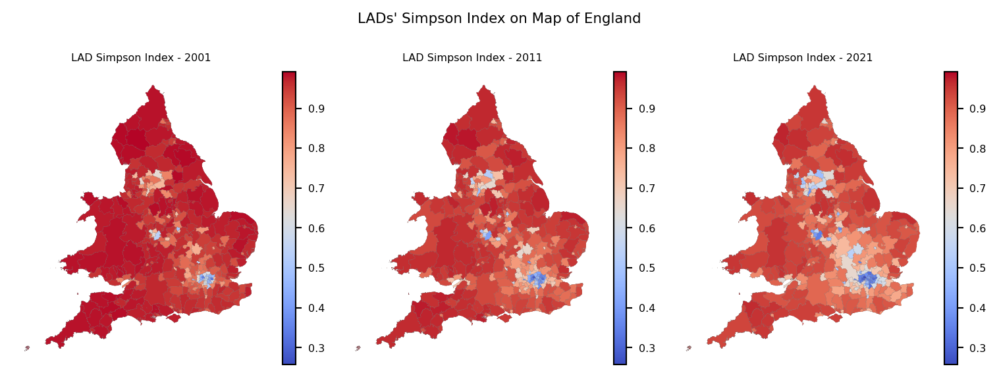

In [29]:
#| echo: false
#| label: fig-simpinxmap
#| fig-cap: LADs' Simpson Index on Map of England
# LADs' Simpson Index on Map of England

years = [2001, 2011, 2021]

LAD_simpson_min, LAD_simpson_max = LAD_simpson_total['LAD'].min(), LAD_simpson_total['LAD'].max()

# Merge the Simpson index data with geometries from different years
map_data = pd.merge(LAD_simpson_total, pd.concat([LAD_2001, LAD_2011, LAD_2021])[['LADCD', 'geometry']], on='LADCD')
map_data = gpd.GeoDataFrame(map_data, geometry='geometry')

fig, axes = plt.subplots(nrows=1, ncols=3, figsize=(8, 3))

# Loop through years and columns to plot the maps
for ax, year in zip(axes, years):
    # Filter data for the given year
    data_year = map_data[map_data['year'] == year]

    divider = make_axes_locatable(ax)
    cax = divider.append_axes("right", size="5%", pad=0.1)
    data_year.plot(column='LAD', cmap='coolwarm', linewidth=0.05, ax=ax, edgecolor='0.5',
                   vmin=LAD_simpson_min, vmax=LAD_simpson_max, legend=False)
    
    # Manually create the colorbar
    norm = plt.Normalize(vmin=LAD_simpson_min, vmax=LAD_simpson_max)
    cbar = plt.colorbar(plt.cm.ScalarMappable(norm=norm, cmap=cmap), cax=cax)
    cbar.ax.tick_params(labelsize=6)

    ax.set_title(f'LAD Simpson Index - {year}', fontsize=6)
    ax.axis('off')

fig.suptitle("LADs' Simpson Index on Map of England", fontsize=8, y=1)

# Adjust layout
plt.tight_layout()
plt.show()

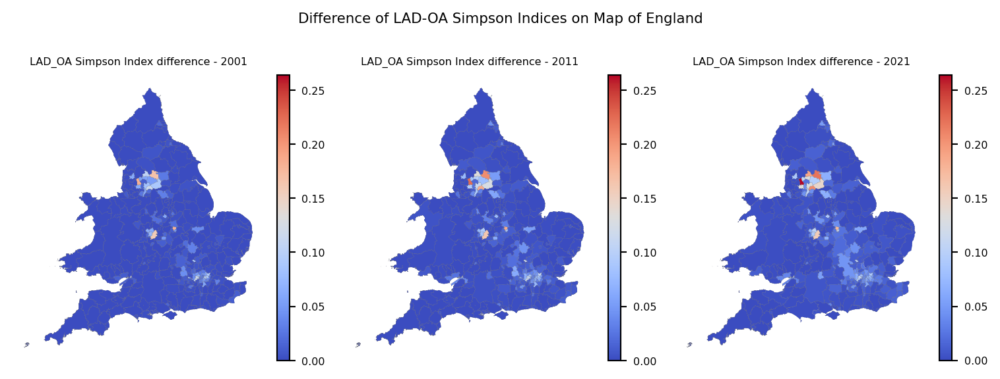

In [30]:
#| echo: false
#| label: fig-simpdiffmap
#| fig-cap: Difference of LAD-OA Simpson Indices on Map of England
# Difference of LAD-OA Simpson Indices on Map of England

years = [2001, 2011, 2021]

# Assuming LAD_simpson_total contains the Simpson index data
LAD_simpson_min, LAD_simpson_max = LAD_simpson_total['OA_LAD_diff'].min(), LAD_simpson_total['OA_LAD_diff'].max()

# Merge the Simpson index data with geometries from different years
map_data = pd.merge(LAD_simpson_total, pd.concat([LAD_2001, LAD_2011, LAD_2021])[['LADCD', 'geometry']], on='LADCD')
map_data = gpd.GeoDataFrame(map_data, geometry='geometry')

fig, axes = plt.subplots(nrows=1, ncols=3, figsize=(8, 3))

# Loop through years and columns to plot the maps
for ax, year in zip(axes, years):
    # Filter data for the given year
    data_year = map_data[map_data['year'] == year]

    divider = make_axes_locatable(ax)
    cax = divider.append_axes("right", size="5%", pad=0.1)
    data_year.plot(column='OA_LAD_diff', cmap='coolwarm', linewidth=0.05, ax=ax, edgecolor='0.5',
                   vmin=LAD_simpson_min, vmax=LAD_simpson_max, legend=False, cax=cax)
   
    # Manually create the colorbar
    norm = plt.Normalize(vmin=LAD_simpson_min, vmax=LAD_simpson_max)
    cbar = plt.colorbar(plt.cm.ScalarMappable(norm=norm, cmap=cmap), cax=cax)
    cbar.ax.tick_params(labelsize=6)

    ax.set_title(f'LAD_OA Simpson Index difference - {year}', fontsize=6)
    ax.axis('off')

fig.suptitle('Difference of LAD-OA Simpson Indices on Map of England', fontsize=8, y=1)

# Adjust layout
plt.tight_layout()
plt.show()

# Moran's I Index 
<p style="text-align: justify;" >
Moran's I is a statistical measure used to assess spatial autocorrelation. Spatial Autocorrelation means looking at how similar or dissimilar values of a variable are in neighbouring locations. Spatial autocorrelation measures this similarity or dissimilarity in geographic space. It quantifies the degree of similarity between values of a variable at different locations in a spatial dataset. Moran's I determines whether the observed pattern of spatial autocorrelation indicates clustering (similar values close together), dispersion (dissimilar values close together), or randomness (no discernible pattern). This information is valuable for understanding the underlying spatial processes and making informed decisions in various fields such as urban planning, epidemiology, and environmental science.

This Moran's I Index is calculated using the following formula: 

$$ 
Moran's I^X = \frac{L}{W} \frac{\sum_{i} \sum_{j} w_{ij} (P_i^X - \overline{P}^X)(P_j^X - \overline{P}^X)}{\sum_{i} (P_i^X - \overline{P}^X)^2}
$$

Where $P_i^X$ is fraction of individuals for ethnic group $X$ in $district_i$ and $\overline{P}^X$ is the average of fraction of the ethnic group $X$ in all $districts$. The weights $w_{ij}$ are one when $districts$ $i$ and $j$ share a border and zero otherwise. Finally, $L$ is the number of $district$ and $W$ the number of positive $w_{ij}$. 

<p style="text-align: justify;" >
Similar to the Dissimilarity index, Moran's I is computed independently for each ethnic group at both the national and Local Authority District (LAD) levels. To compute this index, spatial data is required to delineate the shared boundaries between each subordinate unit.

At the national level, the entire country is regarded as the primary unit, while LADs are treated as subordinate units.

Conversely, at the LAD level, each LAD serves as the principal unit, with OAs, LSOAs, and MSOAs considered as subordinate units within each LAD.

</p>


In [31]:
#| include: false
# defining moran's I function

def moran(df,border):
    positive_weights = []
    for key in border.keys():
        positive_weights.append(len(border[key]))
       
    fraction = {}
    for col in df.columns:
        # df[col] = pd.to_numeric(df[col], errors='coerce')
        fraction[col] = []
        for i in df.index:
            fraction[col].append(df.loc[i, col] / df.loc[i, :].sum())
    
    col_moran = {} 
    for col in df.columns:
        col_moran_list = []
        for i in df.index:
            morani = []
            for common in border[i]:    
                morani.append(((df.loc[i, col] / df.loc[i, :].sum()) - np.mean(fraction[col])) * ((df.loc[common, col] / df.loc[common, :].sum()) - np.mean(fraction[col])))
            row_moran = sum(morani)
            col_moran_list.append(row_moran)
        col_moran[col] = col_moran_list
    moran_results= {}
    for col in df.columns:
        moran_numerator = sum(col_moran[col])*df.shape[0]
        moran_denominator = sum((fraction[col] - np.mean(fraction[col]))**2)*sum(positive_weights)
        # moran_index = moran_numerator/moran_denominator
        moran_results[col] = round(moran_numerator/moran_denominator, 3)
    return moran_results

## Moran's I at country level
<p style="text-align: justify;" >
To compute the Moran's I index, the shared border between each subarea must be determined. computing the shared borders of 175,000 to 180,000 OA areas is computationally intensive, so at the country level, LADs are considered as subareas, and other geographical areas were ignored. @tbl-morcountry shows the Moran's I index for each ethnic group across three years. It reflects trends in how these populations are spatially organized within the studied area.
<p style="text-align: justify;" >
The index for the white population shows a slight decrease from 0.630 in 2001 to 0.617 in 2021. This indicates that the spatial clustering of the white population has slightly decreased over time, suggesting a slight move towards a more random distribution.
<p style="text-align: justify;" >
The index for the asian population decreases from 0.502 in 2001 to 0.478 in 2021. This suggests a slight decrease in spatial clustering, indicating that the asian population has become slightly more evenly distributed over the years.
<p style="text-align: justify;" >
The Moran's I index for the black population decreases from 0.616 in 2001 to 0.580 in 2021. This indicates a reduction in spatial clustering, suggesting that the black population has become more evenly spread out over time.
<p style="text-align: justify;" >
The Moran's I index for the "other" category increases from 0.669 in 2001 to 0.750 in 2021. This indicates an increase in spatial clustering, suggesting that the "other" population has become more clustered together over the years.
</p>

In [32]:
#| include: false
# Calculating Moran's I Iindex for country level, considering LAD as sub area
Moran_2001 = moran(ethnicity_2001.groupby(['LAD01CD'])[['white' , 'asian' , 'black','other']].sum()[['white' , 'asian' , 'black','other']],LAD_borders_2001)

Moran_2011 = moran(ethnicity_2011.groupby(['LAD11CD'])[['white' , 'asian' , 'black','other']].sum()[['white' , 'asian' , 'black','other']],LAD_borders_2011)

Moran_2021 = moran(ethnicity_2021.groupby(['LAD21CD'])[['white' , 'asian' , 'black','other']].sum()[['white' , 'asian' , 'black','other']],LAD_borders_2021)
# for key in Moran_2021.keys():
#     print(f'The Moran's I index at LAD level in 2001 for "{key}" ethnic is {Moran_2021[key]}')

In [33]:
#| include: false
# Country Level Moran's I IIndex in 3 years
Moran_2001['year'] = 2001
Moran_2011['year'] = 2011
Moran_2021['year'] = 2021
country_moran_total = pd.DataFrame([Moran_2001, Moran_2011, Moran_2021])
column_order= ["year", "white", "asian", "black", "other"]
country_moran_total = country_moran_total[column_order]

country_moran_total = country_moran_total.rename(columns={col: f'{col}_moran' for col in ["white", "asian", "black", "other"]})
country_moran_total

,year,white_moran,asian_moran,black_moran,other_moran
0,2001,0.630,0.502,0.616,0.669
1,2011,0.621,0.483,0.602,0.703
2,2021,0.617,0.478,0.580,0.750


In [34]:
#| echo: false
#| label: tbl-morcountry
#| tbl-cap: Moran's I Is Iindex for all ethnic groups at country level
# Moran's I Iindex for all ethnic groups at country level
itables.show(country_moran_total, 
             layout={'topEnd':None, 'bottomStart':None}, 
             maxBytes=1000,
            #  style='font-family: Arial; font-size: 14px;',
)

<p style="text-align: justify;" >
As it is shown in @fig-morcount, for the white, asian, and black populations, the Moran's I index values are all positive and show a slight decreasing trend, indicating that while there is still a moderate degree of clustering, the populations are becoming slightly more dispersed over time.
<p style="text-align: justify;" >
For the "other" category, the Moran's I index values are positive and show an increasing trend, indicating that the spatial clustering of this population is becoming stronger over time.
</p>

In [35]:
#| echo: false
#| label: fig-morcount
#| fig-cap: Moran's I Is IIndex Variation Across the Year
# Moran's I Variation Across the Years

colors = ['darkgray', 'orange', 'black', 'green']
ethnicity = ['white_moran', 'asian_moran', 'black_moran', 'other_moran']
fig = make_subplots(rows=1, cols=2, shared_xaxes=True, subplot_titles=("Bar Chart", "Line Chart"))

bar_traces = []
for i, ethnic in enumerate(ethnicity):
    trace = go.Bar(
        x=country_moran_total['year'],
        y=country_moran_total[ethnic],
        name=ethnic,
        marker=dict(color=colors[i])
    )
    bar_traces.append(trace)

line_traces = []
for i, ethnic in enumerate(ethnicity):
    trace = go.Scatter(
        x=country_moran_total['year'],
        y=country_moran_total[ethnic],
        name=ethnic,
        mode='lines+markers',
        line=dict(color=colors[i], width=2)
    )
    line_traces.append(trace)

for trace in bar_traces:
    fig.add_trace(trace, row=1, col=1)

for trace in line_traces:
    fig.add_trace(trace, row=1, col=2)

fig.update_layout(title_text= "Moran's I Index Variation Across the Year",
                    title_font=dict(size=16),
                    title_x=0.5,
                    title_y=0.97,
                    yaxis=dict(title="moran's I Index"),
                    width=750,
                    height=400,
                    legend=dict(orientation="h",
                        yanchor="top",
                        y=1.31,
                        xanchor="center",
                        x=0.5,
                        traceorder='normal')
)
for i in range (1,3):
    fig.update_xaxes(tickvals=country_moran_total['year'], row=1, col=i)


pyo.iplot(fig)

## Moran's I at LAD level
<p style="text-align: justify;" >

</p>

<p style="text-align: justify;" >
In this part of the study, Moran’s I index is calculated for each LAD. For LADs, Moran’s I index is computable for OA, LSOA and MSOA levels. 
The results are presented in @tbl-morcount. The NaN value for each subarea's Moran’s I indicates subareas with a population count of zero for a specific ethnicity.
</p>

In [36]:
#| echo: false
#| label: tbl-morcount
#| tbl-cap: Moran's I Index Variation Across the Year
# Moran's I Variation Across the Years
LAD_moran_total = pd.concat([LAD_moran_2001, LAD_moran_2011, LAD_moran_2021], ignore_index= True)
LAD_moran_total= LAD_moran_total.rename(columns={col:f'{col}_mor' for col in ['OA_white', 'LSOA_white', 'MSOA_white',
       'OA_asian', 'LSOA_asian', 'MSOA_asian', 'OA_black', 'LSOA_black',
       'MSOA_black', 'OA_other', 'LSOA_other', 'MSOA_other']})

itables.show(LAD_moran_total,
             "Moran's I Index at LAD level", 
             layout={'topEnd':None , 'topStart':'pageLength' , 'bottomStart': 'paging' , 'bottomEnd': 'info' }, 
             maxBytes=200000,
             style="caption-side:top ; table-layout:auto;",
             column_filters='footer',
             footer= False,
             paging= True,
             classes= 'stripe hover order-column row-border compact nowrap',
             fixedColumns={"start": 2, "end": None},
             scrollCollapse= True,
             scrollX = True,
             scrollY = '300px',
             lengthMenu=[10,25,50,100]
             )

In [37]:
#| include: false
pd.concat([LAD_moran_total[LAD_moran_total['year']==2001].sort_values('LSOA_white_mor',ascending= False).head(5),
LAD_moran_total[LAD_moran_total['year']==2011].sort_values('LSOA_white_mor',ascending= False).head(5),
LAD_moran_total[LAD_moran_total['year']==2021].sort_values('LSOA_white_mor',ascending= False).head(5)]).reset_index(drop= True)

,year,LADNM,LADCD,LAD_population,white_frac,asian_frac,black_frac,other_frac,OA_white_mor,LSOA_white_mor,MSOA_white_mor,OA_asian_mor,LSOA_asian_mor,MSOA_asian_mor,OA_black_mor,LSOA_black_mor,MSOA_black_mor,OA_other_mor,LSOA_other_mor,MSOA_other_mor
0,2001,Birmingham,E08000025,977057,0.704,0.207,0.061,0.029,0.926,0.920,0.793,0.892,0.878,0.710,0.761,0.835,0.774,0.363,0.557,0.545
1,2001,Croydon,E09000008,330688,0.701,0.128,0.133,0.037,0.869,0.919,0.853,0.740,0.801,0.640,0.832,0.907,0.894,0.253,0.488,0.677
2,2001,Redbridge,E09000026,238511,0.636,0.265,0.076,0.024,0.881,0.850,0.648,0.850,0.819,0.633,0.577,0.641,0.551,0.104,0.144,0.307
3,2001,Enfield,E09000010,273616,0.771,0.094,0.105,0.030,0.785,0.849,0.676,0.578,0.717,0.522,0.780,0.857,0.696,0.222,0.461,0.490
4,2001,Ealing,E09000009,300886,0.587,0.289,0.088,0.036,0.835,0.846,0.636,0.860,0.876,0.627,0.478,0.364,0.135,0.204,0.347,0.216
5,2011,Birmingham,E08000025,1073045,0.579,0.266,0.090,0.065,0.921,0.919,0.820,0.881,0.874,0.727,0.718,0.750,0.670,0.522,0.676,0.613
6,2011,Croydon,E09000008,363378,0.551,0.164,0.202,0.083,0.870,0.902,0.828,0.737,0.753,0.539,0.816,0.882,0.852,0.431,0.640,0.708
7,2011,Derby,E06000015,248752,0.803,0.125,0.029,0.043,0.884,0.866,0.611,0.851,0.819,0.562,0.543,0.787,0.666,0.520,0.738,0.594
8,2011,Enfield,E09000010,312466,0.610,0.112,0.172,0.106,0.831,0.861,0.718,0.480,0.677,0.479,0.835,0.870,0.739,0.407,0.592,0.585
9,2011,Hounslow,E09000018,253957,0.514,0.344,0.066,0.076,0.852,0.844,0.793,0.860,0.863,0.819,0.285,0.175,-0.002,0.159,0.211,0.334


<p style="text-align: justify;" >
In @fig-mornbox, the boxplot of LSOA-based Moran's I index is displayed. LSOA is selected as it provides a good balance between detailed and aggregated data. As shown, moving from 2001 to 2021 for each ethnic group, the Moran's I index is increasing, indicating that the spatial autocorrelation within each Local Authority District (LAD) is strengthening. For all ethnic groups, fewer than 25% of LADs exhibit a negative Moran's I index, suggesting that the majority of LADs have positive spatial autocorrelation. This occurs when similar values (e.g., high or low percentages of a particular ethnic group) are clustered together in a geographic space. In other words, areas with high fraction of each ethnic group are surrounded by other areas with high fractions, and areas with low fractions are surrounded by other areas with low fractions. A positive Moran's I index indicates this pattern of clustering.
</p>

In [38]:
#| echo: false
#| label: fig-mornbox
#| fig-cap: LSOA-based Moran's I in LADs for Ethnicities across the years
# LSOA-based Moran's I in LADs for Ethnicities across the years
fig = make_subplots(rows=1, cols=4, subplot_titles=("White", "Asian", "Black", "Other"))
for annotation in fig['layout']['annotations']:
    annotation['font'] = dict(size=12)

years= ["2001", "2011", "2021"]
box_colors = ['#636EFA','#EF553B','#00CC96','#AB63FA']
ethnicities= ["LSOA_white_mor", "LSOA_asian_mor", "LSOA_black_mor", "LSOA_other_mor"]

for i, ethnicity  in enumerate(ethnicities, start=1):
    for j, year in enumerate(years):
        show_legend = False if i != 1 else True 
        df = LAD_moran_total[LAD_moran_total['year'] == int(year)]
        hover_text = df['LADNM'] 
        fig.add_trace(go.Box(y=df[ethnicity], 
                                name=f'{year}', 
                                # boxpoints='all',
                                hovertext=hover_text, 
                                showlegend=show_legend, marker=dict(color=box_colors[j])), row=1, col=i)


fig.update_layout(title_text= "LSOA-based Moran's I in LADs for Ethnicities across the years",
                    title_x=0.5,
                    # title_y=0.95,
                    title_font=dict(size=16),
                    height=400,
                    width=800,
                    yaxis=dict(title="Moran's I Index"),
                    legend=dict(orientation="h",
                                yanchor="top",
                                y=1.2,
                                xanchor="center",
                                x=0.5)
)
for i in range(1, 5):
    fig.update_yaxes(range=[-0.3, 1.01], row=1, col=i)

# fig.show()
pyo.iplot(fig)

In [39]:
#| include: false
# creating a complete df for country level
country_total= country_simpson_total.merge(country_moran_total, on = 'year', how = 'left')

country_total.rename(columns={'OA':'OA_simpson' , 'LSOA': 'LSOA_simpson','MSOA': 'MSOA_simpson', 'LAD': 'LAD_simpson', 'country': 'country_simpson',
                                        'white':'white_moran' , 'asian':'asian_moran' ,'black':'black_moran' , 'other':'other_moran'},
                                        inplace = True)
country_total= country_total.merge(country_dissimilarity_total[['year', 'OA_white', 'LSOA_white','MSOA_white', 'LAD_white',
                                                                 'OA_asian', 'LSOA_asian', 'MSOA_asian', 'LAD_asian',
                                                                 'OA_black', 'LSOA_black', 'MSOA_black', 'LAD_black',
                                                                 'OA_other', 'LSOA_other', 'MSOA_other', 'LAD_other']], on= 'year', how= 'left')
country_total.rename(columns={'OA_white':'OA_white_diss', 'LSOA_white':'LSOA_white_diss', 'MSOA_white':'MSOA_white_diss', 'LAD_white':'LAD_white_diss',
                              'OA_asian':'OA_asian_diss', 'LSOA_asian':'LSOA_asian_diss', 'MSOA_asian':'MSOA_asian_diss', 'LAD_asian':'LAD_asian_diss',
                              'OA_black':'OA_black_diss', 'LSOA_black':'LSOA_black_diss', 'MSOA_black':'MSOA_black_diss', 'LAD_black':'LAD_black_diss',
                              'OA_other':'OA_other_diss', 'LSOA_other':'LSOA_other_diss', 'MSOA_other':'MSOA_other_diss', 'LAD_other':'LAD_other_diss'}, inplace = True)
country_total.head()

,year,total_population,white_frac,asian_frac,black_frac,other_frac,OA_simpson,LSOA_simpson,MSOA_simpson,LAD_simpson,...,MSOA_asian_diss,LAD_asian_diss,OA_black_diss,LSOA_black_diss,MSOA_black_diss,LAD_black_diss,OA_other_diss,LSOA_other_diss,MSOA_other_diss,LAD_other_diss
0,2001,52041655,0.913,0.052,0.022,0.013,0.878,0.874,0.871,0.857,...,0.595,0.509,0.715,0.689,0.678,0.641,0.474,0.378,0.351,0.318
1,2011,56075912,0.860,0.075,0.033,0.032,0.809,0.804,0.800,0.781,...,0.563,0.478,0.653,0.627,0.613,0.568,0.430,0.397,0.384,0.348
2,2021,59598449,0.817,0.093,0.040,0.050,0.753,0.747,0.743,0.721,...,0.537,0.459,0.604,0.573,0.554,0.503,0.391,0.362,0.349,0.313


In [40]:
#| include: false
LAD_visualisation_2001= LAD_2001.merge(LAD_simpson_total[LAD_simpson_total.year==2001][['LADCD','OA','LSOA','MSOA','LAD','OA_LAD_diff',
                              'LSOA_LAD_diff', 'MSOA_LAD_diff']], on = 'LADCD', how = 'left')

LAD_visualisation_2001.rename(columns={'OA':'OA_simpson' , 'LSOA': 'LSOA_simpson','MSOA': 'MSOA_simpson', 'LAD': 'LAD_simpson'},
                                        inplace = True)
LAD_visualisation_2001= LAD_visualisation_2001.merge(LAD_dissimilarity_total[LAD_dissimilarity_total.year==2001][['LADCD', 'OA_white', 'LSOA_white','MSOA_white', 
                                                                 'OA_asian', 'LSOA_asian', 'MSOA_asian',
                                                                 'OA_black', 'LSOA_black', 'MSOA_black', 
                                                                 'OA_other', 'LSOA_other', 'MSOA_other']], on= 'LADCD', how= 'left')
LAD_visualisation_2001.rename(columns={'OA_white':'OA_white_diss' , 'LSOA_white': 'LSOA_white_diss','MSOA_white': 'MSOA_white_diss', 
                              'OA_asian':'OA_asian_diss', 'LSOA_asian':'LSOA_asian_diss', 'MSOA_asian': 'MSOA_asian_diss',
                              'OA_black':'OA_black_diss', 'LSOA_black':'LSOA_black_diss', 'MSOA_black': 'MSOA_black_diss', 
                              'OA_other':'OA_other_diss', 'LSOA_other':'LSOA_other_diss', 'MSOA_other': 'MSOA_other_diss'}, inplace = True)
LAD_visualisation_2001= LAD_visualisation_2001.merge(LAD_moran_total[LAD_moran_total.year==2001][['LADCD', 
                                                'OA_white_mor', 'LSOA_white_mor', 'MSOA_white_mor', 
                                                'OA_asian_mor', 'LSOA_asian_mor', 'MSOA_asian_mor',
                                                'OA_black_mor', 'LSOA_black_mor', 'MSOA_black_mor', 
                                                'OA_other_mor', 'LSOA_other_mor', 'MSOA_other_mor']],  on= 'LADCD', how= 'left')

In [41]:
#| include: false
LAD_visualisation_2011= LAD_2011.merge(LAD_simpson_total[LAD_simpson_total.year==2011][['LADCD','OA','LSOA','MSOA','LAD','OA_LAD_diff',
                              'LSOA_LAD_diff', 'MSOA_LAD_diff']], on = 'LADCD', how = 'left')

LAD_visualisation_2011.rename(columns={'OA':'OA_simpson' , 'LSOA': 'LSOA_simpson','MSOA': 'MSOA_simpson', 'LAD': 'LAD_simpson'},
                                        inplace = True)
LAD_visualisation_2011= LAD_visualisation_2011.merge(LAD_dissimilarity_total[LAD_dissimilarity_total.year==2011][['LADCD', 'OA_white', 'LSOA_white','MSOA_white', 
                                                                 'OA_asian', 'LSOA_asian', 'MSOA_asian',
                                                                 'OA_black', 'LSOA_black', 'MSOA_black', 
                                                                 'OA_other', 'LSOA_other', 'MSOA_other']], on= 'LADCD', how= 'left')
LAD_visualisation_2011.rename(columns={'OA_white':'OA_white_diss' , 'LSOA_white': 'LSOA_white_diss','MSOA_white': 'MSOA_white_diss', 
                              'OA_asian':'OA_asian_diss', 'LSOA_asian':'LSOA_asian_diss', 'MSOA_asian': 'MSOA_asian_diss',
                              'OA_black':'OA_black_diss', 'LSOA_black':'LSOA_black_diss', 'MSOA_black': 'MSOA_black_diss', 
                              'OA_other':'OA_other_diss', 'LSOA_other':'LSOA_other_diss', 'MSOA_other': 'MSOA_other_diss'}, inplace = True)
LAD_visualisation_2011= LAD_visualisation_2011.merge(LAD_moran_total[LAD_moran_total.year==2011][['LADCD', 
                                                'OA_white_mor', 'LSOA_white_mor', 'MSOA_white_mor', 
                                                'OA_asian_mor', 'LSOA_asian_mor', 'MSOA_asian_mor',
                                                'OA_black_mor', 'LSOA_black_mor', 'MSOA_black_mor', 
                                                'OA_other_mor', 'LSOA_other_mor', 'MSOA_other_mor']],  on= 'LADCD', how= 'left')


In [42]:
#| include: false
LAD_visualisation_2021= LAD_2021.merge(LAD_simpson_total[LAD_simpson_total.year==2021][['LADCD','OA','LSOA','MSOA','LAD','OA_LAD_diff',
                              'LSOA_LAD_diff', 'MSOA_LAD_diff']], on = 'LADCD', how = 'left')

LAD_visualisation_2021.rename(columns={'OA':'OA_simpson' , 'LSOA': 'LSOA_simpson','MSOA': 'MSOA_simpson', 'LAD': 'LAD_simpson'},
                                        inplace = True)
LAD_visualisation_2021= LAD_visualisation_2021.merge(LAD_dissimilarity_total[LAD_dissimilarity_total.year==2021][['LADCD', 'OA_white', 'LSOA_white','MSOA_white', 
                                                                 'OA_asian', 'LSOA_asian', 'MSOA_asian',
                                                                 'OA_black', 'LSOA_black', 'MSOA_black', 
                                                                 'OA_other', 'LSOA_other', 'MSOA_other']], on= 'LADCD', how= 'left')
LAD_visualisation_2021.rename(columns={'OA_white':'OA_white_diss' , 'LSOA_white': 'LSOA_white_diss','MSOA_white': 'MSOA_white_diss', 
                              'OA_asian':'OA_asian_diss', 'LSOA_asian':'LSOA_asian_diss', 'MSOA_asian': 'MSOA_asian_diss',
                              'OA_black':'OA_black_diss', 'LSOA_black':'LSOA_black_diss', 'MSOA_black': 'MSOA_black_diss', 
                              'OA_other':'OA_other_diss', 'LSOA_other':'LSOA_other_diss', 'MSOA_other': 'MSOA_other_diss'}, inplace = True)
LAD_visualisation_2021= LAD_visualisation_2021.merge(LAD_moran_total[LAD_moran_total.year==2021][['LADCD', 
                                                'OA_white_mor', 'LSOA_white_mor', 'MSOA_white_mor', 
                                                'OA_asian_mor', 'LSOA_asian_mor', 'MSOA_asian_mor',
                                                'OA_black_mor', 'LSOA_black_mor', 'MSOA_black_mor', 
                                                'OA_other_mor', 'LSOA_other_mor', 'MSOA_other_mor']],  on= 'LADCD', how= 'left')

In [43]:
#| include: false
LAD_total = pd.concat([LAD_visualisation_2001,LAD_visualisation_2011,LAD_visualisation_2021])
LAD_total= LAD_total.set_geometry('geometry')

<p style="text-align: justify;" >
To get a better overview, these values are plotted on the map of England in @fig-moranonxmap. As it can be observed, in 2001, the central parts of England exhibit higher positive values, indicating that within these LADs, OAs with similar fractions of White, Asian and Black ethnicities are adjacent. Moving to 2021, more LADs show higher positive values. As an example, in 2021, almost 50% of LADs have a Moran's I index greater than +0.5 for White ethnicity (percentage based on box plot), indicating increased clustering and segregation of these ethnic groups.
</p>

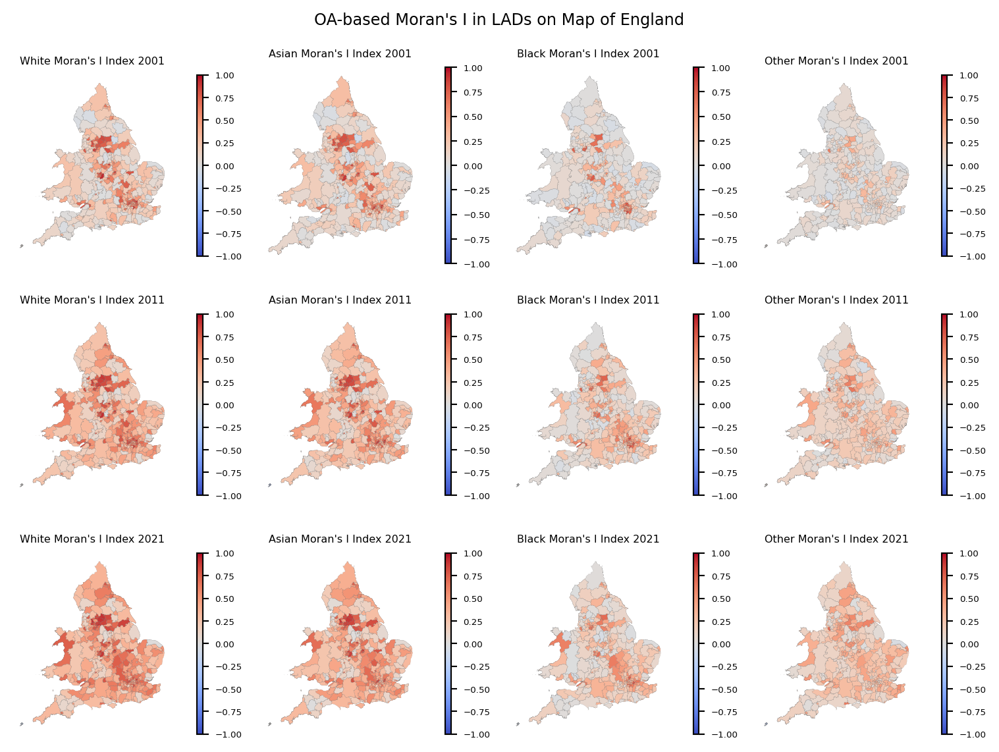

In [44]:
#| echo: false
#| label: fig-moranonxmap
#| fig-cap: OA-based Moran's I in LADs on Map of England

map_data = pd.merge(LAD_moran_total, LAD_total[['LADCD', 'geometry']], on='LADCD')
map_data = gpd.GeoDataFrame(map_data, geometry='geometry')

years = [2001, 2011, 2021]

fig, axes = plt.subplots(nrows=3, ncols=4, figsize=(8, 8))

# Flatten the axes array for easier iteration
axes = axes.flatten()

# Variables and titles for the plots
variables = [
    ('OA_white_mor', -1, 1, 'White Moran\'s I Index', 'coolwarm'),
    ('OA_asian_mor', -1, 1, 'Asian Moran\'s I Index', 'coolwarm'),
    ('OA_black_mor', -1, 1, 'Black Moran\'s I Index', 'coolwarm'),
    ('OA_other_mor', -1, 1, 'Other Moran\'s I Index', 'coolwarm'),
]

# Loop through years and variables to plot the maps
for j, year in enumerate(years):
    for i, (variable, min_val, max_val, title, cmap) in enumerate(variables):
        # Filter data for the given year
        data_year = map_data[map_data['year'] == year]

        # Determine the correct subplot index
        ax_index = j * 4 + i
        
        # Plot the variable
        ax = axes[ax_index]
        divider = make_axes_locatable(ax)
        cax = divider.append_axes("right", size="3.5%", pad=0.2)
        data_year.plot(column=variable, cmap=cmap, linewidth=0.05, ax=ax, edgecolor='0.5',
                       vmin=min_val, vmax=max_val, legend=False)
    
        # Manually create the colorbar
        norm = plt.Normalize(vmin=min_val, vmax=max_val)
        cbar = plt.colorbar(plt.cm.ScalarMappable(norm=norm, cmap=cmap), cax=cax)
        cbar.ax.tick_params(labelsize=5)

        ax.set_title(f'{title} {year}', fontsize=6)
        ax.axis('off')

fig.suptitle('OA-based Moran\'s I in LADs on Map of England', fontsize=9, y=0.85)

# Adjust layout
plt.subplots_adjust(hspace=-0.5)
plt.tight_layout(rect=[0, 0, 1, 0.96])
plt.show()

# Detailed Examination of Segregation in Selected English Cities
<p style="text-align: justify;" >
In this part of the study, a deeper analysis of segregation in selected cities across England is conducted. These cities were chosen based on significant differences between the Simpson Index at the Local Authority District (LAD) level and the Output Area (OA) level, indicating notable variations in the spatial distribution of ethnic groups within these regions. Additionally, London is included in this analysis due to its prominence as the capital city and its diverse demographic landscape. 
<p style="text-align: justify;">
As mentioned earlier, the "other" ethnic group was excluded from the calculation of the Simpson Index in all cities and at all levels.
To understand how diverse the population is distributed within the cities, the data in different levels are plotted on a map.
<p style="text-align: justify;">
In addition, in each LAD, the OA-based Moran's I index is calculated and reflected on the city map. For calculating the Moran's I index for each MSOA, the OAs inside each MSOA were considered as the sub-areas. The choice of OAs over LSOAs for evaluating the Moran's I index within MSOAs stems from their differing spatial scales and levels of aggregation. OAs, being the smallest geographic units in census data, provide a finer resolution of spatial analysis with each unit typically encompassing a population of around 100-150 households or roughly 300 people. This finer granularity allows for more precise detection of spatial clustering phenomena. For instance, the positive OA-based Asian Moran's I index indicates a tendency for ethnic groups to cluster together within neighbouring OAs, reflecting localized spatial autocorrelation where similar ethnic compositions are grouped together.
<p style="text-align: justify;">
In contrast, LSOAs are larger units aggregating multiple OAs, typically containing about 1,000-3,000 people or 400-1,200 households. The aggregation of diverse OAs within LSOAs results in a broader spatial scope but can lead to a dilution of localized patterns observed at the OA level. At the LSOA level, the spatial analysis may show more dispersed patterns or spatial dissimilarity because of the mixing of different local compositions within each LSOA. This is reflected in the negative LSOA-based Moran's I values, indicating a lack of clustering or dispersion of high and low ethnic composition values within neighbouring LSOAs. Therefore, by focusing on OAs within MSOAs, we gain a more detailed understanding of local spatial patterns and clustering tendencies within the finer geographic units.
</p>

## Birmingham
<p style="text-align: justify;" >
Birmingham, the second largest city in England, has a population where less than 50% is composed of the white ethnic group. According to @fig-birmethnicpop, Birmingham's total population increased from 977,057 in 2001 to 1,144,951 in 2021. During this period, the population of the white ethnic group decreased from 687,386 to 556,630. As shown in @fig-birmfracoverview, the fraction of the white ethnic group decreased from 70% of the population in 2001 to 48% in 2021. Among all ethnicities, the Asian population has experienced the highest growth rate.
</p>

In [45]:
#| include: false
birmingham_indexes = LAD_total[LAD_total['LADNM'].str.contains('Birmingham')].reset_index(drop= True)
birmingham_indexes['total_population']= (birmingham_indexes['white']+birmingham_indexes['asian'] + 
                                        birmingham_indexes['black']+birmingham_indexes['other'])
cols = list(birmingham_indexes.columns)
cols.insert(7, cols.pop(cols.index('total_population')))
birmingham_indexes = birmingham_indexes[cols]
birmingham_indexes

,year,LADCD,LADNM,white,asian,black,other,total_population,white_frac,asian_frac,...,MSOA_white_mor,OA_asian_mor,LSOA_asian_mor,MSOA_asian_mor,OA_black_mor,LSOA_black_mor,MSOA_black_mor,OA_other_mor,LSOA_other_mor,MSOA_other_mor
0,2001,E08000025,Birmingham,687386,201959,59784,27928,977057,0.704,0.207,...,0.793,0.892,0.878,0.710,0.761,0.835,0.774,0.363,0.557,0.545
1,2011,E08000025,Birmingham,621636,285640,96360,69409,1073045,0.579,0.266,...,0.820,0.881,0.874,0.727,0.718,0.750,0.670,0.522,0.676,0.613
2,2021,E08000025,Birmingham,556630,355386,125741,107194,1144951,0.486,0.310,...,0.820,0.868,0.870,0.736,0.685,0.713,0.645,0.449,0.666,0.660


In [46]:
#| include: false
# creating Birmingham dataframe
birmingham_2001= pd.read_csv('preprocessed files/2001/birmingham_2001.csv')
birmingham_2011= pd.read_csv('preprocessed files/2011/birmingham_2011.csv')
birmingham_2021= pd.read_csv('preprocessed files/2021/birmingham_2021.csv')
birmingham_2001['simp_diff'] = birmingham_2001['OA_simpson']- birmingham_indexes.LAD_simpson[0]
birmingham_2011['simp_diff'] = birmingham_2011['OA_simpson']- birmingham_indexes.LAD_simpson[1]
birmingham_2021['simp_diff'] = birmingham_2021['OA_simpson']- birmingham_indexes.LAD_simpson[2]

birmingham_LSOA_2001= pd.read_csv('preprocessed files/2001/birmingham_LSOA_2001.csv')
birmingham_LSOA_2011= pd.read_csv('preprocessed files/2011/birmingham_LSOA_2011.csv')
birmingham_LSOA_2021= pd.read_csv('preprocessed files/2021/birmingham_LSOA_2021.csv')
birmingham_LSOA_2001['simp_diff'] = birmingham_LSOA_2001['LSOA_simpson']- birmingham_indexes.LAD_simpson[0]
birmingham_LSOA_2011['simp_diff'] = birmingham_LSOA_2011['LSOA_simpson']- birmingham_indexes.LAD_simpson[1]
birmingham_LSOA_2021['simp_diff'] = birmingham_LSOA_2021['LSOA_simpson']- birmingham_indexes.LAD_simpson[2]

birmingham_MSOA_2001= pd.read_csv('preprocessed files/2001/birmingham_MSOA_2001.csv')
birmingham_MSOA_2011= pd.read_csv('preprocessed files/2011/birmingham_MSOA_2011.csv')
birmingham_MSOA_2021= pd.read_csv('preprocessed files/2021/birmingham_MSOA_2021.csv')
birmingham_MSOA_2001['simp_diff'] = birmingham_MSOA_2001['MSOA_simpson']- birmingham_indexes.LAD_simpson[0]
birmingham_MSOA_2011['simp_diff'] = birmingham_MSOA_2011['MSOA_simpson']- birmingham_indexes.LAD_simpson[1]
birmingham_MSOA_2021['simp_diff'] = birmingham_MSOA_2021['MSOA_simpson']- birmingham_indexes.LAD_simpson[2]

birmingham= pd.concat([birmingham_2001,birmingham_2011,birmingham_2021]).reset_index(drop=True)
birmingham.insert(9, 'simp_diff', birmingham.pop('simp_diff'))

# Converting the dataframe into GPD
birmingham['geometry'] = birmingham['geometry'].apply(wkt.loads)
birmingham = gpd.GeoDataFrame(birmingham, geometry='geometry')

birmingham_center = {"lat": 52.4862, "lon": -1.8904}

In [47]:
#| include: false
# Creating df for OA level
birmingham_OA = birmingham.drop(['LSOACD', 'MSOACD', 'LADCD', 'LSOANM', 'MSOANM'], axis= 1)
birmingham_OA = birmingham_OA.set_crs(epsg=27700)
birmingham_OA = birmingham_OA.to_crs(epsg=4326)

In [48]:
#| include: false
# Creating df for LSOA level
birmingham_LSOA= pd.concat([birmingham_LSOA_2001,birmingham_LSOA_2011,birmingham_LSOA_2021]).reset_index(drop=True)
birmingham_LSOA.insert(3, 'simp_diff', birmingham_LSOA.pop('simp_diff'))

birmingham_LSOA['geometry'] = birmingham_LSOA['geometry'].apply(wkt.loads)
birmingham_LSOA = gpd.GeoDataFrame(birmingham_LSOA, geometry='geometry')

birmingham_LSOA = birmingham_LSOA.set_crs(epsg=27700)
birmingham_LSOA = birmingham_LSOA.to_crs(epsg=4326)

In [49]:
#| include: false
# Creating df for MSOA level
birmingham_MSOA= pd.concat([birmingham_MSOA_2001,birmingham_MSOA_2011,birmingham_MSOA_2021]).reset_index(drop=True)
birmingham_MSOA.insert(3, 'simp_diff', birmingham_MSOA.pop('simp_diff'))

birmingham_MSOA['geometry'] = birmingham_MSOA['geometry'].apply(wkt.loads)
birmingham_MSOA = gpd.GeoDataFrame(birmingham_MSOA, geometry='geometry')

birmingham_MSOA = birmingham_MSOA.set_crs(epsg=27700)
birmingham_MSOA = birmingham_MSOA.to_crs(epsg=4326)

In [50]:
#| echo: false
#| label: fig-birmethnicpop
#| fig-cap: Ethnicity and Total Population Line Chart - Birmingham
# Ethnicity and Total Population Line Chart - Birmingham

birmingham_long= birmingham_indexes[['year','white', 'asian', 'black', 'other']].melt(id_vars=['year'], 
                                                                                      var_name='ethnicity',
                                                                                      value_name='population',)

# Create subplots
fig = make_subplots(rows=2, cols=1, subplot_titles=("Ethnicity Population - Birmingham", "Total Population - Birmingham"),
                     vertical_spacing=0.15)

# Add traces for ethnicity populations
offsets = {
    'white': (10, 30),
    'asian': (10, -10),
    'black': (10, -10),
    'other': (10, 30)
}

for ethnicity in birmingham_long['ethnicity'].unique():
    trace = go.Scatter(
        x=birmingham_long[birmingham_long['ethnicity'] == ethnicity]['year'],
        y=birmingham_long[birmingham_long['ethnicity'] == ethnicity]['population'],
        mode='lines+markers',
        name=ethnicity,
        legendgroup=ethnicity 
    )
    fig.add_trace(trace, row=1, col=1)
    
    # Add annotations with custom offsets for each ethnicity
    for i, row in birmingham_long[birmingham_long['ethnicity'] == ethnicity].iterrows():
        ax, ay = offsets.get(ethnicity, (0, 0)) 
        fig.add_annotation(
            x=row['year'],
            y=row['population'],
            text=f"{row['population']:,}",
            showarrow=True,
            arrowhead=0,
            ax=ax,
            ay=ay,
            font=dict(size=10),
            xanchor='center',
            yanchor='bottom',
            row=1,
            col=1
        )

# Add trace for total population in the second subplot
total_population_trace = go.Scatter(
    x=birmingham_indexes['year'],
    y=birmingham_indexes['total_population'],
    mode='lines+markers',
    name='Total Population',
    line=dict(color='black')
)
fig.add_trace(total_population_trace, row=2, col=1)

# Add annotations for total population
for i, row in birmingham_indexes.iterrows():
    fig.add_annotation(
        x=row['year'],
        y=row['total_population'],
        text=f"{row['total_population']:,}",
        showarrow=True,
        arrowhead=0,
        ax=0,
        ay=-20,
        font=dict(size=10),
        xanchor='center',
        yanchor='bottom',
        row=2,
        col=1
    )

# Update x-axis and y-axis titles
fig.update_xaxes(title_text="Year", row=1, col=1)
fig.update_yaxes(title_text="Ethnicity Population", row=1, col=1)
fig.update_xaxes(title_text="Year", row=1, col=2)
fig.update_yaxes(title_text="Total Population", row=1, col=2)

# Update layout
fig.update_layout(
    height=700, 
    width=650, 
    title_text="Ethnicity and Total Population Line Chart - Birmingham",
    title_x=0.5,
    title_y=0.96,
    showlegend=True,
    legend=dict(orientation="h", yanchor="top", y= 1.1, xanchor="center", x=0.5)
    )

# Display the figure
pyo.iplot(fig)


In [51]:
#| echo: false
#| label: fig-birmfracoverview
#| fig-cap: Ethnic Group Fractions Over Time - Birmingham
# Ethnic Group Fractions Over Time - Birmingham

fig = go.Figure()

# Add traces for each ethnic group fraction as stacked bars with percentage annotations outside
fig.add_trace(go.Bar(x=birmingham_indexes['year'], y=birmingham_indexes['white_frac'], 
                     name='White', legendgroup='ethnic_group', width=4, marker=dict(color='gray'),
                     text=birmingham_indexes['white_frac'] * 100, textposition='outside', 
                     texttemplate='%{text:.2f}%'))
fig.add_trace(go.Bar(x=birmingham_indexes['year'], y=birmingham_indexes['asian_frac'], 
                     name='Asian', legendgroup='ethnic_group', width=4, marker=dict(color='orange'),
                     text=birmingham_indexes['asian_frac'] * 100, textposition='outside', 
                     texttemplate='%{text:.2f}%'))
fig.add_trace(go.Bar(x=birmingham_indexes['year'], y=birmingham_indexes['black_frac'], 
                     name='Black', legendgroup='ethnic_group', width=4, marker=dict(color='black'),
                     text=birmingham_indexes['black_frac'] * 100, textposition='outside', 
                     texttemplate='%{text:.2f}%'))
fig.add_trace(go.Bar(x=birmingham_indexes['year'], y=birmingham_indexes['other_frac'], 
                     name='Other', legendgroup='ethnic_group', width=4, marker=dict(color='green'),
                     text=birmingham_indexes['other_frac'] * 100, textposition='inside', 
                     texttemplate='%{text:.2f}%'))

# Update layout
fig.update_layout(title_text="Ethnic Group Fractions Over Time - Birmingham",
                  title_x=0.5,
                  title_y=0.9,
                  title_font=dict(size=16),
                  xaxis_title='Year',
                  xaxis=dict(tickvals=[2001, 2011, 2021]),
                  yaxis_title='Ethnicity Fraction',
                  yaxis=dict(
                      title='Ethnicity Fraction',
                      side='left'),
                  barmode='relative',
                  hovermode='x unified',
                  width=600,
                  height=500,
                  legend=dict(orientation="h",
                              yanchor="top",
                              y=1.1,
                              xanchor="center",
                              x=0.5,
                              traceorder='normal'))

# Display the figure
pyo.iplot(fig)


In [52]:
#| include: false
# #| echo: false
# #| label: fig-birmsimp
# #| fig-cap: Simpson Index Line Chart - Birmingham

# birmingham_long= birmingham_indexes[['year','OA_simpson', 'LSOA_simpson', 'MSOA_simpson', 'LAD_simpson']].melt(id_vars=['year'], var_name='level', value_name='simpson_index')

# traces = []
# for level in birmingham_long['level'].unique():
#     trace = go.Scatter(
#         x= birmingham_long[birmingham_long['level'] == level]['year'],
#         y= birmingham_long[birmingham_long['level'] == level]['simpson_index'],
#         mode='lines+markers',
#         name=level
#     )
#     traces.append(trace)

# layout = go.Layout(title_text="Simpson Index Line Chart - Birmingham",
#                     title_x=0.5,
#                     title_font=dict(size=16),
#                     xaxis=dict(title='Year', tickvals=birmingham_long['year'].unique()),
#                     yaxis=dict(title='Simpson Index'),
#                     legend=dict(orientation="h",
#                                 yanchor="top",
#                                 y=1.2,
#                                 xanchor="center",
#                                 x=0.5),
#                     hovermode='closest',
#                     showlegend=True,
#                     height = 400,
#                     width = 700
# )


# fig = go.Figure(data=traces, layout=layout)

# pyo.iplot(fig)

In [53]:
#| include: false
# #| echo: false
# #| label: fig-birmoamap
# #| fig-cap: OA Simpson Index by Year in Birmingham
# # OA Simpson Index by Year in Birmingham

# fig = px.choropleth_mapbox(birmingham_OA,
#                            geojson=birmingham_OA.geometry,
#                            locations=birmingham_OA.index,
#                            color='OA_simpson',
#                            animation_frame='year',
#                            color_continuous_scale=px.colors.diverging.RdBu[::-1],
#                            range_color=(0, 1),
#                            hover_name='OACD',
#                            hover_data={'white_fraction': True},
#                            labels={'OA_simpson': 'OA Simpson Index',
#                                    'white_fraction': 'White Fraction'},
#                            title='OA Simpson Index by Year in Birmingham',
#                            center=birmingham_center,
#                            zoom=10,
#                            mapbox_style='carto-positron'
#                            )

# # Customize the layout
# fig.update_layout(margin={"r":0,"t":40,"l":0,"b":0}, title_x=0.5,
#                   width=800,
#                   height=800 
#     )


# # Display the map
# fig.show()

In [54]:
#| include: false
# #| echo: false
# #| label: fig-birmlsoamap
# #| fig-cap: LSOA Simpson Index by Year in Birmingham
# # LSOA Simpson Index by Year in Birmingham

# fig = px.choropleth_mapbox(birmingham_LSOA,
#                            geojson=birmingham_LSOA.geometry,
#                            locations=birmingham_LSOA.index,
#                            color='LSOA_simpson',
#                            animation_frame='year',
#                            color_continuous_scale=px.colors.diverging.RdBu[::-1],
#                            range_color=(0, 1),
#                            hover_name='LSOACD',
#                            hover_data={'white_fraction': True, 'white_moran': True},
#                            labels={'LSOA_simpson': 'LSOA Simpson Index',
#                                    'white_fraction': 'White Fraction',
#                                    'white_moran': 'White Moran'},
#                            title='LSOA Simpson Index by Year in Birmingham',
#                            center=birmingham_center,
#                            zoom=10,
#                            mapbox_style='carto-positron'
#                            )

# # Customize the layout
# fig.update_layout(margin={"r":0,"t":40,"l":0,"b":0}, title_x=0.5,
#                   width=800,
#                   height=800 
#     )

# # Display the map
# fig.show()

In [55]:
#| include: false
# #| echo: false
# #| label: fig-birmmsoamap
# #| fig-cap: MSOA Simpson Index by Year in Birmingham
# # MSOA Simpson Index by Year in Birmingham

# fig = px.choropleth_mapbox(birmingham_MSOA,
#                            geojson=birmingham_MSOA.geometry,
#                            locations=birmingham_MSOA.index,
#                            color='MSOA_simpson',
#                            animation_frame='year',
#                            color_continuous_scale=px.colors.diverging.RdBu[::-1],
#                            range_color=(0, 1),
#                            hover_name='MSOACD',
#                            hover_data={'white_fraction': True, 'white_moran_OA': True},
#                            labels={'MSOA_simpson': 'MSOA Simpson Index',
#                                    'white_fraction': 'White Fraction',
#                                    'white_moran_OA': 'OA-based White Moran'},
#                            title='MSOA Simpson Index by Year in Birmingham',
#                            center=birmingham_center,
#                            zoom=10,
#                            mapbox_style='carto-positron'
#                            )

# # Customize the layout
# fig.update_layout(margin={"r":0,"t":40,"l":0,"b":0}, title_x=0.5,
#                   width=800,
#                   height=800 
#     )

# # Display the map
# fig.show()

In [56]:
#| include: false
# #| echo: false
# #| label: fig-bradlsoamormap
# #| fig-cap: Moran's I Index by Year in Birmingham LSOAs
# # Moran's I Index by Year in Birmingham LSOAs

# ethnicity = 'white'
# fig = px.choropleth_mapbox(birmingham_LSOA,
#                            geojson=birmingham_LSOA.geometry,
#                            locations=birmingham_LSOA.index,
#                            color=f'{ethnicity}_moran',
#                            animation_frame='year',
#                            color_continuous_scale=px.colors.diverging.RdBu[::-1],
#                            range_color=(-1, 1),
#                            hover_name='LSOACD',
#                            hover_data={f'{ethnicity}_fraction': True},
#                            labels={f'{ethnicity}_moran': f'{ethnicity.capitalize()} Moran Index',
#                                    f'{ethnicity}_fraction': f'{ethnicity.capitalize()} Fraction'},
#                            title="Moran's I Index by Year in Birmingham LSOAs",
#                            center=birmingham_center,
#                            zoom=10,
#                            mapbox_style='carto-positron'
#                            )

# # Customize the layout
# fig.update_layout(margin={"r":0,"t":40,"l":0,"b":0}, title_x=0.5,
#                   width=800,
#                   height=800 
#     )

# # Display the map
# fig.show()




In [57]:
#| include: false
# #| echo: false
# #| label: fig-birmmsoamormapoa
# #| fig-cap: OA-based Moran's I Index by Year in Birmingham MSOAs
# # OA-based Moran's I Index by Year in Birmingham MSOAs
# ethnicity = 'white'
# fig = px.choropleth_mapbox(birmingham_MSOA,
#                            geojson=birmingham_MSOA.geometry,
#                            locations=birmingham_MSOA.index,
#                            color=f'{ethnicity}_moran_OA',
#                            animation_frame='year',
#                            color_continuous_scale=px.colors.diverging.RdBu[::-1],
#                            range_color=(-1, 1),
#                            hover_name='MSOACD',
#                            hover_data={f'{ethnicity}_fraction': True},
#                            labels={f'{ethnicity}_moran_OA': f'OA-based {ethnicity.capitalize()} Moran Index',
#                                    f'{ethnicity}_fraction': f'{ethnicity.capitalize()} Fraction'},
#                            title="OA-based Moran's I Index by Year in Birmingham MSOAs",
#                            center=birmingham_center,
#                            zoom=10,
#                            mapbox_style='carto-positron'
#                            )

# # Customize the layout
# fig.update_layout(margin={"r":0,"t":40,"l":0,"b":0}, title_x=0.5,
#                   width=800,
#                   height=800 
#     )

# # Display the map
# fig.show()

In [58]:
#| include: false
# #| echo: false
# #| label: fig-birmmsoamormaplsoa
# #| fig-cap: LSOA-based Moran's I Index by Year in Birmingham MSOAs
# # LSOA-based Moran's I Index by Year in Birmingham MSOAs
# ethnicity = 'white'
# fig = px.choropleth_mapbox(birmingham_MSOA,
#                            geojson=birmingham_MSOA.geometry,
#                            locations=birmingham_MSOA.index,
#                            color=f'{ethnicity}_moran_LSOA',
#                            animation_frame='year',
#                            color_continuous_scale=px.colors.diverging.RdBu[::-1],
#                            range_color=(-1, 1),
#                            hover_name='MSOACD',
#                            hover_data={f'{ethnicity}_fraction': True},
#                            labels={f'{ethnicity}_moran_LSOA': f'LSOA-based {ethnicity.capitalize()} Moran Index',
#                                    f'{ethnicity}_fraction': f'{ethnicity.capitalize()} Fraction'},
#                            title="LSOA-based Moran's I Index by Year in Birmingham MSOAs",
#                            center=birmingham_center,
#                            zoom=10,
#                            mapbox_style='carto-positron'
#                            )

# # Customize the layout
# fig.update_layout(margin={"r":0,"t":40,"l":0,"b":0}, title_x=0.5,
#                   width=800,
#                   height=800 
#     )

# # Display the map
# fig.show()



### Birmingham Map – OA Level
<p style="text-align: justify;">
@fig-oabirmmap shows the Simpson Index for each OA and its difference from the town-wide Simpson Index in Birmingham. In the first column, which depicts the Simpson Index of OAs, the overall Simpson Index is decreasing (more OAs are moving toward blue).
In the second column which shows the Simpson Index difference with town-wide Simpson Index, this difference increased in some OAs while decreased in some others. However, especially in central areas, this difference increased. 
</p>

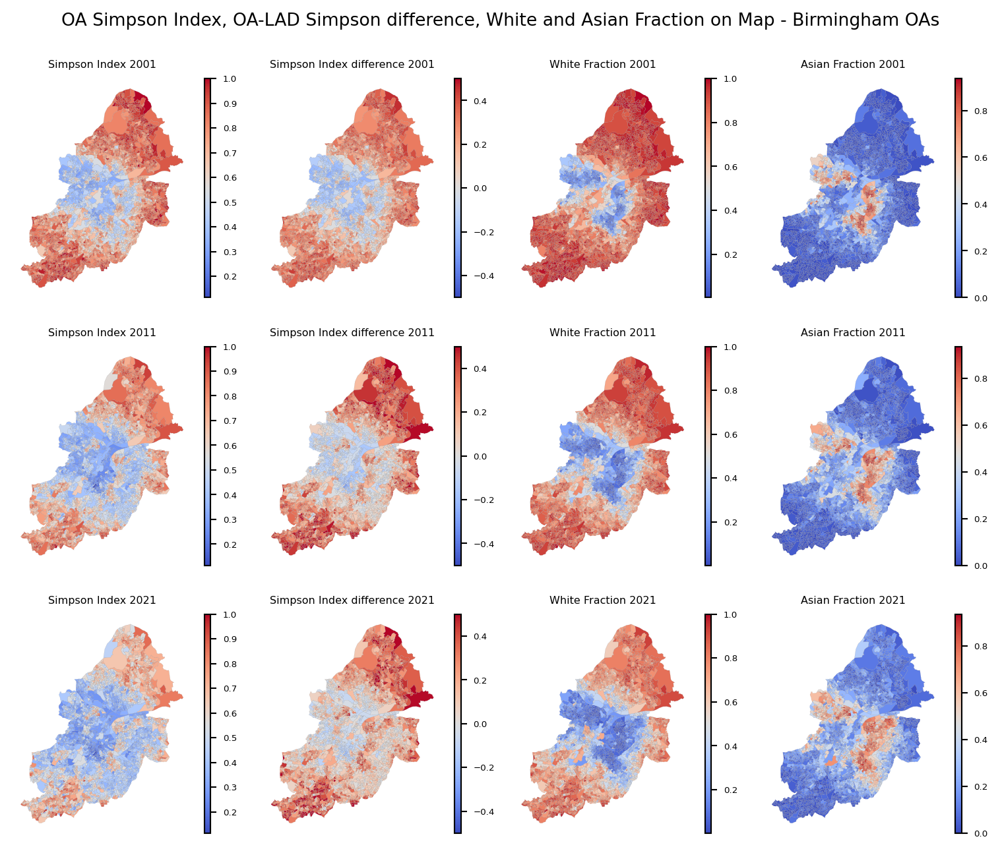

In [59]:
#| echo: false
#| label: fig-oabirmmap
#| fig-cap: OA Simpson Index, White and Asian Fraction and Asian Moran's I on Map - Birmingham OAs

years = [2001, 2011, 2021]

oa_simpson_min, oa_simpson_max = birmingham['OA_simpson'].min(), birmingham['OA_simpson'].max()
white_fraction_min, white_fraction_max = birmingham['white_fraction'].min(), birmingham['white_fraction'].max()
asian_fraction_min, asian_fraction_max = birmingham['asian_fraction'].min(), birmingham['asian_fraction'].max()

# Reverse the colormap for the last column
fig, axes = plt.subplots(nrows=3, ncols=4, figsize=(8, 8))

# Flatten the axes array for easier iteration
axes = axes.flatten()

# Variables and titles for the plots
variables = [
    ('OA_simpson', oa_simpson_min, oa_simpson_max, 'Simpson Index', 'coolwarm'),
    ('simp_diff', -0.5,0.5, 'Simpson Index difference', 'coolwarm'),
    ('white_fraction', white_fraction_min, white_fraction_max, 'White Fraction', 'coolwarm'),
    ('asian_fraction', asian_fraction_min, asian_fraction_max, 'Asian Fraction', 'coolwarm'),
]

# Loop through years and variables to plot the maps
for j, year in enumerate(years):
    for i, (variable, min_val, max_val, title, cmap) in enumerate(variables):
        # Filter data for the given year
        data_year = birmingham[birmingham['year'] == year]

        # Determine the correct subplot index
        ax_index = j * 4 + i
        
        # Plot the variable
        ax = axes[ax_index]
        divider = make_axes_locatable(ax)
        cax = divider.append_axes("right", size="3.5%", pad=0.1)
        data_year.plot(column=variable, cmap=cmap, linewidth=0.05, ax=ax, edgecolor='0.5',
                       vmin=min_val, vmax=max_val, legend=False)
        # Manually create the colorbar
        norm = plt.Normalize(vmin=min_val, vmax=max_val)
        cbar = plt.colorbar(plt.cm.ScalarMappable(norm=norm, cmap=cmap), cax=cax)
        cbar.ax.tick_params(labelsize=5)

        ax.set_title(f'{title} {year}', fontsize=6)
        ax.axis('off')


fig.suptitle('OA Simpson Index, OA-LAD Simpson difference, White and Asian Fraction on Map - Birmingham OAs', fontsize=10, y= 0.9)

# Adjust layout
plt.subplots_adjust(hspace=-0.3)
plt.tight_layout(rect=[0, 0, 1, 0.96])
plt.show()

### Birmingham Map – LSOA Level
<p style="text-align: justify;">
@fig-lsoabirmmap shows the Simpson Index for each LSOA in Birmingham and its difference from the town-wide Simpson Index. The same pattern noticed in OAs can be seen in LSOAs. In the right-side column of the plot, the Asian Moran's I index for each LSOA is displayed. Based on it, the predominant value for the Asian Moran's I index is negative or close to zero. Like OA Simpson Index, the difference between LSOA Simpson Index and town-wide Simpson Index is increasing.

<p style="text-align: justify;">
A negative or near-zero Moran's I index for the Asian population suggests either a dispersed pattern or no significant spatial pattern in their distribution. A negative value indicates spatial dispersion or a pattern of spatial dissimilarity among the Asian population. In other words, areas with high percentages of the Asian population are more likely to be adjacent to areas with low percentages of the Asian population, rather than clustering together. A near-zero value means there is no significant clustering or dispersion of the Asian population; instead, the distribution of Asians in OAs within each LSOA is more random and does not show a distinct pattern of spatial autocorrelation.
</p>

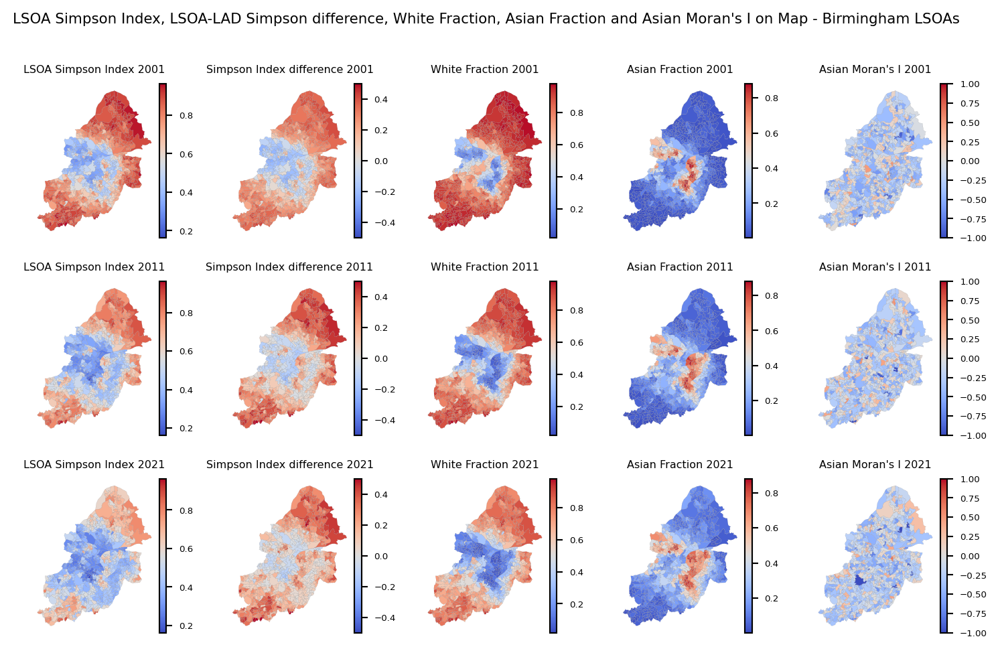

In [60]:
#| echo: false
#| label: fig-lsoabirmmap
#| fig-cap: LSOA Simpson Index, White and Asian Fraction and Asian Moran's I on Map - Birmingham LSOAs

years = [2001, 2011, 2021]

lsoa_simpson_min, lsoa_simpson_max = birmingham_LSOA['LSOA_simpson'].min(), birmingham_LSOA['LSOA_simpson'].max()
white_fraction_min, white_fraction_max = birmingham_LSOA['white_fraction'].min(), birmingham_LSOA['white_fraction'].max()
asian_fraction_min, asian_fraction_max = birmingham_LSOA['asian_fraction'].min(), birmingham_LSOA['asian_fraction'].max()
asian_moran_min, asian_moran_max = birmingham_LSOA['asian_moran'].min(), birmingham_LSOA['asian_moran'].max()

# Reverse the colormap for the last column
fig, axes = plt.subplots(nrows=3, ncols=5, figsize=(8, 8))

# Flatten the axes array for easier iteration
axes = axes.flatten()

# Variables and titles for the plots
variables = [
    ('LSOA_simpson', lsoa_simpson_min, lsoa_simpson_max, 'LSOA Simpson Index', 'coolwarm'),
    ('simp_diff', -0.5,0.5, 'Simpson Index difference', 'coolwarm'),
    ('white_fraction', white_fraction_min, white_fraction_max, 'White Fraction', 'coolwarm'),
    ('asian_fraction', asian_fraction_min, asian_fraction_max, 'Asian Fraction', 'coolwarm'),
    ('asian_moran', -1, 1, "Asian Moran's I", 'coolwarm')
    
]

# Loop through years and variables to plot the maps
for j, year in enumerate(years):
    for i, (variable, min_val, max_val, title, cmap) in enumerate(variables):
        # Filter data for the given year
        data_year = birmingham_LSOA[birmingham_LSOA['year'] == year]

        # Determine the correct subplot index
        ax_index = j * 5 + i
        
        # Plot the variable
        ax = axes[ax_index]
        divider = make_axes_locatable(ax)
        cax = divider.append_axes("right", size="3.5%", pad=-0.3)
        data_year.plot(column=variable, cmap=cmap, linewidth=0.05, ax=ax, edgecolor='0.5',
                       vmin=min_val, vmax=max_val, legend=False)

        # Manually create the colorbar
        norm = plt.Normalize(vmin=min_val, vmax=max_val)
        cbar = plt.colorbar(plt.cm.ScalarMappable(norm=norm, cmap=cmap), cax=cax)
        cbar.ax.tick_params(labelsize=5)

        ax.set_title(f'{title} {year}', fontsize=6)
        ax.axis('off')


fig.suptitle('LSOA Simpson Index, LSOA-LAD Simpson difference, White Fraction, Asian Fraction and Asian Moran\'s I on Map - Birmingham LSOAs', 
             fontsize=8, y=0.80)

# Adjust layout
plt.subplots_adjust(hspace=-0.7)
plt.tight_layout(rect=[0, 0, 1, 0.96])
plt.show()


### Birmingham Map – MSOA Level
<p style="text-align: justify;">
@fig-msoabirmmap shows the Simpson Index for each MSOA and its difference from the town-wide Simpson Index in Birmingham. The same patterns observed in OAs and LSOAs can be seen in MSOAs. This plot includes the White and Asian Moran's I index of each MSOA, both calculated based on the OAs inside them. It is observed that in most MSOAs, especially in central part of the map, the Moran’s I index is positive for both White and Asian ethnicities. This means a significant clustering of both White and Asian ethnicities. A positive Moran's I index for both groups indicates that similar values (high percentages or low percentages of the respective ethnicities) are geographically clustered together. This suggests that neighbourhoods or areas within these MSOAs tend to have higher or lower concentrations of White and Asian populations, rather than these populations being evenly distributed or randomly dispersed.
</p>

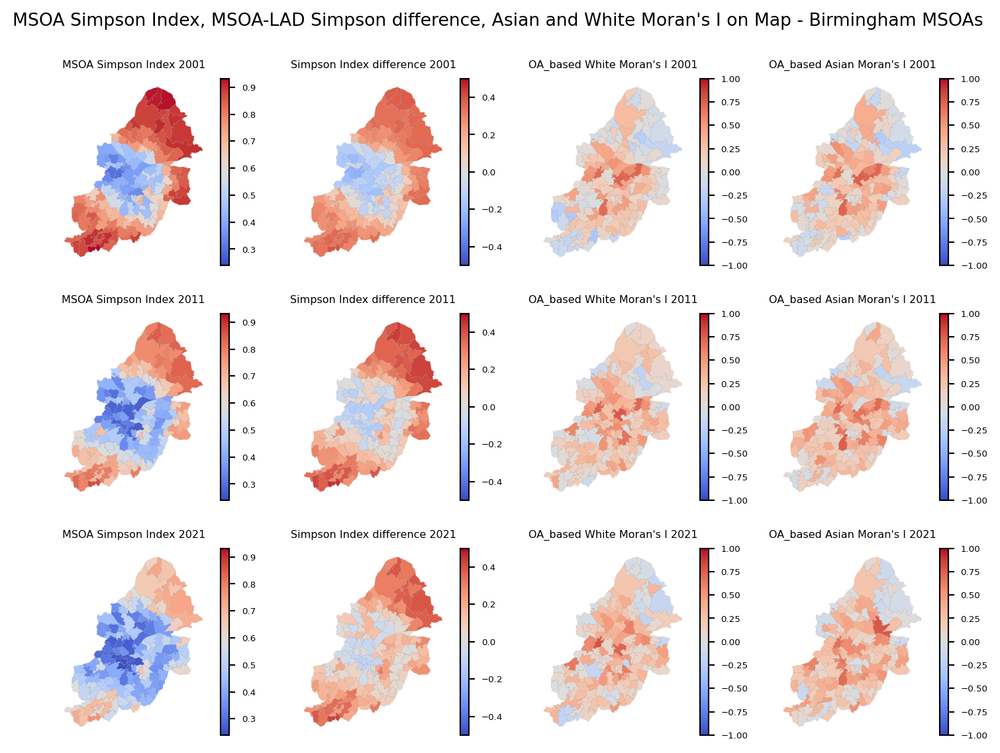

In [61]:
#| echo: false
#| label: fig-msoabirmmap
#| fig-cap: MSOA Simpson Index, MSOA-LAD Simpson difference, Asian and White Moran's I on Map - Birmingham MSOAs

years = [2001, 2011, 2021]

msoa_simpson_min, msoa_simpson_max = birmingham_MSOA['MSOA_simpson'].min(), birmingham_MSOA['MSOA_simpson'].max()

# Reverse the colormap for the last column
fig, axes = plt.subplots(nrows=3, ncols=4, figsize=(8, 8))

# Flatten the axes array for easier iteration
axes = axes.flatten()

# Variables and titles for the plots
variables = [
    ('MSOA_simpson', msoa_simpson_min, msoa_simpson_max, 'MSOA Simpson Index', 'coolwarm'),
    ('simp_diff', -0.5,0.5, 'Simpson Index difference', 'coolwarm'),
    ('asian_moran_OA', -1, 1, "OA_based White Moran's I", 'coolwarm'),
    ('white_moran_OA', -1, 1, "OA_based Asian Moran's I", 'coolwarm')
    
    
]

# Loop through years and variables to plot the maps
for j, year in enumerate(years):
    for i, (variable, min_val, max_val, title, cmap) in enumerate(variables):
        # Filter data for the given year
        data_year = birmingham_MSOA[birmingham_MSOA['year'] == year]

        # Determine the correct subplot index
        ax_index = j * 4 + i
        
        # Plot the variable
        ax = axes[ax_index]
        divider = make_axes_locatable(ax)
        cax = divider.append_axes("right", size="3.5%", pad=-0.3)
        data_year.plot(column=variable, cmap=cmap, linewidth=0.05, ax=ax, edgecolor='0.5',
                       vmin=min_val, vmax=max_val, legend=False)

        # Manually create the colorbar
        norm = plt.Normalize(vmin=min_val, vmax=max_val)
        cbar = plt.colorbar(plt.cm.ScalarMappable(norm=norm, cmap=cmap), cax=cax)
        cbar.ax.tick_params(labelsize=5)

        ax.set_title(f'{title} {year}', fontsize=6)
        ax.axis('off')


fig.suptitle('MSOA Simpson Index, MSOA-LAD Simpson difference, Asian and White Moran\'s I on Map - Birmingham MSOAs', 
             fontsize=10, y=0.85)

# Adjust layout
plt.subplots_adjust(hspace=-0.5)
plt.tight_layout(rect=[0, 0, 1, 0.96])
plt.show()



### Birmingham Correlations Heatmap
<p style="text-align: justify;">
@fig-birmheatmap illustrates the linear correlation between the LSOA Simpson Index and the ethnicity fractions in each LSOA. As observed, the LSOA Simpson Index has the strongest positive correlation with the predominant ethnicity fraction (here White ethnic group). This correlation decreases as the fraction of the predominant ethnicity decreases over time. Conversely, the correlation between the Simpson Index and other ethnic groups is negative.
</p>

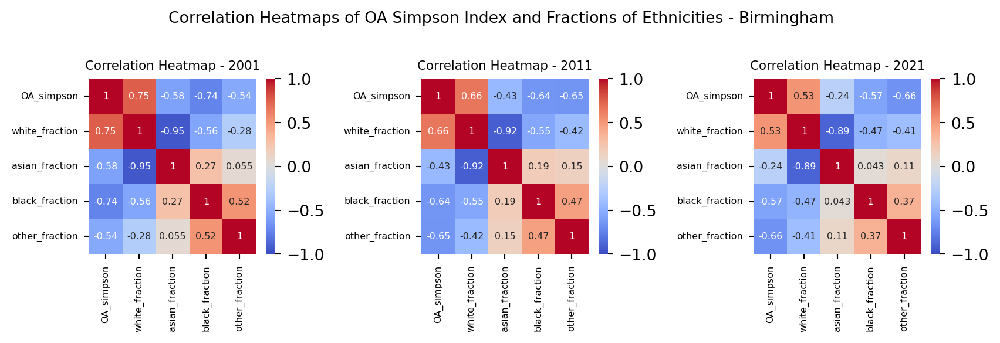

In [62]:
#| echo: false
#| label: fig-birmheatmap
#| fig-cap: Correlation Heatmaps of OA Simpson Index and Fractions of Ethnicities - Birmingham

numerical_columns = ['OA_simpson', 'white_fraction', 'asian_fraction', 'black_fraction', 'other_fraction']

years = [2001, 2011, 2021]

correlation_dic = {}
for year in years:
    # Filter data for the specific year
    corr_df = birmingham_OA[birmingham_OA['year'] == year][numerical_columns]
    correlation_matrix = corr_df.corr()
    correlation_dic[year] = correlation_matrix

fig, axes = plt.subplots(1, 3, figsize=(9, 3))

# Plot each heatmap in a subplot
for i, year in enumerate(years):
    ax = axes[i]
    sns.heatmap(correlation_dic[year], annot=True, cmap='coolwarm', vmin=-1, vmax=1, ax=ax, annot_kws={"size": 6})
    ax.set_title(f'Correlation Heatmap - {year}', fontsize=8)
    ax.tick_params(axis='x', labelsize=6)
    ax.tick_params(axis='y', labelsize=6) 

# Adjust layout
plt.tight_layout(rect=[0, 0, 1, 0.96])
plt.suptitle('Correlation Heatmaps of OA Simpson Index and Fractions of Ethnicities - Birmingham',fontsize=10, y=1)
plt.tight_layout()
plt.show()


## Leicester
<p style="text-align: justify;" >
Leicester is one of the most diverse cities in England. As shown in @fig-leicethnicpop, Leicester's total population increased from 279,832 in 2001 to 368,531 in 2021. During this period, the population of the white ethnic group decreased from 178,693 to 150,676. In contrast, the population of the Asian ethnic group increased and surpassed the white ethnic group population. The growth rate of the Asian population is considerably higher than that of the black and other ethnic groups. As depicted in @fig-leicfracoverview, the fraction of the white ethnic group decreased from 63.9% in 2001 to 40.9% in 2021. In 2021, Asian fraction surpassed white fraction, reaching 43.4%.
</p>

In [63]:
#| include: false
leicester_indexes = LAD_total[LAD_total['LADNM'].str.contains('Leicester') & ~LAD_total['LADNM'].str.contains('North West Leicestershire')].reset_index(drop= True)
leicester_indexes['total_population']= (leicester_indexes['white']+leicester_indexes['asian'] + 
                                        leicester_indexes['black']+leicester_indexes['other'])
cols = list(leicester_indexes.columns)
cols.insert(7, cols.pop(cols.index('total_population')))
leicester_indexes = leicester_indexes[cols]
leicester_indexes

,year,LADCD,LADNM,white,asian,black,other,total_population,white_frac,asian_frac,...,MSOA_white_mor,OA_asian_mor,LSOA_asian_mor,MSOA_asian_mor,OA_black_mor,LSOA_black_mor,MSOA_black_mor,OA_other_mor,LSOA_other_mor,MSOA_other_mor
0,2001,E06000016,Leicester,178693,86044,8576,6519,279832,0.639,0.307,...,0.580,0.853,0.803,0.565,0.553,0.464,0.286,0.179,0.211,-0.004
1,2011,E06000016,Leicester,166636,122470,20585,20148,329839,0.505,0.371,...,0.643,0.879,0.821,0.637,0.509,0.338,0.160,0.389,0.492,0.213
2,2021,E06000016,Leicester,150676,159933,28758,29164,368531,0.409,0.434,...,0.693,0.897,0.866,0.721,0.524,0.471,0.314,0.260,0.437,0.287


In [64]:
#| include: false
# creating Leicester dataframe
leicester_2001= pd.read_csv('preprocessed files/2001/leicester_2001.csv')
leicester_2011= pd.read_csv('preprocessed files/2011/leicester_2011.csv')
leicester_2021= pd.read_csv('preprocessed files/2021/leicester_2021.csv')
leicester_2001['simp_diff'] = leicester_2001['OA_simpson']- leicester_indexes.LAD_simpson[0]
leicester_2011['simp_diff'] = leicester_2011['OA_simpson']- leicester_indexes.LAD_simpson[1]
leicester_2021['simp_diff'] = leicester_2021['OA_simpson']- leicester_indexes.LAD_simpson[2]

leicester_LSOA_2001= pd.read_csv('preprocessed files/2001/leicester_LSOA_2001.csv')
leicester_LSOA_2011= pd.read_csv('preprocessed files/2011/leicester_LSOA_2011.csv')
leicester_LSOA_2021= pd.read_csv('preprocessed files/2021/leicester_LSOA_2021.csv')
leicester_LSOA_2001['simp_diff'] = leicester_LSOA_2001['LSOA_simpson']- leicester_indexes.LAD_simpson[0]
leicester_LSOA_2011['simp_diff'] = leicester_LSOA_2011['LSOA_simpson']- leicester_indexes.LAD_simpson[1]
leicester_LSOA_2021['simp_diff'] = leicester_LSOA_2021['LSOA_simpson']- leicester_indexes.LAD_simpson[2]

leicester_MSOA_2001= pd.read_csv('preprocessed files/2001/leicester_MSOA_2001.csv')
leicester_MSOA_2011= pd.read_csv('preprocessed files/2011/leicester_MSOA_2011.csv')
leicester_MSOA_2021= pd.read_csv('preprocessed files/2021/leicester_MSOA_2021.csv')
leicester_MSOA_2001['simp_diff'] = leicester_MSOA_2001['MSOA_simpson']- leicester_indexes.LAD_simpson[0]
leicester_MSOA_2011['simp_diff'] = leicester_MSOA_2011['MSOA_simpson']- leicester_indexes.LAD_simpson[1]
leicester_MSOA_2021['simp_diff'] = leicester_MSOA_2021['MSOA_simpson']- leicester_indexes.LAD_simpson[2]

leicester= pd.concat([leicester_2001,leicester_2011,leicester_2021]).reset_index(drop=True)
leicester.insert(9, 'simp_diff', leicester.pop('simp_diff'))

# Converting the dataframe into GPD
leicester['geometry'] = leicester['geometry'].apply(wkt.loads)
leicester = gpd.GeoDataFrame(leicester, geometry='geometry')

leicester_center = {"lat": 52.6369, "lon": -1.1398}

In [65]:
#| include: false
# Creating df for OA level
leicester_OA = leicester.drop(['LSOACD', 'MSOACD', 'LADCD', 'LSOANM', 'MSOANM'], axis= 1)
leicester_OA = leicester_OA.set_crs(epsg=27700)
leicester_OA = leicester_OA.to_crs(epsg=4326)

In [66]:
#| include: false
# Creating df for LSOA level
leicester_LSOA= pd.concat([leicester_LSOA_2001,leicester_LSOA_2011,leicester_LSOA_2021]).reset_index(drop=True)
leicester_LSOA.insert(3, 'simp_diff', leicester_LSOA.pop('simp_diff'))

leicester_LSOA['geometry'] = leicester_LSOA['geometry'].apply(wkt.loads)
leicester_LSOA = gpd.GeoDataFrame(leicester_LSOA, geometry='geometry')

leicester_LSOA = leicester_LSOA.set_crs(epsg=27700)
leicester_LSOA = leicester_LSOA.to_crs(epsg=4326)

In [67]:
#| include: false
# Creating df for MSOA level
leicester_MSOA= pd.concat([leicester_MSOA_2001,leicester_MSOA_2011,leicester_MSOA_2021]).reset_index(drop=True)
leicester_MSOA.insert(3, 'simp_diff', leicester_MSOA.pop('simp_diff'))

leicester_MSOA['geometry'] = leicester_MSOA['geometry'].apply(wkt.loads)
leicester_MSOA = gpd.GeoDataFrame(leicester_MSOA, geometry='geometry')

leicester_MSOA = leicester_MSOA.set_crs(epsg=27700)
leicester_MSOA = leicester_MSOA.to_crs(epsg=4326)

In [68]:
#| echo: false
#| label: fig-leicethnicpop
#| fig-cap: Ethnicity and Total Population Line Chart - Leicester
# Ethnicity and Total Population Line Chart - Leicester

leicester_long= leicester_indexes[['year','white', 'asian', 'black', 'other']].melt(id_vars=['year'], 
                                                                                      var_name='ethnicity',
                                                                                      value_name='population',)

# Create subplots
fig = make_subplots(rows=2, cols=1, subplot_titles=("Ethnicity Population - Leicester", "Total Population - Leicester"),
                     vertical_spacing=0.15)

# Add traces for ethnicity populations
offsets = {
    'white': (10, 20),
    'asian': (-5, -10),
    'black': (10, -10),
    'other': (-10, 30)
}

for ethnicity in leicester_long['ethnicity'].unique():
    trace = go.Scatter(
        x=leicester_long[leicester_long['ethnicity'] == ethnicity]['year'],
        y=leicester_long[leicester_long['ethnicity'] == ethnicity]['population'],
        mode='lines+markers',
        name=ethnicity,
        legendgroup=ethnicity 
    )
    fig.add_trace(trace, row=1, col=1)
    
    # Add annotations with custom offsets for each ethnicity
    for i, row in leicester_long[leicester_long['ethnicity'] == ethnicity].iterrows():
        ax, ay = offsets.get(ethnicity, (0, 0)) 
        fig.add_annotation(
            x=row['year'],
            y=row['population'],
            text=f"{row['population']:,}",
            showarrow=True,
            arrowhead=0,
            ax=ax,
            ay=ay,
            font=dict(size=10),
            xanchor='center',
            yanchor='bottom',
            row=1,
            col=1
        )

# Add trace for total population in the second subplot
total_population_trace = go.Scatter(
    x=leicester_indexes['year'],
    y=leicester_indexes['total_population'],
    mode='lines+markers',
    name='Total Population',
    line=dict(color='black')
)
fig.add_trace(total_population_trace, row=2, col=1)

# Add annotations for total population
for i, row in leicester_indexes.iterrows():
    fig.add_annotation(
        x=row['year'],
        y=row['total_population'],
        text=f"{row['total_population']:,}",
        showarrow=True,
        arrowhead=0,
        ax=0,
        ay=-20,
        font=dict(size=10),
        xanchor='center',
        yanchor='bottom',
        row=2,
        col=1
    )

# Update x-axis and y-axis titles
fig.update_xaxes(title_text="Year", row=1, col=1)
fig.update_yaxes(title_text="Ethnicity Population", row=1, col=1)
fig.update_xaxes(title_text="Year", row=1, col=2)
fig.update_yaxes(title_text="Total Population", row=1, col=2)

# Update layout
fig.update_layout(
    height=700, 
    width=650, 
    title_text="Ethnicity and Total Population Line Chart - Leicester",
    title_x=0.5,
    title_y=0.96,
    showlegend=True,
    legend=dict(orientation="h", yanchor="top", y= 1.1, xanchor="center", x=0.5)
    )

# Display the figure
pyo.iplot(fig)


In [69]:
#| echo: false
#| label: fig-leicfracoverview
#| fig-cap: Ethnic Group Fractions Over Time - Leicester
# Ethnic Group Fractions Over Time - Leicester

fig = go.Figure()

# Add traces for each ethnic group fraction as stacked bars with percentage annotations outside
fig.add_trace(go.Bar(x=leicester_indexes['year'], y=leicester_indexes['white_frac'], 
                     name='White', legendgroup='ethnic_group', width=4, marker=dict(color='gray'),
                     text=leicester_indexes['white_frac'] * 100, textposition='outside', 
                     texttemplate='%{text:.2f}%'))
fig.add_trace(go.Bar(x=leicester_indexes['year'], y=leicester_indexes['asian_frac'], 
                     name='Asian', legendgroup='ethnic_group', width=4, marker=dict(color='orange'),
                     text=leicester_indexes['asian_frac'] * 100, textposition='outside', 
                     texttemplate='%{text:.2f}%'))
fig.add_trace(go.Bar(x=leicester_indexes['year'], y=leicester_indexes['black_frac'], 
                     name='Black', legendgroup='ethnic_group', width=4, marker=dict(color='black'),
                     text=leicester_indexes['black_frac'] * 100, textposition='outside', 
                     texttemplate='%{text:.2f}%'))
fig.add_trace(go.Bar(x=leicester_indexes['year'], y=leicester_indexes['other_frac'], 
                     name='Other', legendgroup='ethnic_group', width=4, marker=dict(color='green'),
                     text=leicester_indexes['other_frac'] * 100, textposition='inside', 
                     texttemplate='%{text:.2f}%'))

# Update layout
fig.update_layout(title_text="Ethnic Group Fractions Over Time - Leicester ",
                  title_x=0.5,
                  title_y=0.9,
                  title_font=dict(size=16),
                  xaxis_title='Year',
                  xaxis=dict(tickvals=[2001, 2011, 2021]),
                  yaxis_title='Ethnicity Fraction',
                  yaxis=dict(
                      title='Ethnicity Fraction',
                      side='left'),
                  barmode='relative',
                  hovermode='x unified',
                  width=600,
                  height=500,
                  legend=dict(orientation="h",
                              yanchor="top",
                              y=1.1,
                              xanchor="center",
                              x=0.5,
                              traceorder='normal'))

# Display the figure
pyo.iplot(fig)




In [70]:
#| include: false
# #| echo: false
# #| label: fig-leicsimp
# #| fig-cap: Simpson Index Line Chart - Leicester

# leicester_long= leicester_indexes[['year','OA_simpson', 'LSOA_simpson', 'MSOA_simpson', 'LAD_simpson']].melt(id_vars=['year'], var_name='level', value_name='simpson_index')

# traces = []
# for level in leicester_long['level'].unique():
#     trace = go.Scatter(
#         x= leicester_long[leicester_long['level'] == level]['year'],
#         y= leicester_long[leicester_long['level'] == level]['simpson_index'],
#         mode='lines+markers',
#         name=level
#     )
#     traces.append(trace)

# layout = go.Layout(title_text="Simpson Index Line Chart - Leicester",
#                     title_x=0.5,
#                     title_font=dict(size=16),
#                     xaxis=dict(title='Year', tickvals=leicester_long['year'].unique()),
#                     yaxis=dict(title='Simpson Index'),
#                     legend=dict(orientation="h",
#                                 yanchor="top",
#                                 y=1.2,
#                                 xanchor="center",
#                                 x=0.5),
#                     hovermode='closest',
#                     showlegend=True,
#                     height = 400,
#                     width = 700
# )


# fig = go.Figure(data=traces, layout=layout)

# pyo.iplot(fig)

In [71]:
#| include: false
# #| echo: false
# #| label: fig-leicoamap
# #| fig-cap: OA Simpson Index by Year in Leicester
# # OA Simpson Index by Year in Leicester

# fig = px.choropleth_mapbox(leicester_OA,
#                            geojson=leicester_OA.geometry,
#                            locations=leicester_OA.index,
#                            color='OA_simpson',
#                            animation_frame='year',
#                            color_continuous_scale=px.colors.diverging.RdBu[::-1],
#                            range_color=(0, 1),
#                            hover_name='OACD',
#                            hover_data={'white_fraction': True},
#                            labels={'OA_simpson': 'OA Simpson Index',
#                                    'white_fraction': 'White Fraction'},
#                            title='OA Simpson Index by Year in Leicester',
#                            center=leicester_center,
#                            zoom=11,
#                            mapbox_style='carto-positron'
#                            )

# # Customize the layout
# fig.update_layout(margin={"r":0,"t":40,"l":0,"b":0}, title_x=0.5,
#                   width=800,
#                   height=800 
#     )


# # Display the map
# fig.show()

In [72]:
#| include: false
# #| echo: false
# #| label: fig-leiclsoamap
# #| fig-cap: LSOA Simpson Index by Year in Leicester
# # LSOA Simpson Index by Year in Leicester

# fig = px.choropleth_mapbox(leicester_LSOA,
#                            geojson=leicester_LSOA.geometry,
#                            locations=leicester_LSOA.index,
#                            color='LSOA_simpson',
#                            animation_frame='year',
#                            color_continuous_scale=px.colors.diverging.RdBu[::-1],
#                            range_color=(0, 1),
#                            hover_name='LSOACD',
#                            hover_data={'white_fraction': True},
#                            labels={'LSOA_simpson': 'LSOA Simpson Index',
#                                    'white_fraction': 'White Fraction'},
#                            title='LSOA Simpson Index by Year in Leicester',
#                            center=leicester_center,
#                            zoom=11,
#                            mapbox_style='carto-positron'
#                            )

# # Customize the layout
# fig.update_layout(margin={"r":0,"t":40,"l":0,"b":0}, title_x=0.5,
#                   width=800,
#                   height=800 
#     )

# # Display the map
# fig.show()

In [73]:
#| include: false
# #| echo: false
# #| label: fig-leicmsoamap
# #| fig-cap: MSOA Simpson Index by Year in Leicester
# # MSOA Simpson Index by Year in Leicester

# # Create the Choropleth map
# fig = px.choropleth_mapbox(leicester_MSOA,
#                            geojson=leicester_MSOA.geometry,
#                            locations=leicester_MSOA.index,
#                            color='MSOA_simpson',
#                            animation_frame='year',
#                            color_continuous_scale=px.colors.diverging.RdBu[::-1],
#                            range_color=(0, 1),
#                            hover_name='MSOACD',
#                            hover_data={'white_fraction': True},
#                            labels={'MSOA_simpson': 'MSOA Simpson Index',
#                                    'white_fraction': 'White Fraction'},
#                            title='MSOA Simpson Index by Year in Leicester',
#                            center=leicester_center,
#                            zoom=11,
#                            mapbox_style='carto-positron'
#                            )

# # Customize the layout
# fig.update_layout(margin={"r":0,"t":40,"l":0,"b":0}, title_x=0.5,
#                   width=800,
#                   height=800 
#     )

# # Display the map
# fig.show()

In [74]:
#| include: false
# #| echo: false
# #| label: fig-leiclsoamormap
# #| fig-cap: Moran's I Index by Year in Leicester LSOAs
# # Moran's I Index by Year in Leicester LSOAs

# ethnicity = 'white'
# fig = px.choropleth_mapbox(leicester_LSOA,
#                            geojson=leicester_LSOA.geometry,
#                            locations=leicester_LSOA.index,
#                            color=f'{ethnicity}_moran',
#                            animation_frame='year',
#                            color_continuous_scale=px.colors.diverging.RdBu[::-1],
#                            range_color=(-1, 1),
#                            hover_name='LSOACD',
#                            hover_data={f'{ethnicity}_fraction': True},
#                            labels={f'{ethnicity}_moran': f'{ethnicity.capitalize()} Moran Index',
#                                    f'{ethnicity}_fraction': f'{ethnicity.capitalize()} Fraction'},
#                            title="Moran's I Index by Year in Leicester LSOAs",
#                            center=leicester_center,
#                            zoom=11,
#                            mapbox_style='carto-positron'
#                            )

# # Customize the layout
# fig.update_layout(margin={"r":0,"t":40,"l":0,"b":0}, title_x=0.5,
#                   width=800,
#                   height=800 
#     )

# # Display the map
# fig.show()



In [75]:
#| include: false
# #| echo: false
# #| label: fig-leiclsoamormap
# #| fig-cap: Moran's I Index by Year in Leicester MSOAs
# # Moran's I Index by Year in Leicester MSOAs

# ethnicity = 'white'
# fig = px.choropleth_mapbox(leicester_MSOA,
#                            geojson=leicester_MSOA.geometry,
#                            locations=leicester_MSOA.index,
#                            color=f'{ethnicity}_moran_OA',
#                            animation_frame='year',
#                            color_continuous_scale=px.colors.diverging.RdBu[::-1],
#                            range_color=(-1, 1),
#                            hover_name='MSOACD',
#                            hover_data={f'{ethnicity}_fraction': True},
#                            labels={f'{ethnicity}_moran_OA': f'OA-based {ethnicity.capitalize()} Moran Index',
#                                    f'{ethnicity}_fraction': f'{ethnicity.capitalize()} Fraction'},
#                            title="OA-based Moran's I Index by Year in Leicester MSOAs",
#                            center=leicester_center,
#                            zoom=11,
#                            mapbox_style='carto-positron'
#                            )

# # Customize the layout
# fig.update_layout(margin={"r":0,"t":40,"l":0,"b":0}, title_x=0.5,
#                   width=850,
#                   height=800 
#     )

# # Display the map
# fig.show()



In [76]:
#| include: false
# #| echo: false
# #| label: fig-leiclsoamormap
# #| fig-cap: Moran's I Index by Year in Leicester MSOAs
# # Moran's I Index by Year in Leicester MSOAs

# ethnicity = 'white'
# fig = px.choropleth_mapbox(leicester_MSOA,
#                            geojson=leicester_MSOA.geometry,
#                            locations=leicester_MSOA.index,
#                            color=f'{ethnicity}_moran_LSOA',
#                            animation_frame='year',
#                            color_continuous_scale=px.colors.diverging.RdBu[::-1],
#                            range_color=(-1, 1),
#                            hover_name='MSOACD',
#                            hover_data={f'{ethnicity}_fraction': True},
#                            labels={f'{ethnicity}_moran_LSOA': f'LSOA-based {ethnicity.capitalize()} Moran Index',
#                                    f'{ethnicity}_fraction': f'{ethnicity.capitalize()} Fraction'},
#                            title="LSOA-based Moran's I Index by Year in Leicester MSOAs",
#                            center=leicester_center,
#                            zoom=11,
#                            mapbox_style='carto-positron'
#                            )

# # Customize the layout
# fig.update_layout(margin={"r":0,"t":40,"l":0,"b":0}, title_x=0.5,
#                   width=850,
#                   height=800 
#     )

# # Display the map
# fig.show()



### Leicester Map – OA Level
<p style="text-align: justify;">
@fig-oaleicmap shows the Simpson Index for each OA and its difference from the town-wide Simpson Index in Leicester. In the first column, which depicts the Simpson Index of OAs, the overall Simpson Index is decreasing (more OAs are becoming blue). However, there are some areas that had a lower Simpson Index in 2001 but higher in 2011 and 2021. By focusing on the second column of the plot, this becomes more apparent. In these areas, the difference between their Simpson Index and the town-wide Simpson Index increases. By comparing it with the fraction plots, it is noticeable that in areas with each of White and Asian as predominant ethnicity, the difference between the OA Simpson Index and the town-wide Simpson Index is significant.
</p>

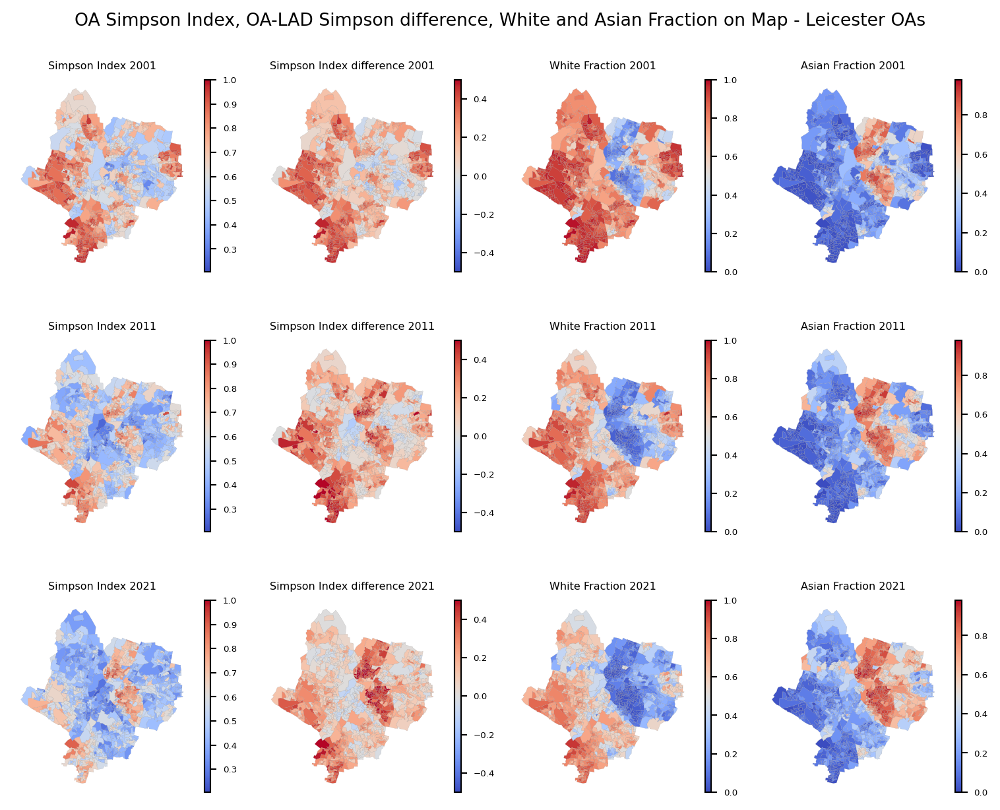

In [77]:
#| echo: false
#| label: fig-oaleicmap
#| fig-cap: OA Simpson Index, White and Asian Fraction and Asian Moran's I on Map - Leicester OAs

years = [2001, 2011, 2021]

oa_simpson_min, oa_simpson_max = leicester['OA_simpson'].min(), leicester['OA_simpson'].max()
white_fraction_min, white_fraction_max = leicester['white_fraction'].min(), leicester['white_fraction'].max()
asian_fraction_min, asian_fraction_max = leicester['asian_fraction'].min(), leicester['asian_fraction'].max()

# Reverse the colormap for the last column
fig, axes = plt.subplots(nrows=3, ncols=4, figsize=(8, 8))

# Flatten the axes array for easier iteration
axes = axes.flatten()

# Variables and titles for the plots
variables = [
    ('OA_simpson', oa_simpson_min, oa_simpson_max, 'Simpson Index', 'coolwarm'),
    ('simp_diff', -0.5,0.5, 'Simpson Index difference', 'coolwarm'),
    ('white_fraction', white_fraction_min, white_fraction_max, 'White Fraction', 'coolwarm'),
    ('asian_fraction', asian_fraction_min, asian_fraction_max, 'Asian Fraction', 'coolwarm'),
]

# Loop through years and variables to plot the maps
for j, year in enumerate(years):
    for i, (variable, min_val, max_val, title, cmap) in enumerate(variables):
        # Filter data for the given year
        data_year = leicester[leicester['year'] == year]

        # Determine the correct subplot index
        ax_index = j * 4 + i
        
        # Plot the variable
        ax = axes[ax_index]
        divider = make_axes_locatable(ax)
        cax = divider.append_axes("right", size="3.5%", pad=0.1)
        data_year.plot(column=variable, cmap=cmap, linewidth=0.05, ax=ax, edgecolor='0.5',
                       vmin=min_val, vmax=max_val, legend=False)
        # Manually create the colorbar
        norm = plt.Normalize(vmin=min_val, vmax=max_val)
        cbar = plt.colorbar(plt.cm.ScalarMappable(norm=norm, cmap=cmap), cax=cax)
        cbar.ax.tick_params(labelsize=5)

        ax.set_title(f'{title} {year}', fontsize=6)
        ax.axis('off')

fig.suptitle('OA Simpson Index, OA-LAD Simpson difference, White and Asian Fraction on Map - Leicester OAs', fontsize=10, y= 0.88)

# Adjust layout
plt.subplots_adjust(hspace=-0.3)
plt.tight_layout(rect=[0, 0, 1, 0.96])
plt.show()

### Leicester Map – LSOA Level
<p style="text-align: justify;">
@fig-lsoaleicmap shows the Simpson Index for each LSOA in Leicester and its difference from the town-wide Simpson Index. The same pattern observed in OAs can be seen in LSOAs. In the right-side column of the plot, the Asian Moran's I index for each LSOA is displayed. Based on the plot, the predominant value for the Asian Moran's I index is negative or close to zero, indicating no significant clustering or dispersion of the Asian population in OAs within LSOAs.
</p>


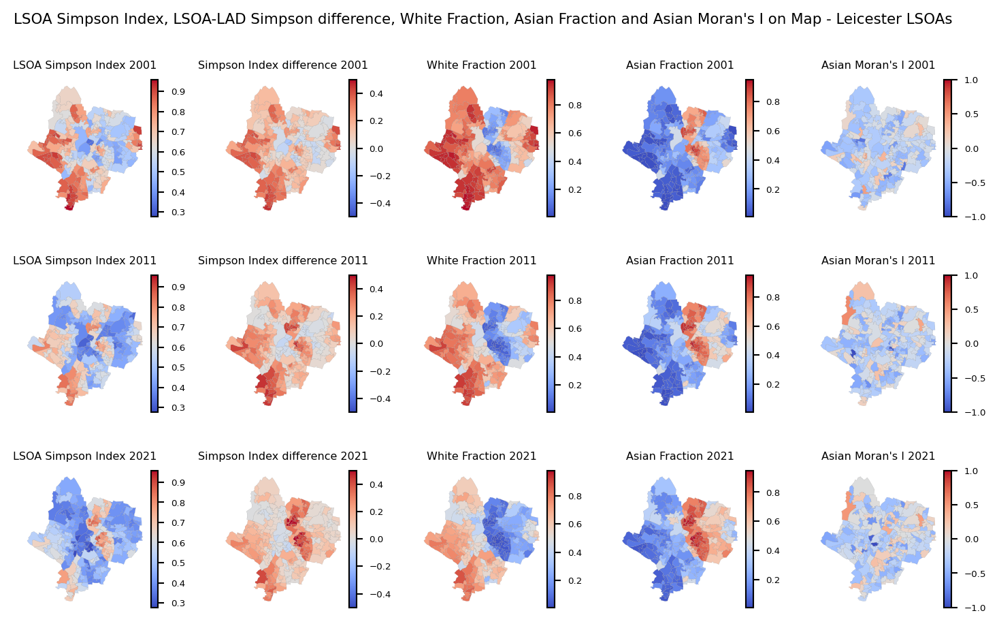

In [78]:
#| echo: false
#| label: fig-lsoaleicmap
#| fig-cap: LSOA Simpson Index, LSOA-LAD Simpson difference, White and Asian Fraction and Asian Moran's I on Map - Leicester LSOAs

years = [2001, 2011, 2021]

lsoa_simpson_min, lsoa_simpson_max = leicester_LSOA['LSOA_simpson'].min(), leicester_LSOA['LSOA_simpson'].max()
white_fraction_min, white_fraction_max = leicester_LSOA['white_fraction'].min(), leicester_LSOA['white_fraction'].max()
asian_fraction_min, asian_fraction_max = leicester_LSOA['asian_fraction'].min(), leicester_LSOA['asian_fraction'].max()

# Reverse the colormap for the last column
fig, axes = plt.subplots(nrows=3, ncols=5, figsize=(8, 8))

# Flatten the axes array for easier iteration
axes = axes.flatten()

# Variables and titles for the plots
variables = [
    ('LSOA_simpson', lsoa_simpson_min, lsoa_simpson_max, 'LSOA Simpson Index', 'coolwarm'),
    ('simp_diff', -0.5,0.5, 'Simpson Index difference', 'coolwarm'),
    ('white_fraction', white_fraction_min, white_fraction_max, 'White Fraction', 'coolwarm'),
    ('asian_fraction', asian_fraction_min, asian_fraction_max, 'Asian Fraction', 'coolwarm'),
    ('asian_moran', -1, 1, "Asian Moran's I", 'coolwarm')
    
]

# Loop through years and variables to plot the maps
for j, year in enumerate(years):
    for i, (variable, min_val, max_val, title, cmap) in enumerate(variables):
        # Filter data for the given year
        data_year = leicester_LSOA[leicester_LSOA['year'] == year]

        # Determine the correct subplot index
        ax_index = j * 5 + i
        
        # Plot the variable
        ax = axes[ax_index]
        divider = make_axes_locatable(ax)
        cax = divider.append_axes("right", size="3.5%", pad=-0.3)
        data_year.plot(column=variable, cmap=cmap, linewidth=0.05, ax=ax, edgecolor='0.5',
                       vmin=min_val, vmax=max_val, legend=False)

        # Manually create the colorbar
        norm = plt.Normalize(vmin=min_val, vmax=max_val)
        cbar = plt.colorbar(plt.cm.ScalarMappable(norm=norm, cmap=cmap), cax=cax)
        cbar.ax.tick_params(labelsize=5)

        ax.set_title(f'{title} {year}', fontsize=6)
        ax.axis('off')

fig.suptitle('LSOA Simpson Index, LSOA-LAD Simpson difference, White Fraction, Asian Fraction and Asian Moran\'s I on Map - Leicester LSOAs', 
             fontsize=8, y=0.78)

# Adjust layout
plt.subplots_adjust(hspace=-0.7)
plt.tight_layout(rect=[0, 0, 1, 0.96])
plt.show()

### Leicester Map – MSOA Level
<p style="text-align: justify;">
@fig-msoaleicmap shows the Simpson Index for each MSOA and its difference from the town-wide Simpson Index in Leicester. The same patterns observed in OAs and LSOAs are evident in MSOAs. This plot also includes the Asian and White Moran's I index for each MSOA, both calculated based on the OAs within them. By comparing the OA-based Moran's I index and the Asian/White fractions in @fig-oaleicmap, it is apparent that areas with a higher fraction of Asians or a lower fraction of White ethnicity have a positive and relatively high Moran's I index. This suggests that neighborhoods or areas within these MSOAs tend to have higher or lower concentrations of White and Asian populations, indicating significant clustering of these ethnicities.
</p>

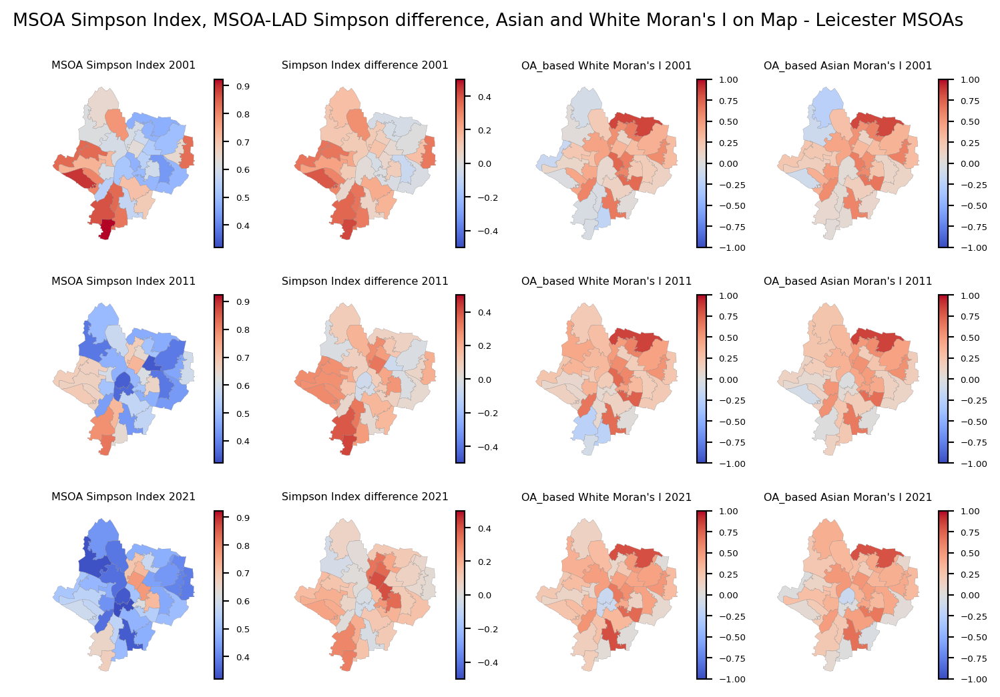

In [79]:
#| echo: false
#| label: fig-msoaleicmap
#| fig-cap: MSOA Simpson Index, MSOA-LAD Simpson difference, Asian and White Moran's I on Map - Leicester MSOAs

years = [2001, 2011, 2021]

msoa_simpson_min, msoa_simpson_max = leicester_MSOA['MSOA_simpson'].min(), leicester_MSOA['MSOA_simpson'].max()

# Reverse the colormap for the last column
fig, axes = plt.subplots(nrows=3, ncols=4, figsize=(8, 8))

# Flatten the axes array for easier iteration
axes = axes.flatten()

# Variables and titles for the plots
variables = [
    ('MSOA_simpson', msoa_simpson_min, msoa_simpson_max, 'MSOA Simpson Index', 'coolwarm'),
    ('simp_diff', -0.5,0.5, 'Simpson Index difference', 'coolwarm'),
    ('asian_moran_OA', -1, 1, "OA_based White Moran's I", 'coolwarm'),
    ('white_moran_OA', -1, 1, "OA_based Asian Moran's I", 'coolwarm')
    
    
]

# Loop through years and variables to plot the maps
for j, year in enumerate(years):
    for i, (variable, min_val, max_val, title, cmap) in enumerate(variables):
        # Filter data for the given year
        data_year = leicester_MSOA[leicester_MSOA['year'] == year]

        # Determine the correct subplot index
        ax_index = j * 4 + i
        
        # Plot the variable
        ax = axes[ax_index]
        divider = make_axes_locatable(ax)
        cax = divider.append_axes("right", size="3.5%", pad=-0.3)
        data_year.plot(column=variable, cmap=cmap, linewidth=0.1, ax=ax, edgecolor='0.5',
                       vmin=min_val, vmax=max_val, legend=False)

        # Manually create the colorbar
        norm = plt.Normalize(vmin=min_val, vmax=max_val)
        cbar = plt.colorbar(plt.cm.ScalarMappable(norm=norm, cmap=cmap), cax=cax)
        cbar.ax.tick_params(labelsize=5)

        ax.set_title(f'{title} {year}', fontsize=6)
        ax.axis('off')

fig.suptitle('MSOA Simpson Index, MSOA-LAD Simpson difference, Asian and White Moran\'s I on Map - Leicester MSOAs', 
             fontsize=10, y=0.82)

# Adjust layout
plt.subplots_adjust(hspace=-0.6)
plt.tight_layout(rect=[0, 0, 1, 0.96])
plt.show()

### Leicester Correlations Heatmap
<p style="text-align: justify;">
@fig-leicheatmap illustrates the linear correlation between the LSOA Simpson Index and the ethnicity fractions in each LSOA. As observed earlier, the White fraction was predominant (approximately twice as large as the Asian fraction) in 2001, and in the heatmap, it is evident that in this year, the LSOA Simpson Index has the strongest positive correlation with it. In 2011, the White ethnicity is still the largest among other ethnicities, but the Asian fraction increased, and the difference between the White and Asian fractions is less than 15%. Accordingly, the LSOA Simpson Index doesn't have a strong correlation with other variables in this year. In 2021, where the Asian fraction becomes predominant, the LSOA Simpson Index has a positive correlation with the Asian fraction and a negative correlation with the White fraction.
</p>

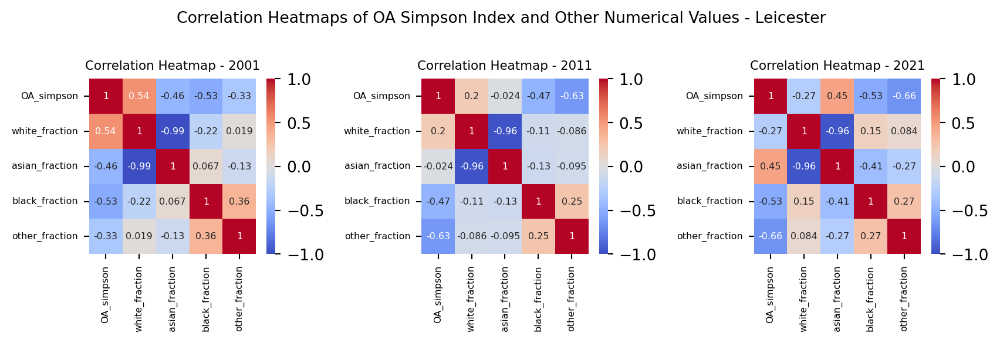

In [80]:
#| echo: false
#| label: fig-leicheatmap
#| fig-cap: Correlation Heatmap - Leicester
numerical_columns = ['OA_simpson', 'white_fraction', 'asian_fraction', 'black_fraction', 'other_fraction']

years = [2001, 2011, 2021]

correlation_dic = {}
for year in years:
    # Filter data for the specific year
    corr_df = leicester_OA[leicester_OA['year'] == year][numerical_columns]
    correlation_matrix = corr_df.corr()
    correlation_dic[year] = correlation_matrix

fig, axes = plt.subplots(1, 3, figsize=(9, 3))

# Plot each heatmap in a subplot
for i, year in enumerate(years):
    ax = axes[i]
    sns.heatmap(correlation_dic[year], annot=True, cmap='coolwarm', vmin=-1, vmax=1, ax=ax, annot_kws={"size": 6})
    ax.set_title(f'Correlation Heatmap - {year}', fontsize=8)
    ax.tick_params(axis='x', labelsize=6)
    ax.tick_params(axis='y', labelsize=6) 

# Adjust layout
plt.tight_layout(rect=[0, 0, 1, 0.96])
plt.suptitle('Correlation Heatmaps of OA Simpson Index and Other Numerical Values - Leicester',fontsize=10, y=1)
plt.tight_layout()
plt.show()


## Bradford
<p style="text-align: justify;" >
Bradford is the second city with largest population of Pakistanis (categorized in Asian ethnicity in this project) in England. As shown in @fig-bradethnicpop, Bradford's total population increased from 467,633 in 2001 to 546,416 in 2021. During this period, the population of the white ethnic group decreased from 366,039 to 333,985. This decrease is not noticeable compared to the increase of Asian Ethnic group, which increased from 90,360 in 2001 to 175,651 in 2021. In Bradford like Leicester, the growth rate of the Asian population is higher than that of the black and other ethnic groups. As depicted in @fig-bradfracoverview, the fraction of the white ethnic group decreased from 78.30% in 2001 to 40.10% in 2021 and the Asian fraction increases from 19.30% in 2001 to 32.10% in 2021.
</p>

In [81]:
#| include: false
bradford_indexes = LAD_total[LAD_total['LADNM'].str.contains('Bradford')].reset_index(drop= True)
bradford_indexes['total_population']= (bradford_indexes['white']+bradford_indexes['asian'] + 
                                        bradford_indexes['black']+bradford_indexes['other'])
cols = list(bradford_indexes.columns)
cols.insert(7, cols.pop(cols.index('total_population')))
bradford_indexes = bradford_indexes[cols]
bradford_indexes

,year,LADCD,LADNM,white,asian,black,other,total_population,white_frac,asian_frac,...,MSOA_white_mor,OA_asian_mor,LSOA_asian_mor,MSOA_asian_mor,OA_black_mor,LSOA_black_mor,MSOA_black_mor,OA_other_mor,LSOA_other_mor,MSOA_other_mor
0,2001,E08000032,Bradford,366039,90360,4323,6911,467633,0.783,0.193,...,0.614,0.810,0.777,0.594,0.413,0.643,0.678,0.277,0.463,0.538
1,2011,E08000032,Bradford,352317,140149,9267,20719,522452,0.674,0.268,...,0.654,0.856,0.810,0.615,0.555,0.680,0.637,0.518,0.571,0.632
2,2021,E08000032,Bradford,333985,175651,11005,25775,546416,0.611,0.321,...,0.666,0.876,0.820,0.629,0.496,0.671,0.701,0.489,0.654,0.714


In [82]:
#| include: false
# creating Bradford dataframe
bradford_2001= pd.read_csv('preprocessed files/2001/bradford_2001.csv')
bradford_2011= pd.read_csv('preprocessed files/2011/bradford_2011.csv')
bradford_2021= pd.read_csv('preprocessed files/2021/bradford_2021.csv')
bradford_2001['simp_diff'] = bradford_2001['OA_simpson']- bradford_indexes.LAD_simpson[0]
bradford_2011['simp_diff'] = bradford_2011['OA_simpson']- bradford_indexes.LAD_simpson[1]
bradford_2021['simp_diff'] = bradford_2021['OA_simpson']- bradford_indexes.LAD_simpson[2]

bradford_LSOA_2001= pd.read_csv('preprocessed files/2001/bradford_LSOA_2001.csv')
bradford_LSOA_2011= pd.read_csv('preprocessed files/2011/bradford_LSOA_2011.csv')
bradford_LSOA_2021= pd.read_csv('preprocessed files/2021/bradford_LSOA_2021.csv')
bradford_LSOA_2001['simp_diff'] = bradford_LSOA_2001['LSOA_simpson']- bradford_indexes.LAD_simpson[0]
bradford_LSOA_2011['simp_diff'] = bradford_LSOA_2011['LSOA_simpson']- bradford_indexes.LAD_simpson[1]
bradford_LSOA_2021['simp_diff'] = bradford_LSOA_2021['LSOA_simpson']- bradford_indexes.LAD_simpson[2]

bradford_MSOA_2001= pd.read_csv('preprocessed files/2001/bradford_MSOA_2001.csv')
bradford_MSOA_2011= pd.read_csv('preprocessed files/2011/bradford_MSOA_2011.csv')
bradford_MSOA_2021= pd.read_csv('preprocessed files/2021/bradford_MSOA_2021.csv')
bradford_MSOA_2001['simp_diff'] = bradford_MSOA_2001['MSOA_simpson']- bradford_indexes.LAD_simpson[0]
bradford_MSOA_2011['simp_diff'] = bradford_MSOA_2011['MSOA_simpson']- bradford_indexes.LAD_simpson[1]
bradford_MSOA_2021['simp_diff'] = bradford_MSOA_2021['MSOA_simpson']- bradford_indexes.LAD_simpson[2]

bradford= pd.concat([bradford_2001,bradford_2011,bradford_2021]).reset_index(drop=True)
bradford.insert(9, 'simp_diff', bradford.pop('simp_diff'))

# Converting the dataframe into GPD
bradford['geometry'] = bradford['geometry'].apply(wkt.loads)
bradford = gpd.GeoDataFrame(bradford, geometry='geometry')

bradford_center = {"lat": 53.8438, "lon": -1.8400}

In [83]:

#| include: false
# Creating df for OA level
bradford_OA = bradford.drop(['LSOACD', 'MSOACD', 'LADCD', 'LSOANM', 'MSOANM'], axis= 1)
bradford_OA = bradford_OA.set_crs(epsg=27700)
bradford_OA = bradford_OA.to_crs(epsg=4326)

In [84]:
#| include: false
# Creating df for LSOA level
bradford_LSOA= pd.concat([bradford_LSOA_2001,bradford_LSOA_2011,bradford_LSOA_2021]).reset_index(drop=True)
bradford_LSOA.insert(3, 'simp_diff', bradford_LSOA.pop('simp_diff'))

bradford_LSOA['geometry'] = bradford_LSOA['geometry'].apply(wkt.loads)
bradford_LSOA = gpd.GeoDataFrame(bradford_LSOA, geometry='geometry')

bradford_LSOA = bradford_LSOA.set_crs(epsg=27700)
bradford_LSOA = bradford_LSOA.to_crs(epsg=4326)

In [85]:
#| include: false
# Creating df for MSOA level
bradford_MSOA= pd.concat([bradford_MSOA_2001,bradford_MSOA_2011,bradford_MSOA_2021]).reset_index(drop=True)
bradford_MSOA.insert(3, 'simp_diff', bradford_MSOA.pop('simp_diff'))

bradford_MSOA['geometry'] = bradford_MSOA['geometry'].apply(wkt.loads)
bradford_MSOA = gpd.GeoDataFrame(bradford_MSOA, geometry='geometry')

bradford_MSOA = bradford_MSOA.set_crs(epsg=27700)
bradford_MSOA = bradford_MSOA.to_crs(epsg=4326)


In [86]:
#| echo: false
#| label: fig-bradethnicpop
#| fig-cap: Ethnicity and Total Population Line Chart - Bradford
# Ethnicity and Total Population Line Chart - Bradford

bradford_long= bradford_indexes[['year','white', 'asian', 'black', 'other']].melt(id_vars=['year'], 
                                                                                      var_name='ethnicity',
                                                                                      value_name='population',)

# Create subplots
fig = make_subplots(rows=2, cols=1, subplot_titles=("Ethnicity Population - Bradford", "Total Population - Bradford"),
                     vertical_spacing=0.15)

# Add traces for ethnicity populations
offsets = {
    'white': (10, 30),
    'asian': (10, -10),
    'black': (10, 30),
    'other': (10, -10)
}

for ethnicity in bradford_long['ethnicity'].unique():
    trace = go.Scatter(
        x=bradford_long[bradford_long['ethnicity'] == ethnicity]['year'],
        y=bradford_long[bradford_long['ethnicity'] == ethnicity]['population'],
        mode='lines+markers',
        name=ethnicity,
        legendgroup=ethnicity 
    )
    fig.add_trace(trace, row=1, col=1)
    
    # Add annotations with custom offsets for each ethnicity
    for i, row in bradford_long[bradford_long['ethnicity'] == ethnicity].iterrows():
        ax, ay = offsets.get(ethnicity, (0, 0)) 
        fig.add_annotation(
            x=row['year'],
            y=row['population'],
            text=f"{row['population']:,}",
            showarrow=True,
            arrowhead=0,
            ax=ax,
            ay=ay,
            font=dict(size=10),
            xanchor='center',
            yanchor='bottom',
            row=1,
            col=1
        )

# Add trace for total population in the second subplot
total_population_trace = go.Scatter(
    x=bradford_indexes['year'],
    y=bradford_indexes['total_population'],
    mode='lines+markers',
    name='Total Population',
    line=dict(color='black')
)
fig.add_trace(total_population_trace, row=2, col=1)

# Add annotations for total population
for i, row in bradford_indexes.iterrows():
    fig.add_annotation(
        x=row['year'],
        y=row['total_population'],
        text=f"{row['total_population']:,}",
        showarrow=True,
        arrowhead=0,
        ax=0,
        ay=-20,
        font=dict(size=10),
        xanchor='center',
        yanchor='bottom',
        row=2,
        col=1
    )

# Update x-axis and y-axis titles
fig.update_xaxes(title_text="Year", row=1, col=1)
fig.update_yaxes(title_text="Ethnicity Population", row=1, col=1)
fig.update_xaxes(title_text="Year", row=1, col=2)
fig.update_yaxes(title_text="Total Population", row=1, col=2)

# Update layout
fig.update_layout(
    height=700, 
    width=650, 
    title_text="Ethnicity and Total Population Line Chart - Bradford",
    title_x=0.5,
    title_y=0.96,
    showlegend=True,
    legend=dict(orientation="h", yanchor="top", y= 1.1, xanchor="center", x=0.5)
    )

# Display the figure
pyo.iplot(fig)

In [87]:
#| echo: false
#| label: fig-bradfracoverview
#| fig-cap: Ethnic Group Fractions Over Time - Bradford
# Ethnic Group Fractions Over Time - Bradford

fig = go.Figure()

# Add traces for each ethnic group fraction as stacked bars with percentage annotations outside
fig.add_trace(go.Bar(x=bradford_indexes['year'], y=bradford_indexes['white_frac'], 
                     name='White', legendgroup='ethnic_group', width=4, marker=dict(color='gray'),
                     text=bradford_indexes['white_frac'] * 100, textposition='outside', 
                     texttemplate='%{text:.2f}%'))
fig.add_trace(go.Bar(x=bradford_indexes['year'], y=bradford_indexes['asian_frac'], 
                     name='Asian', legendgroup='ethnic_group', width=4, marker=dict(color='orange'),
                     text=bradford_indexes['asian_frac'] * 100, textposition='outside', 
                     texttemplate='%{text:.2f}%'))
fig.add_trace(go.Bar(x=bradford_indexes['year'], y=bradford_indexes['black_frac'], 
                     name='Black', legendgroup='ethnic_group', width=4, marker=dict(color='black'),
                     text=bradford_indexes['black_frac'] * 100, textposition='outside', 
                     texttemplate='%{text:.2f}%'))
fig.add_trace(go.Bar(x=bradford_indexes['year'], y=bradford_indexes['other_frac'], 
                     name='Other', legendgroup='ethnic_group', width=4, marker=dict(color='green'),
                     text=bradford_indexes['other_frac'] * 100, textposition='inside', 
                     texttemplate='%{text:.2f}%'))

# Update layout
fig.update_layout(title_text="Ethnic Group Fractions Over Time - Bradford ",
                  title_x=0.5,
                  title_y=0.9,
                  title_font=dict(size=16),
                  xaxis_title='Year',
                  xaxis=dict(tickvals=[2001, 2011, 2021]),
                  yaxis_title='Ethnicity Fraction',
                  yaxis=dict(
                      title='Ethnicity Fraction',
                      side='left'),
                  barmode='relative',
                  hovermode='x unified',
                  width=600,
                  height=500,
                  legend=dict(orientation="h",
                              yanchor="top",
                              y=1.1,
                              xanchor="center",
                              x=0.5,
                              traceorder='normal'))

# Display the figure
pyo.iplot(fig)



In [88]:
#| include: false
# #| echo: false
# #| label: fig-bradsimp
# #| fig-cap: Simpson Index Line Chart - Bradford

# bradford_long= bradford_indexes[['year','OA_simpson', 'LSOA_simpson', 'MSOA_simpson', 'LAD_simpson']].melt(id_vars=['year'], var_name='level', value_name='simpson_index')

# traces = []
# for level in bradford_long['level'].unique():
#     trace = go.Scatter(
#         x= bradford_long[bradford_long['level'] == level]['year'],
#         y= bradford_long[bradford_long['level'] == level]['simpson_index'],
#         mode='lines+markers',
#         name=level
#     )
#     traces.append(trace)

# layout = go.Layout(title_text="Simpson Index Line Chart - Bradford",
#                     title_x=0.5,
#                     title_font=dict(size=16),
#                     xaxis=dict(title='Year', tickvals=bradford_long['year'].unique()),
#                     yaxis=dict(title='Simpson Index'),
#                     legend=dict(orientation="h",
#                                 yanchor="top",
#                                 y=1.2,
#                                 xanchor="center",
#                                 x=0.5),
#                     hovermode='closest',
#                     showlegend=True,
#                     height = 400,
#                     width = 700
# )


# fig = go.Figure(data=traces, layout=layout)

# pyo.iplot(fig)

In [89]:
#| include: false
# #| echo: false
# #| label: fig-bradoamap
# #| fig-cap: OA Simpson Index by Year in Bradford
# # OA Simpson Index by Year in Bradford

# fig = px.choropleth_mapbox(bradford_OA,
#                            geojson=bradford_OA.geometry,
#                            locations=bradford_OA.index,
#                            color='OA_simpson',
#                            animation_frame='year',
#                            color_continuous_scale=px.colors.diverging.RdBu[::-1],
#                            range_color=(0, 1),
#                            hover_name='OACD',
#                            hover_data={'white_fraction': True},
#                            labels={'OA_simpson': 'OA Simpson Index',
#                                    'white_fraction': 'White Fraction'},
#                            title='OA Simpson Index by Year in Bradford',
#                            center=bradford_center,
#                            zoom=9.9,
#                            mapbox_style='carto-positron'
#                            )

# # Customize the layout
# fig.update_layout(margin={"r":0,"t":40,"l":0,"b":0}, title_x=0.5,
#                   width=800,
#                   height=800 
#     )


# # Display the map
# fig.show()


In [90]:
#| include: false
# #| echo: false
# #| label: fig-bradlsoamap
# #| fig-cap: LSOA Simpson Index by Year in Bradford
# # LSOA Simpson Index by Year in Bradford

# fig = px.choropleth_mapbox(bradford_LSOA,
#                            geojson=bradford_LSOA.geometry,
#                            locations=bradford_LSOA.index,
#                            color='LSOA_simpson',
#                            animation_frame='year',
#                            color_continuous_scale=px.colors.diverging.RdBu[::-1],
#                            range_color=(0, 1),
#                            hover_name='LSOACD',
#                            hover_data={'white_fraction': True},
#                            labels={'LSOA_simpson': 'LSOA Simpson Index',
#                                    'white_fraction': 'White Fraction'},
#                            title='LSOA Simpson Index by Year in Bradford',
#                            center=bradford_center,
#                            zoom=9.9,
#                            mapbox_style='carto-positron'
#                            )

# # Customize the layout
# fig.update_layout(margin={"r":0,"t":40,"l":0,"b":0}, title_x=0.5,
#                   width=800,
#                   height=800 
#     )

# # Display the map
# fig.show()


In [91]:
#| include: false
# #| echo: false
# #| label: fig-bradmsoamap
# #| fig-cap: MSOA Simpson Index by Year in Bradford
# # mSOA Simpson Index by Year in Bradford

# fig = px.choropleth_mapbox(bradford_MSOA,
#                            geojson=bradford_MSOA.geometry,
#                            locations=bradford_MSOA.index,
#                            color='MSOA_simpson',
#                            animation_frame='year',
#                            color_continuous_scale=px.colors.diverging.RdBu[::-1],
#                            range_color=(0, 1),
#                            hover_name='MSOACD',
#                            hover_data={'white_fraction': True},
#                            labels={'MSOA_simpson': 'MSOA Simpson Index',
#                                    'white_fraction': 'White Fraction'},
#                            title='MSOA Simpson Index by Year in Bradford',
#                            center=bradford_center,
#                            zoom=9.9,
#                            mapbox_style='carto-positron'
#                            )

# # Customize the layout
# fig.update_layout(margin={"r":0,"t":40,"l":0,"b":0}, title_x=0.5,
#                   width=800,
#                   height=800 
#     )

# # Display the map
# fig.show()


In [92]:
#| include: false
# #| echo: false
# #| label: fig-bradlsoamormap
# #| fig-cap: Moran's I Index by Year in Bradford LSOAs
# # Moran's I Index by Year in Bradford LSOAs

# ethnicity = 'white'
# fig = px.choropleth_mapbox(bradford_LSOA,
#                            geojson=bradford_LSOA.geometry,
#                            locations=bradford_LSOA.index,
#                            color=f'{ethnicity}_moran',
#                            animation_frame='year',
#                            color_continuous_scale=px.colors.diverging.RdBu[::-1],
#                            range_color=(-1, 1),
#                            hover_name='LSOACD',
#                            hover_data={f'{ethnicity}_fraction': True},
#                            labels={f'{ethnicity}_moran': f'{ethnicity.capitalize()} Moran Index',
#                                    f'{ethnicity}_fraction': f'{ethnicity.capitalize()} Fraction'},
#                            title="Moran's I Index by Year in Bradford LSOAs",
#                            center=bradford_center,
#                            zoom=9.9,
#                            mapbox_style='carto-positron'
#                            )

# # Customize the layout
# fig.update_layout(margin={"r":0,"t":40,"l":0,"b":0}, title_x=0.5,
#                   width=800,
#                   height=800 
#     )

# # Display the map
# fig.show()




In [93]:
#| include: false
# #| echo: false
# #| label: fig-bradmsoamormapoa
# #| fig-cap: OA-based Moran's I Index by Year in Bradford MSOAs
# # OA-based Moran's I Index by Year in Bradford MSOAs
# ethnicity = 'white'
# fig = px.choropleth_mapbox(bradford_MSOA,
#                            geojson=bradford_MSOA.geometry,
#                            locations=bradford_MSOA.index,
#                            color=f'{ethnicity}_moran_OA',
#                            animation_frame='year',
#                            color_continuous_scale=px.colors.diverging.RdBu[::-1],
#                            range_color=(-1, 1),
#                            hover_name='MSOACD',
#                            hover_data={f'{ethnicity}_fraction': True},
#                            labels={f'{ethnicity}_moran_OA': f'OA-based {ethnicity.capitalize()} Moran Index',
#                                    f'{ethnicity}_fraction': f'{ethnicity.capitalize()} Fraction'},
#                            title="OA-based Moran's I Index by Year in Bradford MSOAs",
#                            center=bradford_center,
#                            zoom=9.9,
#                            mapbox_style='carto-positron'
#                            )

# # Customize the layout
# fig.update_layout(margin={"r":0,"t":40,"l":0,"b":0}, title_x=0.5,
#                   width=870,
#                   height=800 
#     )

# # Display the map
# fig.show()

In [94]:
#| include: false
# #| echo: false
# #| label: fig-bradmsoamormaplsoa
# #| fig-cap: LSOA-based Moran's I Index by Year in Bradford MSOAs
# # LSOA-based Moran's I Index by Year in Bradford MSOAs

# ethnicity = 'white'
# fig = px.choropleth_mapbox(bradford_MSOA,
#                            geojson=bradford_MSOA.geometry,
#                            locations=bradford_MSOA.index,
#                            color=f'{ethnicity}_moran_LSOA',
#                            animation_frame='year',
#                            color_continuous_scale=px.colors.diverging.RdBu[::-1],
#                            range_color=(-1, 1),
#                            hover_name='MSOACD',
#                            hover_data={f'{ethnicity}_fraction': True},
#                            labels={f'{ethnicity}_moran_LSOA': f'LSOA-based {ethnicity.capitalize()} Moran Index',
#                                    f'{ethnicity}_fraction': f'{ethnicity.capitalize()} Fraction'},
#                            title="LSOA-based Moran's I Index by Year in Bradford MSOAs",
#                            center=bradford_center,
#                            zoom=10,
#                            mapbox_style='carto-positron'
#                            )

# # Customize the layout
# fig.update_layout(margin={"r":0,"t":40,"l":0,"b":0}, title_x=0.5,
#                   width=950,
#                   height=800 
#     )

# # Display the map
# fig.show()

### Bradford Map – OA Level
<p style="text-align: justify;">
@fig-oabradmap shows the Simpson Index for each OA and its difference from the town-wide Simpson Index in Bradford. In the first column, which depicts the Simpson Index of OAs, the overall Simpson Index is decreasing, particularly around two points one in the center and another in the southeast of the city. As observed from the White and Asian fractions map, these points consist of less White fraction and more Asian fraction. By focusing on the second column of the plot, it is evident that the difference between the OA Simpson Index and the town-wide Simpson Index is increasing in Bradford. However, in areas where the OA Simpson Index was relatively low, this difference is negative or close to zero.
</p>

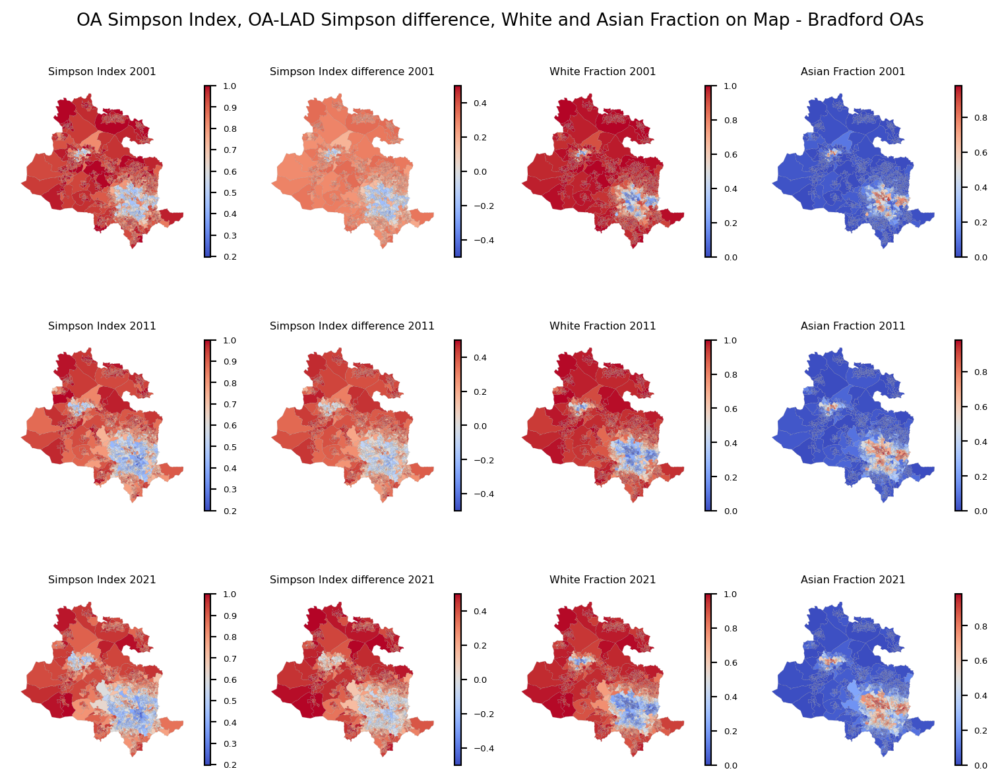

In [95]:
#| echo: false
#| label: fig-oabradmap
#| fig-cap: OA Simpson Index, White and Asian Fraction and Asian Moran's I on Map - Bradford OAs

years = [2001, 2011, 2021]

oa_simpson_min, oa_simpson_max = bradford['OA_simpson'].min(), bradford['OA_simpson'].max()
white_fraction_min, white_fraction_max = bradford['white_fraction'].min(), bradford['white_fraction'].max()
asian_fraction_min, asian_fraction_max = bradford['asian_fraction'].min(), bradford['asian_fraction'].max()

# Reverse the colormap for the last column
fig, axes = plt.subplots(nrows=3, ncols=4, figsize=(8, 8))

# Flatten the axes array for easier iteration
axes = axes.flatten()

# Variables and titles for the plots
variables = [
    ('OA_simpson', oa_simpson_min, oa_simpson_max, 'Simpson Index', 'coolwarm'),
    ('simp_diff', -0.5,0.5, 'Simpson Index difference', 'coolwarm'),
    ('white_fraction', white_fraction_min, white_fraction_max, 'White Fraction', 'coolwarm'),
    ('asian_fraction', asian_fraction_min, asian_fraction_max, 'Asian Fraction', 'coolwarm'),
]

# Loop through years and variables to plot the maps
for j, year in enumerate(years):
    for i, (variable, min_val, max_val, title, cmap) in enumerate(variables):
        # Filter data for the given year
        data_year = bradford[bradford['year'] == year]

        # Determine the correct subplot index
        ax_index = j * 4 + i
        
        # Plot the variable
        ax = axes[ax_index]
        divider = make_axes_locatable(ax)
        cax = divider.append_axes("right", size="3.5%", pad=0.1)
        data_year.plot(column=variable, cmap=cmap, linewidth=0.05, ax=ax, edgecolor='0.5',
                       vmin=min_val, vmax=max_val, legend=False)
        # Manually create the colorbar
        norm = plt.Normalize(vmin=min_val, vmax=max_val)
        cbar = plt.colorbar(plt.cm.ScalarMappable(norm=norm, cmap=cmap), cax=cax)
        cbar.ax.tick_params(labelsize=5)

        ax.set_title(f'{title} {year}', fontsize=6)
        ax.axis('off')

fig.suptitle('OA Simpson Index, OA-LAD Simpson difference, White and Asian Fraction on Map - Bradford OAs', fontsize=10, y= 0.87)

# Adjust layout
plt.subplots_adjust(hspace=-0.3)
plt.tight_layout(rect=[0, 0, 1, 0.96])
plt.show()

### Bradford Map – LSOA Level
<p style="text-align: justify;">
@fig-lsoabradmap shows the Simpson Index for each LSOA in Bradford and its difference from the town-wide Simpson Index. The same pattern observed in OAs can be seen in LSOAs. In the right-side column of the plot, the Asian Moran's I index for each LSOA is displayed. Based on the plot, the predominant value for the Asian Moran's I index is negative or close to zero, indicating no significant clustering or dispersion of the Asian population in OAs within LSOAs.
</p>

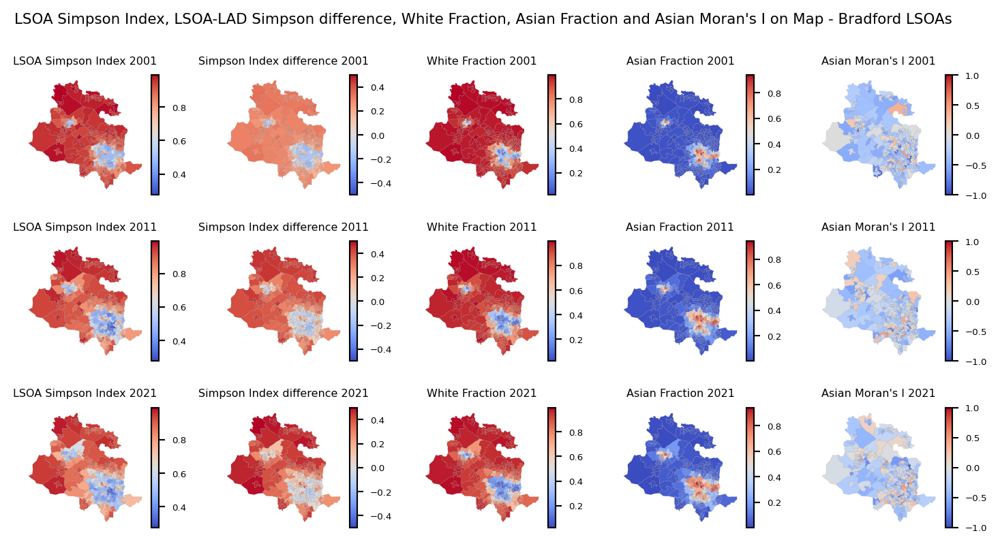

In [96]:
#| echo: false
#| label: fig-lsoabradmap
#| fig-cap: LSOA Simpson Index, White and Asian Fraction and Asian Moran's I on Map - Bradford LSOAs

years = [2001, 2011, 2021]

lsoa_simpson_min, lsoa_simpson_max = bradford_LSOA['LSOA_simpson'].min(), bradford_LSOA['LSOA_simpson'].max()
white_fraction_min, white_fraction_max = bradford_LSOA['white_fraction'].min(), bradford_LSOA['white_fraction'].max()
asian_fraction_min, asian_fraction_max = bradford_LSOA['asian_fraction'].min(), bradford_LSOA['asian_fraction'].max()

# Reverse the colormap for the last column
fig, axes = plt.subplots(nrows=3, ncols=5, figsize=(8, 8))

# Flatten the axes array for easier iteration
axes = axes.flatten()

# Variables and titles for the plots
variables = [
    ('LSOA_simpson', lsoa_simpson_min, lsoa_simpson_max, 'LSOA Simpson Index', 'coolwarm'),
    ('simp_diff', -0.5,0.5, 'Simpson Index difference', 'coolwarm'),
    ('white_fraction', white_fraction_min, white_fraction_max, 'White Fraction', 'coolwarm'),
    ('asian_fraction', asian_fraction_min, asian_fraction_max, 'Asian Fraction', 'coolwarm'),
    ('asian_moran', -1, 1, "Asian Moran's I", 'coolwarm')
    
]

# Loop through years and variables to plot the maps
for j, year in enumerate(years):
    for i, (variable, min_val, max_val, title, cmap) in enumerate(variables):
        # Filter data for the given year
        data_year = bradford_LSOA[bradford_LSOA['year'] == year]

        # Determine the correct subplot index
        ax_index = j * 5 + i
        
        # Plot the variable
        ax = axes[ax_index]
        divider = make_axes_locatable(ax)
        cax = divider.append_axes("right", size="3.5%", pad=-0.3)
        data_year.plot(column=variable, cmap=cmap, linewidth=0.05, ax=ax, edgecolor='0.5',
                       vmin=min_val, vmax=max_val, legend=True, cax=cax)

        # Manually create the colorbar
        norm = plt.Normalize(vmin=min_val, vmax=max_val)
        cbar = plt.colorbar(plt.cm.ScalarMappable(norm=norm, cmap=cmap), cax=cax)
        cbar.ax.tick_params(labelsize=5)

        ax.set_title(f'{title} {year}', fontsize=6)
        ax.axis('off')


fig.suptitle('LSOA Simpson Index, LSOA-LAD Simpson difference, White Fraction, Asian Fraction and Asian Moran\'s I on Map - Bradford LSOAs', 
             fontsize=8, y=0.74)

# Adjust layout
plt.subplots_adjust(hspace=-0.8)
plt.tight_layout(rect=[0, 0, 1, 0.96])
plt.show()


### Bradford Map – MSOA Level
<p style="text-align: justify;">
@fig-msoabradmap shows the Simpson Index for each MSOA and its difference from the town-wide Simpson Index in Bradford. The same patterns observed in OAs and LSOAs can be seen in MSOAs. Regarding the white and Asian Moran's I index of each MSOA, calculated both based on the OAs within them, the two areas with more Asian fraction and less white fraction have positive indices, indicating significant clustering of these ethnicities.
</p>

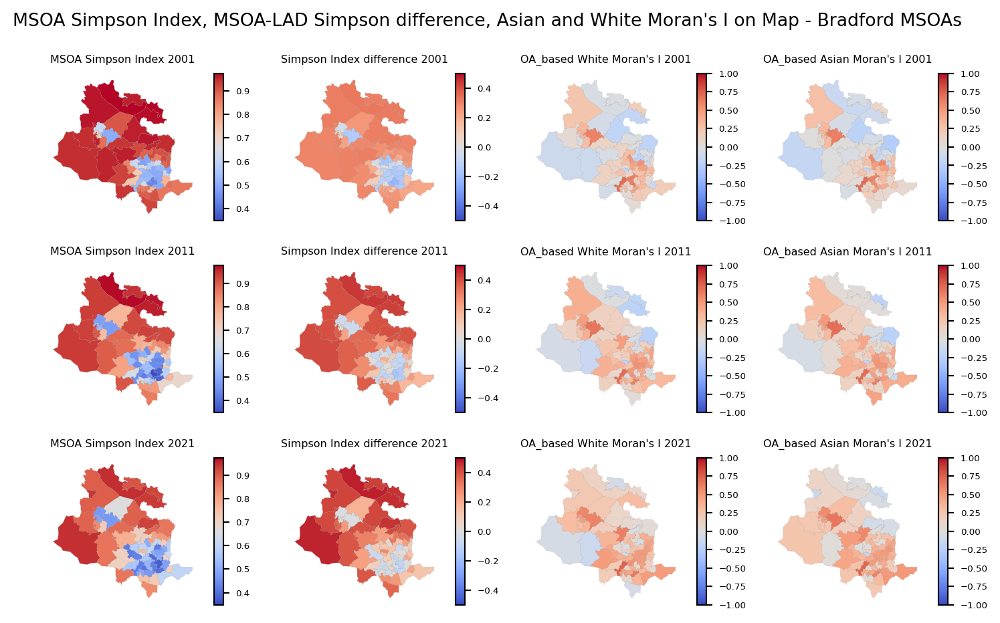

In [97]:
#| echo: false
#| label: fig-msoabradmap
#| fig-cap: MSOA Simpson Index, MSOA-LAD Simpson difference, Asian and White Moran\'s I on Map - Bradford MSOAs

years = [2001, 2011, 2021]

msoa_simpson_min, msoa_simpson_max = bradford_MSOA['MSOA_simpson'].min(), bradford_MSOA['MSOA_simpson'].max()

# Reverse the colormap for the last column
fig, axes = plt.subplots(nrows=3, ncols=4, figsize=(8, 8))

# Flatten the axes array for easier iteration
axes = axes.flatten()

# Variables and titles for the plots
variables = [
    ('MSOA_simpson', msoa_simpson_min, msoa_simpson_max, 'MSOA Simpson Index', 'coolwarm'),
    ('simp_diff', -0.5,0.5, 'Simpson Index difference', 'coolwarm'),
    ('asian_moran_OA', -1, 1, "OA_based White Moran's I", 'coolwarm'),
    ('white_moran_OA', -1, 1, "OA_based Asian Moran's I", 'coolwarm')
    
    
]

# Loop through years and variables to plot the maps
for j, year in enumerate(years):
    for i, (variable, min_val, max_val, title, cmap) in enumerate(variables):
        # Filter data for the given year
        data_year = bradford_MSOA[bradford_MSOA['year'] == year]

        # Determine the correct subplot index
        ax_index = j * 4 + i
        
        # Plot the variable
        ax = axes[ax_index]
        divider = make_axes_locatable(ax)
        cax = divider.append_axes("right", size="3.5%", pad=-0.3)
        data_year.plot(column=variable, cmap=cmap, linewidth=0.05, ax=ax, edgecolor='0.5',
                       vmin=min_val, vmax=max_val, legend=False)

        # Manually create the colorbar
        norm = plt.Normalize(vmin=min_val, vmax=max_val)
        cbar = plt.colorbar(plt.cm.ScalarMappable(norm=norm, cmap=cmap), cax=cax)
        cbar.ax.tick_params(labelsize=5)

        ax.set_title(f'{title} {year}', fontsize=6)
        ax.axis('off')

fig.suptitle('MSOA Simpson Index, MSOA-LAD Simpson difference, Asian and White Moran\'s I on Map - Bradford MSOAs', 
             fontsize=10, y=0.78)

# Adjust layout
plt.subplots_adjust(hspace=-0.7)
plt.tight_layout(rect=[0, 0, 1, 0.96])
plt.show()

### Bradford Correlations Heatmap
<p style="text-align: justify;">
@fig-bradheatmap illustrates the linear correlation between the LSOA Simpson Index and the ethnicity fractions in each LSOA. As can be observed, by decreasing the white fraction, the correlation between it and LSOA Simpson Index decreases.
</p>

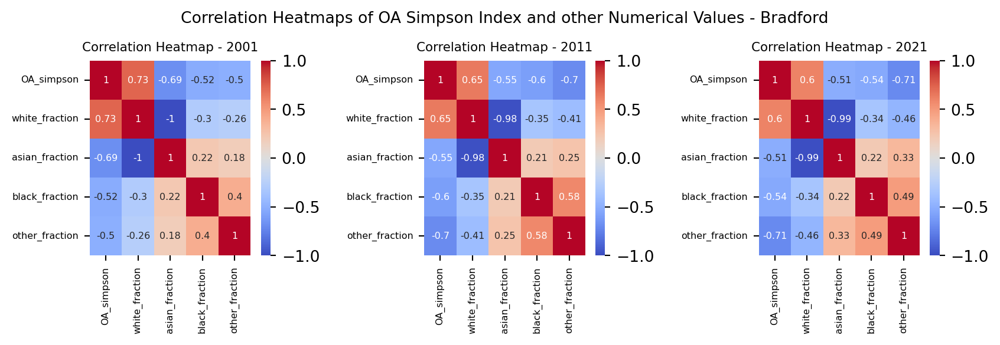

In [98]:
#| echo: false
#| label: fig-bradheatmap
#| fig-cap: Correlation Heatmap - Bradford
numerical_columns = ['OA_simpson', 'white_fraction', 'asian_fraction', 'black_fraction', 'other_fraction']

years = [2001, 2011, 2021]

correlation_dic = {}
for year in years:
    # Filter data for the specific year
    corr_df = bradford_OA[bradford_OA['year'] == year][numerical_columns]
    correlation_matrix = corr_df.corr()
    correlation_dic[year] = correlation_matrix

fig, axes = plt.subplots(1, 3, figsize=(9, 3))

# Plot each heatmap in a subplot
for i, year in enumerate(years):
    ax = axes[i]
    sns.heatmap(correlation_dic[year], annot=True, cmap='coolwarm', vmin=-1, vmax=1, ax=ax, annot_kws={"size": 6})
    ax.set_title(f'Correlation Heatmap - {year}', fontsize=8)
    ax.tick_params(axis='x', labelsize=6)
    ax.tick_params(axis='y', labelsize=6) 

# Adjust layout
plt.tight_layout(rect=[0, 0, 1, 0.96])
plt.suptitle('Correlation Heatmaps of OA Simpson Index and other Numerical Values - Bradford',fontsize=10,  y=1)
plt.show()

## Blackburn with Darwen
<p style="text-align: justify;" >
Blackburn is an industrial town in the west of England. As shown in @fig-blbnethnicpop, Blackburn's total population increased from 137,446 in 2011 to 154,761 in 2021. During this period, the population of the white ethnic group decreased 107,113 in 2001 to 93,408 while the Asian Ethnic group population increased from 28,736 in 2001 to 55,174 in 2021. In Blackburn like Leicester, the growth rate of the Asian population is higher than that of the black and other ethnic groups. As depicted in @fig-blbnfracoverview, in 2021, 60.4% of people in Blackburn with Darwen identified their ethnic group within the White category (compared with 69.2% in 2011), while 35.7% identified their ethnic group within the Asian category (compared with 28.1% the previous decade).
</p>

In [99]:
#| include: false
blackburn_indexes = LAD_total[LAD_total['LADNM'].str.contains('Blackburn')].reset_index(drop= True)
blackburn_indexes['total_population']= (blackburn_indexes['white']+blackburn_indexes['asian'] + 
                                        blackburn_indexes['black']+blackburn_indexes['other'])
cols = list(blackburn_indexes.columns)
cols.insert(7, cols.pop(cols.index('total_population')))
blackburn_indexes = blackburn_indexes[cols]
blackburn_indexes

,year,LADCD,LADNM,white,asian,black,other,total_population,white_frac,asian_frac,...,MSOA_white_mor,OA_asian_mor,LSOA_asian_mor,MSOA_asian_mor,OA_black_mor,LSOA_black_mor,MSOA_black_mor,OA_other_mor,LSOA_other_mor,MSOA_other_mor
0,2001,E06000008,Blackburn with Darwen,107113,28736,303,1294,137446,0.779,0.209,...,0.450,0.816,0.665,0.443,0.075,0.229,0.360,0.149,0.251,0.527
1,2011,E06000008,Blackburn with Darwen,102009,41494,933,3053,147489,0.692,0.281,...,0.555,0.867,0.757,0.546,0.210,0.293,0.357,0.328,0.498,0.538
2,2021,E06000008,Blackburn with Darwen,93408,55174,1397,4782,154761,0.604,0.357,...,0.644,0.901,0.828,0.624,0.359,0.350,0.174,0.352,0.477,0.666


In [100]:
#| include: false
# creating Blackburn dataframe
blackburn_2001= pd.read_csv('preprocessed files/2001/blackburn_2001.csv')
blackburn_2011= pd.read_csv('preprocessed files/2011/blackburn_2011.csv')
blackburn_2021= pd.read_csv('preprocessed files/2021/blackburn_2021.csv')
blackburn_2001['simp_diff'] = blackburn_2001['OA_simpson']- blackburn_indexes.LAD_simpson[0]
blackburn_2011['simp_diff'] = blackburn_2011['OA_simpson']- blackburn_indexes.LAD_simpson[1]
blackburn_2021['simp_diff'] = blackburn_2021['OA_simpson']- blackburn_indexes.LAD_simpson[2]

blackburn_LSOA_2001= pd.read_csv('preprocessed files/2001/blackburn_LSOA_2001.csv')
blackburn_LSOA_2011= pd.read_csv('preprocessed files/2011/blackburn_LSOA_2011.csv')
blackburn_LSOA_2021= pd.read_csv('preprocessed files/2021/blackburn_LSOA_2021.csv')
blackburn_LSOA_2001['simp_diff'] = blackburn_LSOA_2001['LSOA_simpson']- blackburn_indexes.LAD_simpson[0]
blackburn_LSOA_2011['simp_diff'] = blackburn_LSOA_2011['LSOA_simpson']- blackburn_indexes.LAD_simpson[1]
blackburn_LSOA_2021['simp_diff'] = blackburn_LSOA_2021['LSOA_simpson']- blackburn_indexes.LAD_simpson[2]

blackburn_MSOA_2001= pd.read_csv('preprocessed files/2001/blackburn_MSOA_2001.csv')
blackburn_MSOA_2011= pd.read_csv('preprocessed files/2011/blackburn_MSOA_2011.csv')
blackburn_MSOA_2021= pd.read_csv('preprocessed files/2021/blackburn_MSOA_2021.csv')
blackburn_MSOA_2001['simp_diff'] = blackburn_MSOA_2001['MSOA_simpson']- blackburn_indexes.LAD_simpson[0]
blackburn_MSOA_2011['simp_diff'] = blackburn_MSOA_2011['MSOA_simpson']- blackburn_indexes.LAD_simpson[1]
blackburn_MSOA_2021['simp_diff'] = blackburn_MSOA_2021['MSOA_simpson']- blackburn_indexes.LAD_simpson[2]

blackburn= pd.concat([blackburn_2001,blackburn_2011,blackburn_2021]).reset_index(drop=True)
blackburn.insert(9, 'simp_diff', blackburn.pop('simp_diff'))

# Converting the dataframe into GPD
blackburn['geometry'] = blackburn['geometry'].apply(wkt.loads)
blackburn = gpd.GeoDataFrame(blackburn, geometry='geometry')

blackburn_center = {"lat": 53.6958, "lon": -2.4683}

In [101]:
#| include: false
blackburn_2001.head()
#| include: false
# Creating df for OA level
blackburn_OA = blackburn.drop(['LSOACD', 'MSOACD', 'LADCD', 'LSOANM', 'MSOANM'], axis= 1)
blackburn_OA = blackburn_OA.set_crs(epsg=27700)
blackburn_OA = blackburn_OA.to_crs(epsg=4326)  

In [102]:
#| include: false
# Creating df for LSOA level
blackburn_LSOA= pd.concat([blackburn_LSOA_2001,blackburn_LSOA_2011,blackburn_LSOA_2021]).reset_index(drop=True)
blackburn_LSOA.insert(3, 'simp_diff', blackburn_LSOA.pop('simp_diff'))

blackburn_LSOA['geometry'] = blackburn_LSOA['geometry'].apply(wkt.loads)
blackburn_LSOA = gpd.GeoDataFrame(blackburn_LSOA, geometry='geometry')

blackburn_LSOA = blackburn_LSOA.set_crs(epsg=27700)
blackburn_LSOA = blackburn_LSOA.to_crs(epsg=4326)

In [103]:
#| include: false
# Creating df for MSOA level
blackburn_MSOA= pd.concat([blackburn_MSOA_2001,blackburn_MSOA_2011,blackburn_MSOA_2021]).reset_index(drop=True)
blackburn_MSOA.insert(3, 'simp_diff', blackburn_MSOA.pop('simp_diff'))

blackburn_MSOA['geometry'] = blackburn_MSOA['geometry'].apply(wkt.loads)
blackburn_MSOA = gpd.GeoDataFrame(blackburn_MSOA, geometry='geometry')

blackburn_MSOA = blackburn_MSOA.set_crs(epsg=27700)
blackburn_MSOA = blackburn_MSOA.to_crs(epsg=4326)

In [104]:
#| echo: false
#| label: fig-blbnethnicpop
#| fig-cap: Ethnicity and Total Population Line Chart - Blackburn
# Ethnicity and Total Population Line Chart - Blackburn

blackburn_long= blackburn_indexes[['year','white', 'asian', 'black', 'other']].melt(id_vars=['year'], 
                                                                                      var_name='ethnicity',
                                                                                      value_name='population',)

# Create subplots
fig = make_subplots(rows=2, cols=1, subplot_titles=("Ethnicity Population - Blackburn", "Total Population - Blackburn"),
                     vertical_spacing=0.15)

# Add traces for ethnicity populations
offsets = {
    'white': (10, 30),
    'asian': (10, -10),
    'black': (10, 30),
    'other': (10, -10)
}

for ethnicity in blackburn_long['ethnicity'].unique():
    trace = go.Scatter(
        x=blackburn_long[blackburn_long['ethnicity'] == ethnicity]['year'],
        y=blackburn_long[blackburn_long['ethnicity'] == ethnicity]['population'],
        mode='lines+markers',
        name=ethnicity,
        legendgroup=ethnicity 
    )
    fig.add_trace(trace, row=1, col=1)
    
    # Add annotations with custom offsets for each ethnicity
    for i, row in blackburn_long[blackburn_long['ethnicity'] == ethnicity].iterrows():
        ax, ay = offsets.get(ethnicity, (0, 0)) 
        fig.add_annotation(
            x=row['year'],
            y=row['population'],
            text=f"{row['population']:,}",
            showarrow=True,
            arrowhead=0,
            ax=ax,
            ay=ay,
            font=dict(size=10),
            xanchor='center',
            yanchor='bottom',
            row=1,
            col=1
        )

# Add trace for total population in the second subplot
total_population_trace = go.Scatter(
    x=blackburn_indexes['year'],
    y=blackburn_indexes['total_population'],
    mode='lines+markers',
    name='Total Population',
    line=dict(color='black')
)
fig.add_trace(total_population_trace, row=2, col=1)

# Add annotations for total population
for i, row in blackburn_indexes.iterrows():
    fig.add_annotation(
        x=row['year'],
        y=row['total_population'],
        text=f"{row['total_population']:,}",
        showarrow=True,
        arrowhead=0,
        ax=0,
        ay=-20,
        font=dict(size=10),
        xanchor='center',
        yanchor='bottom',
        row=2,
        col=1
    )

# Update x-axis and y-axis titles
fig.update_xaxes(title_text="Year", row=1, col=1)
fig.update_yaxes(title_text="Ethnicity Population", row=1, col=1)
fig.update_xaxes(title_text="Year", row=1, col=2)
fig.update_yaxes(title_text="Total Population", row=1, col=2)

# Update layout
fig.update_layout(
    height=700, 
    width=650, 
    title_text="Ethnicity and Total Population Line Chart - Blackburn",
    title_x=0.5,
    title_y=0.96,
    showlegend=True,
    legend=dict(orientation="h", yanchor="top", y= 1.1, xanchor="center", x=0.5)
    )

# Display the figure
pyo.iplot(fig)

In [105]:
#| echo: false
#| label: fig-blbnfracoverview
#| fig-cap: Ethnic Group Fractions Over Time - Blackburn
# Ethnic Group Fractions Over Time - Blackburn

fig = go.Figure()

# Add traces for each ethnic group fraction as stacked bars with percentage annotations outside
fig.add_trace(go.Bar(x=blackburn_indexes['year'], y=blackburn_indexes['white_frac'], 
                     name='White', legendgroup='ethnic_group', width=4, marker=dict(color='gray'),
                     text=blackburn_indexes['white_frac'] * 100, textposition='outside', 
                     texttemplate='%{text:.2f}%'))
fig.add_trace(go.Bar(x=blackburn_indexes['year'], y=blackburn_indexes['asian_frac'], 
                     name='Asian', legendgroup='ethnic_group', width=4, marker=dict(color='orange'),
                     text=blackburn_indexes['asian_frac'] * 100, textposition='outside', 
                     texttemplate='%{text:.2f}%'))
fig.add_trace(go.Bar(x=blackburn_indexes['year'], y=blackburn_indexes['black_frac'], 
                     name='Black', legendgroup='ethnic_group', width=4, marker=dict(color='black'),
                     text=blackburn_indexes['black_frac'] * 100, textposition='outside', 
                     texttemplate='%{text:.2f}%'))
fig.add_trace(go.Bar(x=blackburn_indexes['year'], y=blackburn_indexes['other_frac'], 
                     name='Other', legendgroup='ethnic_group', width=4, marker=dict(color='green'),
                     text=blackburn_indexes['other_frac'] * 100, textposition='inside', 
                     texttemplate='%{text:.2f}%'))

# Update layout
fig.update_layout(title_text="Ethnic Group Fractions Over Time - Blackburn ",
                  title_x=0.5,
                  title_y=0.9,
                  title_font=dict(size=16),
                  xaxis_title='Year',
                  xaxis=dict(tickvals=[2001, 2011, 2021]),
                  yaxis_title='Ethnicity Fraction',
                  yaxis=dict(
                      title='Ethnicity Fraction',
                      side='left'),
                  barmode='relative',
                  hovermode='x unified',
                  width=600,
                  height=500,
                  legend=dict(orientation="h",
                              yanchor="top",
                              y=1.1,
                              xanchor="center",
                              x=0.5,
                              traceorder='normal'))

# Display the figure
pyo.iplot(fig)


In [106]:
#| include: false
# #| echo: false
# #| label: fig-blbnsimp
# #| fig-cap: Simpson Index Line Chart - Blackburn

# blackburn_long= blackburn_indexes[['year','OA_simpson', 'LSOA_simpson', 'MSOA_simpson', 'LAD_simpson']].melt(id_vars=['year'], var_name='level', value_name='simpson_index')

# traces = []
# for level in blackburn_long['level'].unique():
#     trace = go.Scatter(
#         x= blackburn_long[blackburn_long['level'] == level]['year'],
#         y= blackburn_long[blackburn_long['level'] == level]['simpson_index'],
#         mode='lines+markers',
#         name=level
#     )
#     traces.append(trace)

# layout = go.Layout(title_text="Simpson Index Line Chart - Blackburn",
#                     title_x=0.5,
#                     title_font=dict(size=16),
#                     xaxis=dict(title='Year', tickvals=blackburn_long['year'].unique()),
#                     yaxis=dict(title='Simpson Index'),
#                     legend=dict(orientation="h",
#                                 yanchor="top",
#                                 y=1.2,
#                                 xanchor="center",
#                                 x=0.5),
#                     hovermode='closest',
#                     showlegend=True,
#                     height = 400,
#                     width = 700
# )


# fig = go.Figure(data=traces, layout=layout)

# pyo.iplot(fig)

In [107]:
#| include: false
# #| echo: false
# #| label: fig-blbnoamap
# #| fig-cap: OA Simpson Index by Year in Blackburn
# # OA Simpson Index by Year in Blackburn

# fig = px.choropleth_mapbox(blackburn_OA,
#                            geojson=blackburn_OA.geometry,
#                            locations=blackburn_OA.index,
#                            color='OA_simpson',
#                            animation_frame='year',
#                            color_continuous_scale=px.colors.diverging.RdBu[::-1],
#                            range_color=(0, 1),
#                            hover_name='OACD',
#                            hover_data={'white_fraction': True},
#                            labels={'OA_simpson': 'OA Simpson Index',
#                                    'white_fraction': 'White Fraction'},
#                            title='OA Simpson Index by Year in Blackburn',
#                            center=blackburn_center,
#                            zoom=10,
#                            mapbox_style='carto-positron'
#                            )

# # Customize the layout
# fig.update_layout(margin={"r":0,"t":40,"l":0,"b":0}, title_x=0.5,
#                   width=800,
#                   height=800 
#     )


# # Display the map
# fig.show()

In [108]:
#| include: false
# #| echo: false
# #| label: fig-blbnlsoamap
# #| fig-cap: LSOA Simpson Index by Year in Blackburn
# # LSOA Simpson Index by Year in Blackburn

# fig = px.choropleth_mapbox(blackburn_LSOA,
#                            geojson=blackburn_LSOA.geometry,
#                            locations=blackburn_LSOA.index,
#                            color='LSOA_simpson',
#                            animation_frame='year',
#                            color_continuous_scale=px.colors.diverging.RdBu[::-1],
#                            range_color=(0, 1),
#                            hover_name='LSOACD',
#                            hover_data={'white_fraction': True},
#                            labels={'LSOA_simpson': 'LSOA Simpson Index',
#                                    'white_fraction': 'White Fraction'},
#                            title='LSOA Simpson Index by Year in Blackburn',
#                            center=blackburn_center,
#                            zoom=10,
#                            mapbox_style='carto-positron'
#                            )

# # Customize the layout
# fig.update_layout(margin={"r":0,"t":40,"l":0,"b":0}, title_x=0.5,
#                   width=800,
#                   height=800 
#     )

# # Display the map
# fig.show()

In [109]:
#| include: false
# #| echo: false
# #| label: fig-blbnmsoamap
# #| fig-cap: MSOA Simpson Index by Year in Blackburn
# # MSOA Simpson Index by Year in Blackburn

# fig = px.choropleth_mapbox(blackburn_MSOA,
#                            geojson=blackburn_MSOA.geometry,
#                            locations=blackburn_MSOA.index,
#                            color='MSOA_simpson',
#                            animation_frame='year',
#                            color_continuous_scale=px.colors.diverging.RdBu[::-1],
#                            range_color=(0, 1),
#                            hover_name='MSOACD',
#                            hover_data={'white_fraction': True},
#                            labels={'MSOA_simpson': 'MSOA Simpson Index',
#                                    'white_fraction': 'White Fraction'},
#                            title='MSOA Simpson Index by Year in Blackburn',
#                            center=blackburn_center,
#                            zoom=10,
#                            mapbox_style='carto-positron'
#                            )

# # Customize the layout
# fig.update_layout(margin={"r":0,"t":40,"l":0,"b":0}, title_x=0.5,
#                   width=800,
#                   height=800 
#     )

# # Display the map
# fig.show()



In [110]:
#| include: false
# #| echo: false
# #| label: fig-blbnlsoamormap
# #| fig-cap: Moran's I Index by Year in Blackburn LSOAs
# # Moran's I Index by Year in Blackburn LSOAs

# ethnicity = 'white'
# fig = px.choropleth_mapbox(blackburn_LSOA,
#                            geojson=blackburn_LSOA.geometry,
#                            locations=blackburn_LSOA.index,
#                            color=f'{ethnicity}_moran',
#                            animation_frame='year',
#                            color_continuous_scale=px.colors.diverging.RdBu[::-1],
#                            range_color=(-1, 1),
#                            hover_name='LSOACD',
#                            hover_data={f'{ethnicity}_fraction': True},
#                            labels={f'{ethnicity}_moran': f'{ethnicity.capitalize()} Moran Index',
#                                    f'{ethnicity}_fraction': f'{ethnicity.capitalize()} Fraction'},
#                            title="Moran's I Index by Year in Blackburn LSOAs",
#                            center=blackburn_center,
#                            zoom=10,
#                            mapbox_style='carto-positron'
#                            )

# # Customize the layout
# fig.update_layout(margin={"r":0,"t":40,"l":0,"b":0}, title_x=0.5,
#                   width=800,
#                   height=800 
#     )

# # Display the map
# fig.show()

In [111]:
#| include: false
# #| echo: false
# #| label: fig-blbnmsoamormapoa
# #| fig-cap: OA-based Moran's I Index by Year in Blackburn MSOAs
# # OA-based Moran's I Index by Year in Blackburn MSOAs
# ethnicity = 'white'
# fig = px.choropleth_mapbox(blackburn_MSOA,
#                            geojson=blackburn_MSOA.geometry,
#                            locations=blackburn_MSOA.index,
#                            color=f'{ethnicity}_moran_OA',
#                            animation_frame='year',
#                            color_continuous_scale=px.colors.diverging.RdBu[::-1],
#                            range_color=(-1, 1),
#                            hover_name='MSOACD',
#                            hover_data={f'{ethnicity}_fraction': True},
#                            labels={f'{ethnicity}_moran_OA': f'OA-based {ethnicity.capitalize()} Moran Index',
#                                    f'{ethnicity}_fraction': f'{ethnicity.capitalize()} Fraction'},
#                            title="OA-based Moran's I Index by Year in Blackburn MSOAs",
#                            center=blackburn_center,
#                            zoom=10,
#                            mapbox_style='carto-positron'
#                            )

# # Customize the layout
# fig.update_layout(margin={"r":0,"t":40,"l":0,"b":0}, title_x=0.5,
#                   width=870,
#                   height=800 
#     )

# # Display the map
# fig.show()

In [112]:
# #| echo: false
# #| label: fig-blbnmsoamormaplsoa
# #| fig-cap: LSOA-based Moran's I Index by Year in Blackburn MSOAs
# # LSOA-based Moran's I Index by Year in Blackburn MSOAs

# ethnicity = 'white'
# fig = px.choropleth_mapbox(blackburn_MSOA,
#                            geojson=blackburn_MSOA.geometry,
#                            locations=blackburn_MSOA.index,
#                            color=f'{ethnicity}_moran_LSOA',
#                            animation_frame='year',
#                            color_continuous_scale=px.colors.diverging.RdBu[::-1],
#                            range_color=(-1, 1),
#                            hover_name='MSOACD',
#                            hover_data={f'{ethnicity}_fraction': True},
#                            labels={f'{ethnicity}_moran_LSOA': f'LSOA-based {ethnicity.capitalize()} Moran Index',
#                                    f'{ethnicity}_fraction': f'{ethnicity.capitalize()} Fraction'},
#                            title="LSOA-based Moran's I Index by Year in Blackburn MSOAs",
#                            center=blackburn_center,
#                            zoom=10,
#                            mapbox_style='carto-positron'
#                            )

# # Customize the layout
# fig.update_layout(margin={"r":0,"t":40,"l":0,"b":0}, title_x=0.5,
#                   width=950,
#                   height=800 
#     )

# # Display the map
# fig.show()

### Blackburn with Darwen Map – OA Level
<p style="text-align: justify;">
@fig-oablbnmap shows the Simpson Index for each OA and its difference from the town-wide Simpson Index in Blackburn with Darwen. As observed in other cities, the Simpson Index in Blackburn is generally decreasing, while its difference from the town-wide Simpson Index is increasing. The OAs in the northern part of the city have the lowest Simpson Index. By comparing this map with the fraction maps, it is evident that this is where the White fraction is the smallest and the Asian fraction is the largest.
</p>

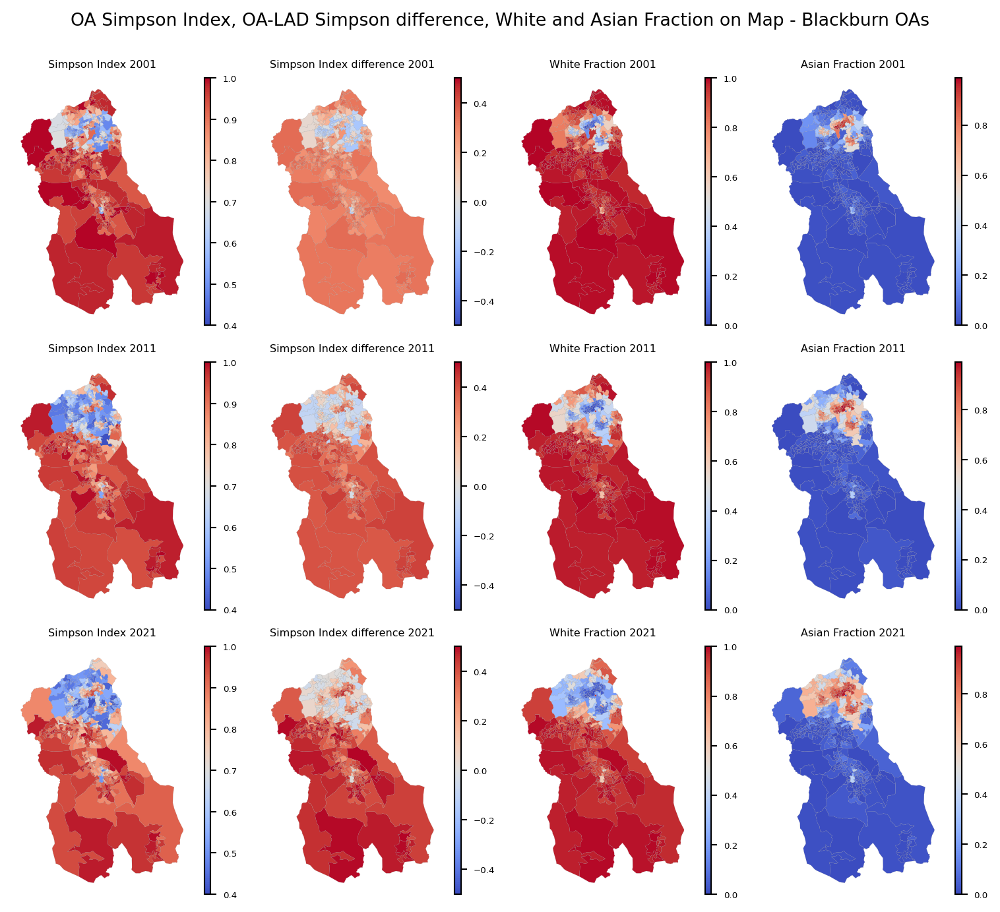

In [113]:
#| echo: false
#| label: fig-oablbnmap
#| fig-cap: OA Simpson Index, White and Asian Fraction and Asian Moran's I on Map - Blackburn OAs

years = [2001, 2011, 2021]

oa_simpson_min, oa_simpson_max = blackburn['OA_simpson'].min(), blackburn['OA_simpson'].max()
white_fraction_min, white_fraction_max = blackburn['white_fraction'].min(), blackburn['white_fraction'].max()
asian_fraction_min, asian_fraction_max = blackburn['asian_fraction'].min(), blackburn['asian_fraction'].max()

# Reverse the colormap for the last column
fig, axes = plt.subplots(nrows=3, ncols=4, figsize=(8, 8))

# Flatten the axes array for easier iteration
axes = axes.flatten()

# Variables and titles for the plots
variables = [
    ('OA_simpson', oa_simpson_min, oa_simpson_max, 'Simpson Index', 'coolwarm'),
    ('simp_diff', -0.5,0.5, 'Simpson Index difference', 'coolwarm'),
    ('white_fraction', white_fraction_min, white_fraction_max, 'White Fraction', 'coolwarm'),
    ('asian_fraction', asian_fraction_min, asian_fraction_max, 'Asian Fraction', 'coolwarm'),
]

# Loop through years and variables to plot the maps
for j, year in enumerate(years):
    for i, (variable, min_val, max_val, title, cmap) in enumerate(variables):
        # Filter data for the given year
        data_year = blackburn[blackburn['year'] == year]

        # Determine the correct subplot index
        ax_index = j * 4 + i
        
        # Plot the variable
        ax = axes[ax_index]
        divider = make_axes_locatable(ax)
        cax = divider.append_axes("right", size="3.5%", pad=0.1)
        data_year.plot(column=variable, cmap=cmap, linewidth=0.05, ax=ax, edgecolor='0.5',
                       vmin=min_val, vmax=max_val, legend=False)
        # Manually create the colorbar
        norm = plt.Normalize(vmin=min_val, vmax=max_val)
        cbar = plt.colorbar(plt.cm.ScalarMappable(norm=norm, cmap=cmap), cax=cax)
        cbar.ax.tick_params(labelsize=5)

        ax.set_title(f'{title} {year}', fontsize=6)
        ax.axis('off')

fig.suptitle('OA Simpson Index, OA-LAD Simpson difference, White and Asian Fraction on Map - Blackburn OAs', fontsize=10, y= 0.93)

# Adjust layout
plt.subplots_adjust(hspace=-0.2)
plt.tight_layout(rect=[0, 0, 1, 0.96])
plt.show()

### Blackburn with Darwen Map – LSOA Level
<p style="text-align: justify;">
@fig-lsoablbnmap shows the Simpson Index for each LSOA in Blackburn and its difference from the town-wide Simpson Index. The same pattern observed in OAs can be seen in LSOAs. While the changes in the LSOA Simpson Index are slightly tangible, the changes in their differences from the town-wide Simpson Index are more evident. This can be inferred to mean that the rate of decrease in the town-wide Simpson Index is greater than that of the LSOAs. Again, there are no significant changes in the fractions of White and Asian ethnicities in LSOAs. However, regarding the Moran's I index on map, their spatial distribution is changing within the OAs of each LSOA, as indicated by meaningful changes in the Moran's I index for some LSOAs.
</p>

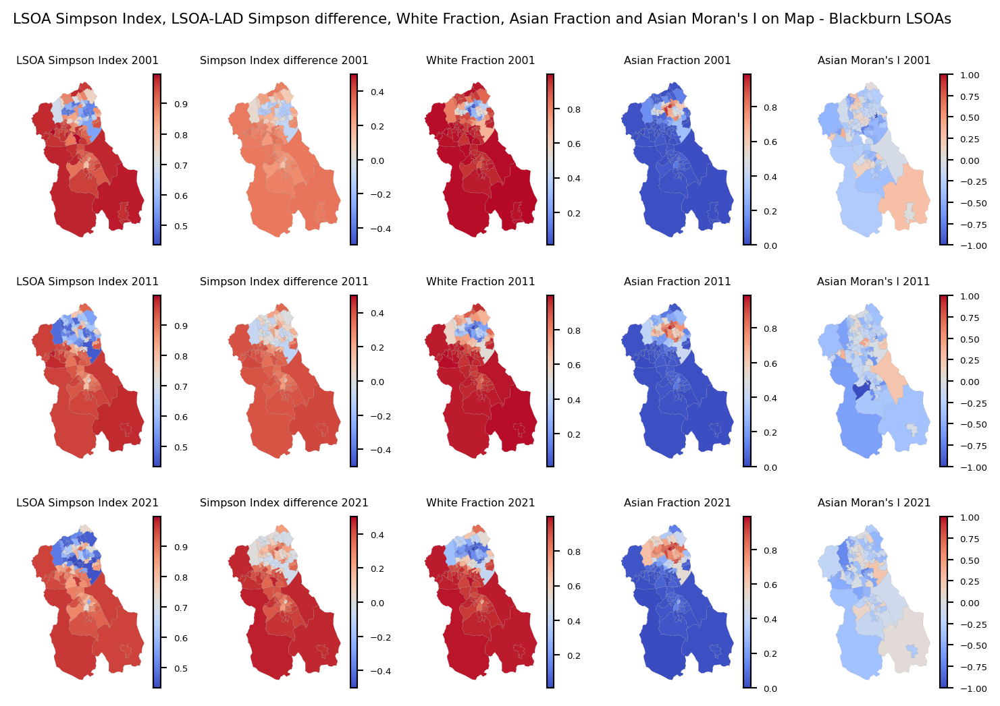

In [114]:
#| echo: false
#| label: fig-lsoablbnmap
#| fig-cap: LSOA Simpson Index, White and Asian Fraction and Asian Moran's I on Map - Blackburn LSOAs

years = [2001, 2011, 2021]

lsoa_simpson_min, lsoa_simpson_max = blackburn_LSOA['LSOA_simpson'].min(), blackburn_LSOA['LSOA_simpson'].max()
white_fraction_min, white_fraction_max = blackburn_LSOA['white_fraction'].min(), blackburn_LSOA['white_fraction'].max()

# Reverse the colormap for the last column
fig, axes = plt.subplots(nrows=3, ncols=5, figsize=(8, 8))

# Flatten the axes array for easier iteration
axes = axes.flatten()

# Variables and titles for the plots
variables = [
    ('LSOA_simpson', lsoa_simpson_min, lsoa_simpson_max, 'LSOA Simpson Index', 'coolwarm'),
    ('simp_diff', -0.5,0.5, 'Simpson Index difference', 'coolwarm'),
    ('white_fraction', white_fraction_min, white_fraction_max, 'White Fraction', 'coolwarm'),
    ('asian_fraction', asian_fraction_min, asian_fraction_max, 'Asian Fraction', 'coolwarm'),
    ('asian_moran', -1, 1, "Asian Moran's I",'coolwarm')
    
]

# Loop through years and variables to plot the maps
for j, year in enumerate(years):
    for i, (variable, min_val, max_val, title, cmap) in enumerate(variables):
        # Filter data for the given year
        data_year = blackburn_LSOA[blackburn_LSOA['year'] == year]

        # Determine the correct subplot index
        ax_index = j * 5 + i
        
        # Plot the variable
        ax = axes[ax_index]
        divider = make_axes_locatable(ax)
        cax = divider.append_axes("right", size="3.5%", pad=-0.3)
        data_year.plot(column=variable, cmap=cmap, linewidth=0.05, ax=ax, edgecolor='0.5',
                       vmin=min_val, vmax=max_val, legend=False)
        
        # Manually create the colorbar
        norm = plt.Normalize(vmin=min_val, vmax=max_val)
        cbar = plt.colorbar(plt.cm.ScalarMappable(norm=norm, cmap=cmap), cax=cax)
        cbar.ax.tick_params(labelsize=5)

        ax.set_title(f'{title} {year}', fontsize=6)
        ax.axis('off')


fig.suptitle('LSOA Simpson Index, LSOA-LAD Simpson difference, White Fraction, Asian Fraction and Asian Moran\'s I on Map - Blackburn LSOAs', 
             fontsize=8, y=0.82)

# Adjust layout
plt.subplots_adjust(hspace=-0.6)
plt.tight_layout(rect=[0, 0, 1, 0.96])
plt.show()

### Blackburn with Darwen Map – MSOA Level
<p style="text-align: justify;">
@fig-msoablbnmap shows the Simpson Index for each MSOA and its difference from the town-wide Simpson Index in Blackburn with Darwen. At this level, changes in the MSOA Simpson Index are more evident. By examining the OA-based White and Asian Moran's I index on the map, a positive value is noticeable in the northern part of the city, indicating a significant clustering of the Asian population in that area.
</p>

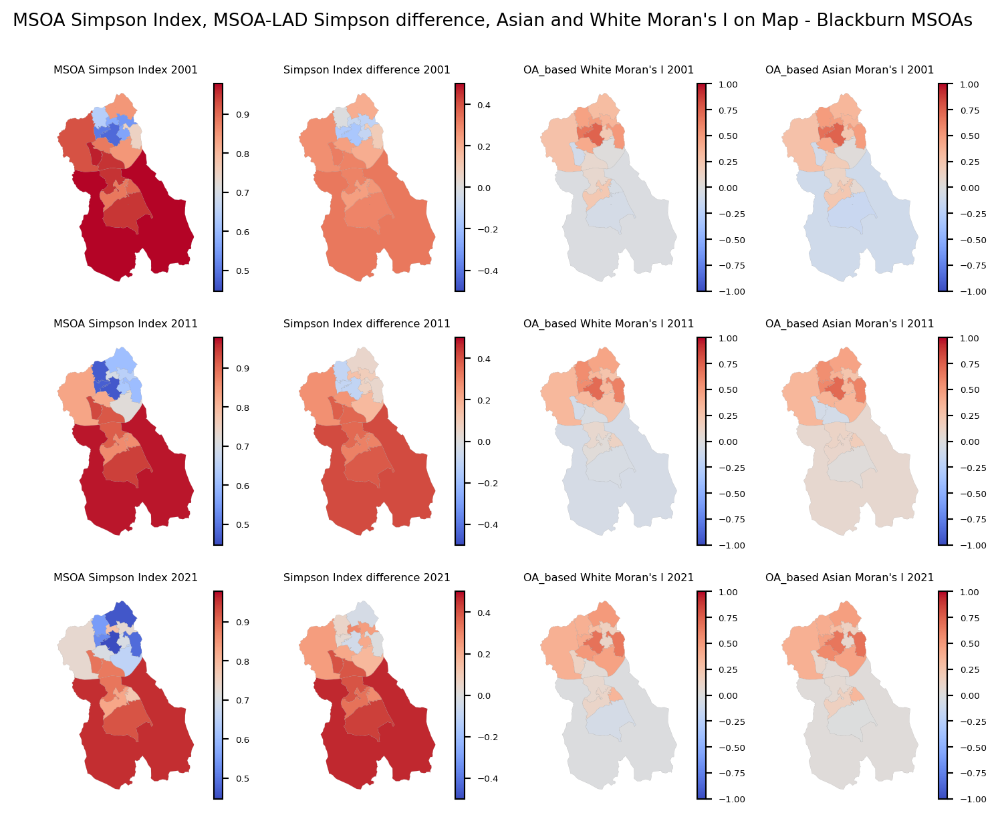

In [115]:
#| echo: false
#| label: fig-msoablbnmap
#| fig-cap: MSOA Simpson Index, MSOA-LAD Simpson difference, Asian and White Moran's I on Map - Blackburn MSOAs

years = [2001, 2011, 2021]

msoa_simpson_min, msoa_simpson_max = blackburn_MSOA['MSOA_simpson'].min(), blackburn_MSOA['MSOA_simpson'].max()

# Reverse the colormap for the last column
fig, axes = plt.subplots(nrows=3, ncols=4, figsize=(8, 8))

# Flatten the axes array for easier iteration
axes = axes.flatten()

# Variables and titles for the plots
variables = [
    ('MSOA_simpson', msoa_simpson_min, msoa_simpson_max, 'MSOA Simpson Index', 'coolwarm'),
    ('simp_diff', -0.5,0.5, 'Simpson Index difference', 'coolwarm'),
    ('asian_moran_OA', -1, 1, "OA_based White Moran's I", 'coolwarm'),
    ('white_moran_OA', -1, 1, "OA_based Asian Moran's I", 'coolwarm')
    
    
]

# Loop through years and variables to plot the maps
for j, year in enumerate(years):
    for i, (variable, min_val, max_val, title, cmap) in enumerate(variables):
        # Filter data for the given year
        data_year = blackburn_MSOA[blackburn_MSOA['year'] == year]

        # Determine the correct subplot index
        ax_index = j * 4 + i
        
        # Plot the variable
        ax = axes[ax_index]
        divider = make_axes_locatable(ax)
        cax = divider.append_axes("right", size="3.5%", pad=-0.3)
        data_year.plot(column=variable, cmap=cmap, linewidth=0.05, ax=ax, edgecolor='0.5',
                       vmin=min_val, vmax=max_val, legend=False)

        # Manually create the colorbar
        norm = plt.Normalize(vmin=min_val, vmax=max_val)
        cbar = plt.colorbar(plt.cm.ScalarMappable(norm=norm, cmap=cmap), cax=cax)
        cbar.ax.tick_params(labelsize=5)

        ax.set_title(f'{title} {year}', fontsize=6)
        ax.axis('off')

fig.suptitle('MSOA Simpson Index, MSOA-LAD Simpson difference, Asian and White Moran\'s I on Map - Blackburn MSOAs', 
             fontsize=10, y=0.88)

# Adjust layout
plt.subplots_adjust(hspace=-0.4)
plt.tight_layout(rect=[0, 0, 1, 0.96])
plt.show()

### Blackburn with Darwen Correlations Heatmap
<p style="text-align: justify;">
@fig-blbnheatmap illustrates the linear correlation between the LSOA Simpson Index and the ethnicity fractions in each LSOA. As can be observed, like other cities, the correlation between the White fraction and the LSOA Simpson Index decreases as the White fraction decreases.
</p>

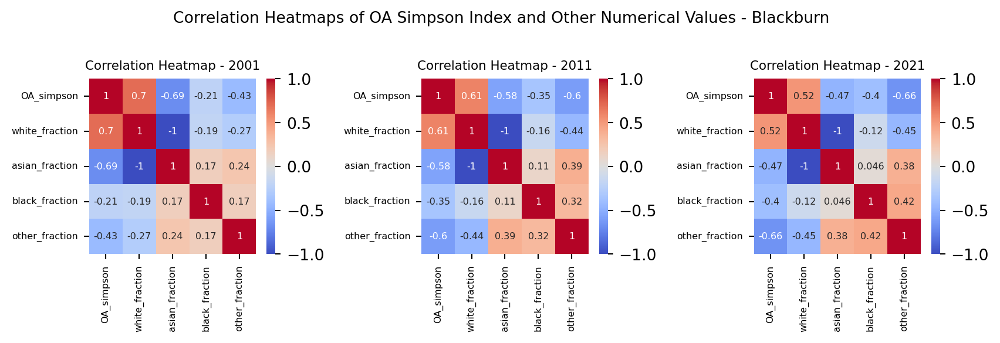

In [116]:
#| echo: false
#| label: fig-blbnheatmap
#| fig-cap: Correlation Heatmap - Blackburn
numerical_columns = ['OA_simpson', 'white_fraction', 'asian_fraction', 'black_fraction', 'other_fraction']

years = [2001, 2011, 2021]

correlation_dic = {}
for year in years:
    # Filter data for the specific year
    corr_df = blackburn_OA[blackburn_OA['year'] == year][numerical_columns]
    correlation_matrix = corr_df.corr()
    correlation_dic[year] = correlation_matrix

fig, axes = plt.subplots(1, 3, figsize=(9, 3))

# Plot each heatmap in a subplot
for i, year in enumerate(years):
    ax = axes[i]
    sns.heatmap(correlation_dic[year], annot=True, cmap='coolwarm', vmin=-1, vmax=1, ax=ax, annot_kws={"size": 6})
    ax.set_title(f'Correlation Heatmap - {year}', fontsize=8)
    ax.tick_params(axis='x', labelsize=6)
    ax.tick_params(axis='y', labelsize=6) 

# Adjust layout
plt.tight_layout(rect=[0, 0, 1, 0.96])
plt.suptitle('Correlation Heatmaps of OA Simpson Index and Other Numerical Values - Blackburn', fontsize=10, y=1)
plt.tight_layout()
plt.show()

## Oldham
<p style="text-align: justify;" >
Oldham is a town in Greater Manchester, located in the west of England. As shown in @fig-olhmethnicpop, Oldham's total population increased from 217,266 in 2001 to 242,256 in 2021. During this period, the population of the White ethnic group decreased from 187,187 to 164,900, while the population of the Asian ethnic group more than doubled, increasing from 26,406 in 2001 to 59,558 in 2021. In Oldham, similar to other cities, the growth rate of the Asian population is higher than that of the Black and other ethnic groups. As depicted in @fig-olhmfracoverview, the fraction of the White ethnic group decreased from 86.20% in 2001 to 68.1% in 2021, while the Asian fraction increased from 12.2% in 2001 to 24.60% in 2021.
</p>

In [117]:
#| include: false
oldham_indexes = LAD_total[LAD_total['LADNM'].str.contains('Oldham')].reset_index(drop= True)
oldham_indexes['total_population']= (oldham_indexes['white']+oldham_indexes['asian'] + 
                                        oldham_indexes['black']+oldham_indexes['other'])
cols = list(oldham_indexes.columns)
cols.insert(7, cols.pop(cols.index('total_population')))
oldham_indexes = oldham_indexes[cols]
oldham_indexes

,year,LADCD,LADNM,white,asian,black,other,total_population,white_frac,asian_frac,...,MSOA_white_mor,OA_asian_mor,LSOA_asian_mor,MSOA_asian_mor,OA_black_mor,LSOA_black_mor,MSOA_black_mor,OA_other_mor,LSOA_other_mor,MSOA_other_mor
0,2001,E08000004,Oldham,187187,26406,1248,2425,217266,0.862,0.122,...,0.337,0.773,0.610,0.312,0.180,0.401,0.340,0.218,0.359,0.271
1,2011,E08000004,Oldham,174326,43165,2797,4609,224897,0.775,0.192,...,0.449,0.855,0.715,0.408,0.324,0.431,0.291,0.314,0.363,0.296
2,2021,E08000004,Oldham,164900,59558,8201,9397,242056,0.681,0.246,...,0.578,0.863,0.780,0.512,0.339,0.388,0.155,0.404,0.496,0.536


In [118]:
#| include: false
# creating Oldham dataframe
oldham_2001= pd.read_csv('preprocessed files/2001/oldham_2001.csv')
oldham_2011= pd.read_csv('preprocessed files/2011/oldham_2011.csv')
oldham_2021= pd.read_csv('preprocessed files/2021/oldham_2021.csv')
oldham_2001['simp_diff'] = oldham_2001['OA_simpson']- oldham_indexes.LAD_simpson[0]
oldham_2011['simp_diff'] = oldham_2011['OA_simpson']- oldham_indexes.LAD_simpson[1]
oldham_2021['simp_diff'] = oldham_2021['OA_simpson']- oldham_indexes.LAD_simpson[2]

oldham_LSOA_2001= pd.read_csv('preprocessed files/2001/oldham_LSOA_2001.csv')
oldham_LSOA_2011= pd.read_csv('preprocessed files/2011/oldham_LSOA_2011.csv')
oldham_LSOA_2021= pd.read_csv('preprocessed files/2021/oldham_LSOA_2021.csv')
oldham_LSOA_2001['simp_diff'] = oldham_LSOA_2001['LSOA_simpson']- oldham_indexes.LAD_simpson[0]
oldham_LSOA_2011['simp_diff'] = oldham_LSOA_2011['LSOA_simpson']- oldham_indexes.LAD_simpson[1]
oldham_LSOA_2021['simp_diff'] = oldham_LSOA_2021['LSOA_simpson']- oldham_indexes.LAD_simpson[2]

oldham_MSOA_2001= pd.read_csv('preprocessed files/2001/oldham_MSOA_2001.csv')
oldham_MSOA_2011= pd.read_csv('preprocessed files/2011/oldham_MSOA_2011.csv')
oldham_MSOA_2021= pd.read_csv('preprocessed files/2021/oldham_MSOA_2021.csv')
oldham_MSOA_2001['simp_diff'] = oldham_MSOA_2001['MSOA_simpson']- oldham_indexes.LAD_simpson[0]
oldham_MSOA_2011['simp_diff'] = oldham_MSOA_2011['MSOA_simpson']- oldham_indexes.LAD_simpson[1]
oldham_MSOA_2021['simp_diff'] = oldham_MSOA_2021['MSOA_simpson']- oldham_indexes.LAD_simpson[2]

oldham= pd.concat([oldham_2001,oldham_2011,oldham_2021]).reset_index(drop=True)
oldham.insert(9, 'simp_diff', oldham.pop('simp_diff'))

# Converting the dataframe into GPD
oldham['geometry'] = oldham['geometry'].apply(wkt.loads)
oldham = gpd.GeoDataFrame(oldham, geometry='geometry')

oldham_center = {"lat": 53.5600, "lon": -2.0500}

In [119]:
#| include: false
oldham_2001.head()
#| include: false
# Creating df for OA level
oldham_OA = oldham.drop(['LSOACD', 'MSOACD', 'LADCD', 'LSOANM', 'MSOANM'], axis= 1)
oldham_OA = oldham_OA.set_crs(epsg=27700)
oldham_OA = oldham_OA.to_crs(epsg=4326)  

In [120]:
#| include: false
# Creating df for LSOA level
oldham_LSOA= pd.concat([oldham_LSOA_2001,oldham_LSOA_2011,oldham_LSOA_2021]).reset_index(drop=True)
oldham_LSOA.insert(3, 'simp_diff', oldham_LSOA.pop('simp_diff'))

oldham_LSOA['geometry'] = oldham_LSOA['geometry'].apply(wkt.loads)
oldham_LSOA = gpd.GeoDataFrame(oldham_LSOA, geometry='geometry')

oldham_LSOA = oldham_LSOA.set_crs(epsg=27700)
oldham_LSOA = oldham_LSOA.to_crs(epsg=4326)

In [121]:
#| include: false
# Creating df for MSOA level
oldham_MSOA= pd.concat([oldham_MSOA_2001,oldham_MSOA_2011,oldham_MSOA_2021]).reset_index(drop=True)
oldham_MSOA.insert(3, 'simp_diff', oldham_MSOA.pop('simp_diff'))

oldham_MSOA['geometry'] = oldham_MSOA['geometry'].apply(wkt.loads)
oldham_MSOA = gpd.GeoDataFrame(oldham_MSOA, geometry='geometry')

oldham_MSOA = oldham_MSOA.set_crs(epsg=27700)
oldham_MSOA = oldham_MSOA.to_crs(epsg=4326)


In [122]:
#| echo: false
#| label: fig-olhmethnicpop
#| fig-cap: Ethnicity and Total Population Line Chart - Oldham
# Ethnicity and Total Population Line Chart - Oldham

oldham_long= oldham_indexes[['year','white', 'asian', 'black', 'other']].melt(id_vars=['year'], 
                                                                                      var_name='ethnicity',
                                                                                      value_name='population',)

# Create subplots
fig = make_subplots(rows=2, cols=1, subplot_titles=("Ethnicity Population - Oldham", "Total Population - Oldham"),
                     vertical_spacing=0.15)

# Add traces for ethnicity populations
offsets = {
    'white': (10, 30),
    'asian': (10, -10),
    'black': (10, 30),
    'other': (10, -10)
}


for ethnicity in oldham_long['ethnicity'].unique():
    trace = go.Scatter(
        x=oldham_long[oldham_long['ethnicity'] == ethnicity]['year'],
        y=oldham_long[oldham_long['ethnicity'] == ethnicity]['population'],
        mode='lines+markers',
        name=ethnicity,
        legendgroup=ethnicity 
    )
    fig.add_trace(trace, row=1, col=1)
    
    # Add annotations with custom offsets for each ethnicity
    for i, row in oldham_long[oldham_long['ethnicity'] == ethnicity].iterrows():
        ax, ay = offsets.get(ethnicity, (0, 0)) 
        fig.add_annotation(
            x=row['year'],
            y=row['population'],
            text=f"{row['population']:,}",
            showarrow=True,
            arrowhead=0,
            ax=ax,
            ay=ay,
            font=dict(size=10),
            xanchor='center',
            yanchor='bottom',
            row=1,
            col=1
        )

# Add trace for total population in the second subplot
total_population_trace = go.Scatter(
    x=oldham_indexes['year'],
    y=oldham_indexes['total_population'],
    mode='lines+markers',
    name='Total Population',
    line=dict(color='black')
)
fig.add_trace(total_population_trace, row=2, col=1)

# Add annotations for total population
for i, row in oldham_indexes.iterrows():
    fig.add_annotation(
        x=row['year'],
        y=row['total_population'],
        text=f"{row['total_population']:,}",
        showarrow=True,
        arrowhead=0,
        ax=0,
        ay=-20,
        font=dict(size=10),
        xanchor='center',
        yanchor='bottom',
        row=2,
        col=1
    )

# Update x-axis and y-axis titles
fig.update_xaxes(title_text="Year", row=1, col=1)
fig.update_yaxes(title_text="Ethnicity Population", row=1, col=1)
fig.update_xaxes(title_text="Year", row=1, col=2)
fig.update_yaxes(title_text="Total Population", row=1, col=2)

# Update layout
fig.update_layout(
    height=700, 
    width=650, 
    title_text="Ethnicity and Total Population Line Chart - Oldham",
    title_x=0.5,
    title_y=0.96,
    showlegend=True,
    legend=dict(orientation="h", yanchor="top", y= 1.1, xanchor="center", x=0.5)
    )

# Display the figure
pyo.iplot(fig)

In [123]:
#| echo: false
#| label: fig-olhmfracoverview
#| fig-cap: Ethnic Group Fractions Over Time - Oldham
# Ethnic Group Fractions Over Time - Oldham

fig = go.Figure()

# Add traces for each ethnic group fraction as stacked bars with percentage annotations outside
fig.add_trace(go.Bar(x=oldham_indexes['year'], y=oldham_indexes['white_frac'], 
                     name='White', legendgroup='ethnic_group', width=4, marker=dict(color='gray'),
                     text=oldham_indexes['white_frac'] * 100, textposition='outside', 
                     texttemplate='%{text:.2f}%'))
fig.add_trace(go.Bar(x=oldham_indexes['year'], y=oldham_indexes['asian_frac'], 
                     name='Asian', legendgroup='ethnic_group', width=4, marker=dict(color='orange'),
                     text=oldham_indexes['asian_frac'] * 100, textposition='outside', 
                     texttemplate='%{text:.2f}%'))
fig.add_trace(go.Bar(x=oldham_indexes['year'], y=oldham_indexes['black_frac'], 
                     name='Black', legendgroup='ethnic_group', width=4, marker=dict(color='black'),
                     text=oldham_indexes['black_frac'] * 100, textposition='outside', 
                     texttemplate='%{text:.2f}%'))
fig.add_trace(go.Bar(x=oldham_indexes['year'], y=oldham_indexes['other_frac'], 
                     name='Other', legendgroup='ethnic_group', width=4, marker=dict(color='green'),
                     text=oldham_indexes['other_frac'] * 100, textposition='inside', 
                     texttemplate='%{text:.2f}%'))

# Update layout
fig.update_layout(title_text="Ethnic Group Fractions Over Time - Oldham ",
                  title_x=0.5,
                  title_y=0.9,
                  title_font=dict(size=16),
                  xaxis_title='Year',
                  xaxis=dict(tickvals=[2001, 2011, 2021]),
                  yaxis_title='Ethnicity Fraction',
                  yaxis=dict(
                      title='Ethnicity Fraction',
                      side='left'),
                  barmode='relative',
                  hovermode='x unified',
                  width=600,
                  height=500,
                  legend=dict(orientation="h",
                              yanchor="top",
                              y=1.1,
                              xanchor="center",
                              x=0.5,
                              traceorder='normal'))

# Display the figure
pyo.iplot(fig)


In [124]:
#| include: false
# #| echo: false
# #| label: fig-olhmsimp
# #| fig-cap: Simpson Index Line Chart - Oldham

# oldham_long= oldham_indexes[['year','OA_simpson', 'LSOA_simpson', 'MSOA_simpson', 'LAD_simpson']].melt(id_vars=['year'], var_name='level', value_name='simpson_index')

# traces = []
# for level in oldham_long['level'].unique():
#     trace = go.Scatter(
#         x= oldham_long[oldham_long['level'] == level]['year'],
#         y= oldham_long[oldham_long['level'] == level]['simpson_index'],
#         mode='lines+markers',
#         name=level
#     )
#     traces.append(trace)

# layout = go.Layout(title_text="Simpson Index Line Chart - Oldham",
#                     title_x=0.5,
#                     title_font=dict(size=16),
#                     xaxis=dict(title='Year', tickvals=oldham_long['year'].unique()),
#                     yaxis=dict(title='Simpson Index'),
#                     legend=dict(orientation="h",
#                                 yanchor="top",
#                                 y=1.2,
#                                 xanchor="center",
#                                 x=0.5),
#                     hovermode='closest',
#                     showlegend=True,
#                     height = 400,
#                     width = 700
# )

# fig = go.Figure(data=traces, layout=layout)

# pyo.iplot(fig)

In [125]:
#| include: false
# #| echo: false
# #| label: fig-olhmoamap
# #| fig-cap: OA Simpson Index by Year in Oldham
# # OA Simpson Index by Year in Oldham

# fig = px.choropleth_mapbox(oldham_OA,
#                            geojson=oldham_OA.geometry,
#                            locations=oldham_OA.index,
#                            color='OA_simpson',
#                            animation_frame='year',
#                            color_continuous_scale=px.colors.diverging.RdBu[::-1],
#                            range_color=(0, 1),
#                            hover_name='OACD',
#                            hover_data={'white_fraction': True},
#                            labels={'OA_simpson': 'OA Simpson Index',
#                                    'white_fraction': 'White Fraction'},
#                            title='OA Simpson Index by Year in Oldham',
#                            center=oldham_center,
#                            zoom=10.5,
#                            mapbox_style='carto-positron'
#                            )

# # Customize the layout
# fig.update_layout(margin={"r":0,"t":40,"l":0,"b":0}, title_x=0.5,
#                   width=800,
#                   height=800 
#     )

# # Display the map
# fig.show()

In [126]:
#| include: false
# #| echo: false
# #| label: fig-olhmlsoamap
# #| fig-cap: LSOA Simpson Index by Year in Oldham
# # LSOA Simpson Index by Year in Oldham

# fig = px.choropleth_mapbox(oldham_LSOA,
#                            geojson=oldham_LSOA.geometry,
#                            locations=oldham_LSOA.index,
#                            color='LSOA_simpson',
#                            animation_frame='year',
#                            color_continuous_scale=px.colors.diverging.RdBu[::-1],
#                            range_color=(0, 1),
#                            hover_name='LSOACD',
#                            hover_data={'white_fraction': True},
#                            labels={'LSOA_simpson': 'LSOA Simpson Index',
#                                    'white_fraction': 'White Fraction'},
#                            title='LSOA Simpson Index by Year in Oldham',
#                            center=oldham_center,
#                            zoom=10.5,
#                            mapbox_style='carto-positron'
#                            )

# # Customize the layout
# fig.update_layout(margin={"r":0,"t":40,"l":0,"b":0}, title_x=0.5,
#                   width=800,
#                   height=800 
#     )

# # Display the map
# fig.show()

In [127]:
#| include: false
# #| echo: false
# #| label: fig-olhmmsoamap
# #| fig-cap: MSOA Simpson Index by Year in Oldham
# # mSOA Simpson Index by Year in Oldham

# fig = px.choropleth_mapbox(oldham_MSOA,
#                            geojson=oldham_MSOA.geometry,
#                            locations=oldham_MSOA.index,
#                            color='MSOA_simpson',
#                            animation_frame='year',
#                            color_continuous_scale=px.colors.diverging.RdBu[::-1],
#                            range_color=(0, 1),
#                            hover_name='MSOACD',
#                            hover_data={'white_fraction': True},
#                            labels={'MSOA_simpson': 'MSOA Simpson Index',
#                                    'white_fraction': 'White Fraction'},
#                            title='MSOA Simpson Index by Year in Oldham',
#                            center=oldham_center,
#                            zoom=10.5,
#                            mapbox_style='carto-positron'
#                            )

# # Customize the layout
# fig.update_layout(margin={"r":0,"t":40,"l":0,"b":0}, title_x=0.5,
#                   width=800,
#                   height=800 
#     )

# # Display the map
# fig.show()

In [128]:
#| include: false
# #| echo: false
# #| label: fig-olhmlsoamormap
# #| fig-cap: Moran's I Index by Year in Oldham LSOAs
# # Moran's I Index by Year in Oldham LSOAs

# ethnicity = 'white'
# fig = px.choropleth_mapbox(oldham_LSOA,
#                            geojson=oldham_LSOA.geometry,
#                            locations=oldham_LSOA.index,
#                            color=f'{ethnicity}_moran',
#                            animation_frame='year',
#                            color_continuous_scale=px.colors.diverging.RdBu[::-1],
#                            range_color=(-1, 1),
#                            hover_name='LSOACD',
#                            hover_data={f'{ethnicity}_fraction': True},
#                            labels={f'{ethnicity}_moran': f'{ethnicity.capitalize()} Moran Index',
#                                    f'{ethnicity}_fraction': f'{ethnicity.capitalize()} Fraction'},
#                            title="Moran's I Index by Year in Oldham LSOAs",
#                            center=oldham_center,
#                            zoom=10.5,
#                            mapbox_style='carto-positron'
#                            )

# # Customize the layout
# fig.update_layout(margin={"r":0,"t":40,"l":0,"b":0}, title_x=0.5,
#                   width=800,
#                   height=800 
#     )

# # Display the map
# fig.show()

In [129]:
#| include: false
# #| echo: false
# #| label: fig-olhmmsoamormapoa
# #| fig-cap: OA-based Moran's I Index by Year in Oldham MSOAs
# # OA-based Moran's I Index by Year in Oldham MSOAs
# ethnicity = 'white'
# fig = px.choropleth_mapbox(oldham_MSOA,
#                            geojson=oldham_MSOA.geometry,
#                            locations=oldham_MSOA.index,
#                            color=f'{ethnicity}_moran_OA',
#                            animation_frame='year',
#                            color_continuous_scale=px.colors.diverging.RdBu[::-1],
#                            range_color=(-1, 1),
#                            hover_name='MSOACD',
#                            hover_data={f'{ethnicity}_fraction': True},
#                            labels={f'{ethnicity}_moran_OA': f'OA-based {ethnicity.capitalize()} Moran Index',
#                                    f'{ethnicity}_fraction': f'{ethnicity.capitalize()} Fraction'},
#                            title="OA-based Moran's I Index by Year in Oldham MSOAs",
#                            center=oldham_center,
#                            zoom=10,
#                            mapbox_style='carto-positron'
#                            )

# # Customize the layout
# fig.update_layout(margin={"r":0,"t":40,"l":0,"b":0}, title_x=0.5,
#                   width=870,
#                   height=800 
#     )

# # Display the map
# fig.show()

In [130]:
#| include: false
# #| echo: false
# #| label: fig-olhmmsoamormaplsoa
# #| fig-cap: LSOA-based Moran's I Index by Year in Oldham MSOAs
# # LSOA-based Moran's I Index by Year in Oldham MSOAs

# ethnicity = 'white'
# fig = px.choropleth_mapbox(oldham_MSOA,
#                            geojson=oldham_MSOA.geometry,
#                            locations=oldham_MSOA.index,
#                            color=f'{ethnicity}_moran_LSOA',
#                            animation_frame='year',
#                            color_continuous_scale=px.colors.diverging.RdBu[::-1],
#                            range_color=(-1, 1),
#                            hover_name='MSOACD',
#                            hover_data={f'{ethnicity}_fraction': True},
#                            labels={f'{ethnicity}_moran_LSOA': f'LSOA-based {ethnicity.capitalize()} Moran Index',
#                                    f'{ethnicity}_fraction': f'{ethnicity.capitalize()} Fraction'},
#                            title="LSOA-based Moran's I Index by Year in Oldham MSOAs",
#                            center=oldham_center,
#                            zoom=10,
#                            mapbox_style='carto-positron'
#                            )

# # Customize the layout
# fig.update_layout(margin={"r":0,"t":40,"l":0,"b":0}, title_x=0.5,
#                   width=950,
#                   height=800 
#     )

# # Display the map
# fig.show()

### Oldham Map – OA Level
<p style="text-align: justify;">
@fig-oaolhmmap shows the Simpson Index for each OA and its difference from the town-wide Simpson Index in Oldham. In the first column, the Simpson Index of the western OAs has the lowest values, and the overall Simpson Index is decreasing. On the other hand, the Simpson Index difference plot shows an increase, indicating that the town-wide Simpson Index is decreasing at a higher rate compared to the OA Simpson Indexes. As observed from the White and Asian fractions map, the OAs in the southwest areas have a lower White fraction and a higher Asian fraction.
</p>

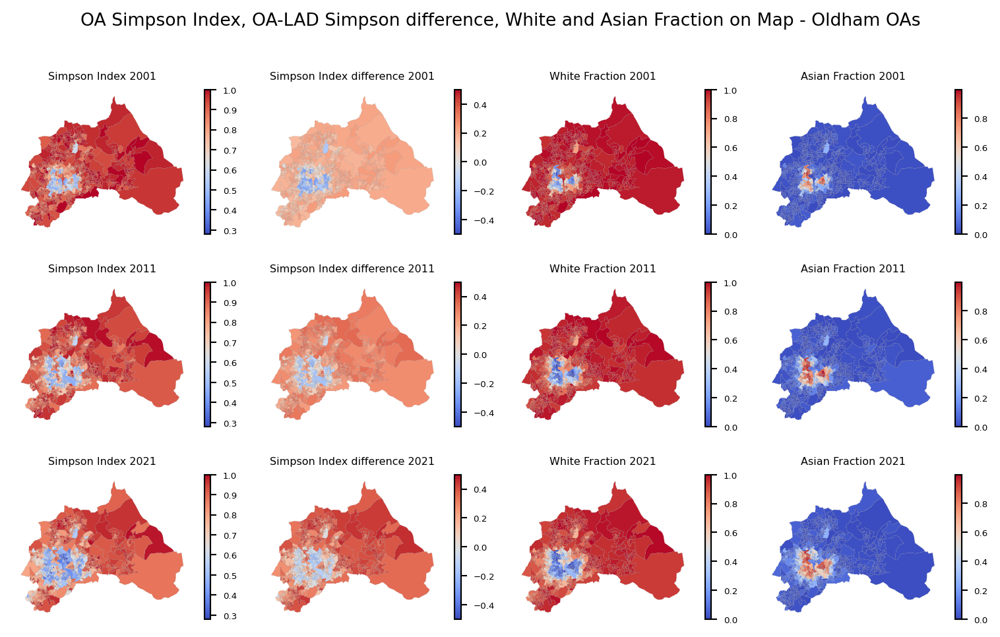

In [131]:
#| echo: false
#| label: fig-oaolhmmap
#| fig-cap: OA Simpson Index, White and Asian Fraction and Asian Moran's I on Map - Oldham OAs

years = [2001, 2011, 2021]

oa_simpson_min, oa_simpson_max = oldham['OA_simpson'].min(), oldham['OA_simpson'].max()
white_fraction_min, white_fraction_max = oldham['white_fraction'].min(), oldham['white_fraction'].max()
asian_fraction_min, asian_fraction_max = oldham['asian_fraction'].min(), oldham['asian_fraction'].max()

# Reverse the colormap for the last column
fig, axes = plt.subplots(nrows=3, ncols=4, figsize=(8, 8))

# Flatten the axes array for easier iteration
axes = axes.flatten()

# Variables and titles for the plots
variables = [
    ('OA_simpson', oa_simpson_min, oa_simpson_max, 'Simpson Index', 'coolwarm'),
    ('simp_diff', -0.5,0.5, 'Simpson Index difference', 'coolwarm'),
    ('white_fraction', white_fraction_min, white_fraction_max, 'White Fraction', 'coolwarm'),
    ('asian_fraction', asian_fraction_min, asian_fraction_max, 'Asian Fraction', 'coolwarm'),
]

# Loop through years and variables to plot the maps
for j, year in enumerate(years):
    for i, (variable, min_val, max_val, title, cmap) in enumerate(variables):
        # Filter data for the given year
        data_year = oldham[oldham['year'] == year]

        # Determine the correct subplot index
        ax_index = j * 4 + i
        
        # Plot the variable
        ax = axes[ax_index]
        divider = make_axes_locatable(ax)
        cax = divider.append_axes("right", size="3.5%", pad=0.1)
        data_year.plot(column=variable, cmap=cmap, linewidth=0.05, ax=ax, edgecolor='0.5',
                       vmin=min_val, vmax=max_val, legend=False)
        # Manually create the colorbar
        norm = plt.Normalize(vmin=min_val, vmax=max_val)
        cbar = plt.colorbar(plt.cm.ScalarMappable(norm=norm, cmap=cmap), cax=cax)
        cbar.ax.tick_params(labelsize=5)

        ax.set_title(f'{title} {year}', fontsize=6)
        ax.axis('off')

fig.suptitle('OA Simpson Index, OA-LAD Simpson difference, White and Asian Fraction on Map - Oldham OAs', fontsize=10, y= 0.8)

# Adjust layout
plt.subplots_adjust(hspace=-0.7)
plt.tight_layout(rect=[0, 0, 1, 0.96])
plt.show()


### Oldham Map – LSOA Level
<p style="text-align: justify;">
@fig-lsoaolhmmap shows the Simpson Index for each LSOA in Oldham and its difference from the town-wide Simpson Index. The same pattern observed in OAs can be seen in LSOAs.  By looking at the fractions plot, it is evident that the White and Asian fractions are changing in the southwest areas but only slightly in other LSOAs. In the right-hand column of the plot, the Asian Moran's I index for each LSOA is displayed. The map shows that the predominant value of this index for Asians is negative or close to zero, indicating no significant clustering or dispersion of the Asian population in OAs within LSOAs. However, the Moran's I index is changing in LSOAs, meaning that Asians spatial distribution is changing within the OAs of each LSOA.
</p>

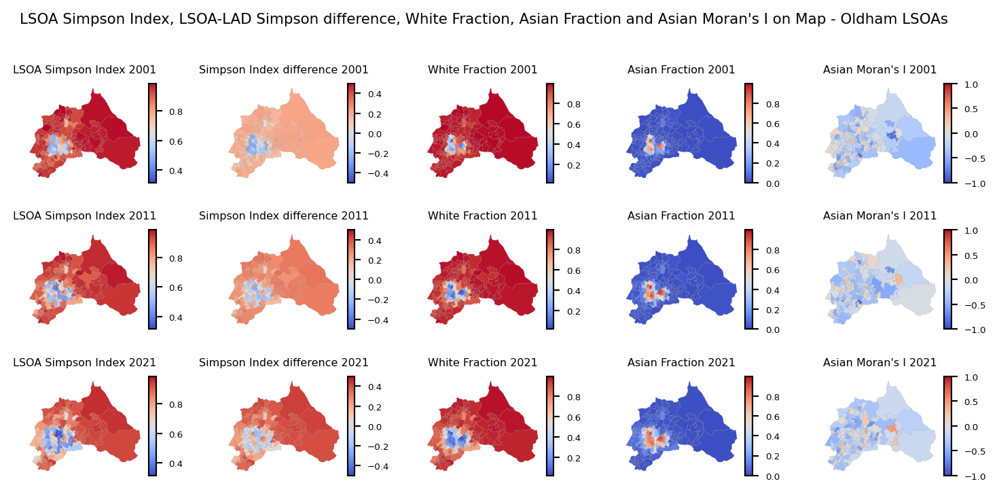

In [132]:
#| echo: false
#| label: fig-lsoaolhmmap
#| fig-cap: LSOA Simpson Index, White and Asian Fraction and Asian Moran's I on Map - Oldham LSOAs

years = [2001, 2011, 2021]

lsoa_simpson_min, lsoa_simpson_max = oldham_LSOA['LSOA_simpson'].min(), oldham_LSOA['LSOA_simpson'].max()
white_fraction_min, white_fraction_max = oldham_LSOA['white_fraction'].min(), oldham_LSOA['white_fraction'].max()

# Reverse the colormap for the last column
fig, axes = plt.subplots(nrows=3, ncols=5, figsize=(8, 8))

# Flatten the axes array for easier iteration
axes = axes.flatten()

# Variables and titles for the plots
variables = [
    ('LSOA_simpson', lsoa_simpson_min, lsoa_simpson_max, 'LSOA Simpson Index', 'coolwarm'),
    ('simp_diff', -0.5,0.5, 'Simpson Index difference', 'coolwarm'),
    ('white_fraction', white_fraction_min, white_fraction_max, 'White Fraction', 'coolwarm'),
    ('asian_fraction', asian_fraction_min, asian_fraction_max, 'Asian Fraction', 'coolwarm'),
    ('asian_moran', -1, 1, "Asian Moran's I", 'coolwarm')
    
]

# Loop through years and variables to plot the maps
for j, year in enumerate(years):
    for i, (variable, min_val, max_val, title, cmap) in enumerate(variables):
        # Filter data for the given year
        data_year = oldham_LSOA[oldham_LSOA['year'] == year]

        # Determine the correct subplot index
        ax_index = j * 5 + i
        
        # Plot the variable
        ax = axes[ax_index]
        divider = make_axes_locatable(ax)
        cax = divider.append_axes("right", size="3.5%", pad=-0.3)
        data_year.plot(column=variable, cmap=cmap, linewidth=0.05, ax=ax, edgecolor='0.5',
                       vmin=min_val, vmax=max_val, legend=False)

        # Manually create the colorbar
        norm = plt.Normalize(vmin=min_val, vmax=max_val)
        cbar = plt.colorbar(plt.cm.ScalarMappable(norm=norm, cmap=cmap), cax=cax)
        cbar.ax.tick_params(labelsize=5)

        ax.set_title(f'{title} {year}', fontsize=6)
        ax.axis('off')


fig.suptitle('LSOA Simpson Index, LSOA-LAD Simpson difference, White Fraction, Asian Fraction and Asian Moran\'s I on Map - Oldham LSOAs', 
             fontsize=8, y=0.72)

# Adjust layout
plt.subplots_adjust(hspace=-0.85)
plt.tight_layout(rect=[0, 0, 1, 0.96])
plt.show()

### Oldham Map – MSOA Level
<p style="text-align: justify;">
@fig-msoaolhmmap shows the Simpson Index for each MSOA and its difference from the town-wide Simpson Index in Blackburn with Darwen. At this level, changes in the MSOA Simpson Index are more evident, especially in the western part of the city. By examining the OA-based Asian Moran's I index on the map, a positive value is noticeable in the western part of the city in 2001 and 2011, and in the western and southern parts in 2021, indicating a clustering of the Asian population in those areas. However, the LSOA-based Asian Moran's I index is mostly negative, with some positive values in western MSOAs.
</p>

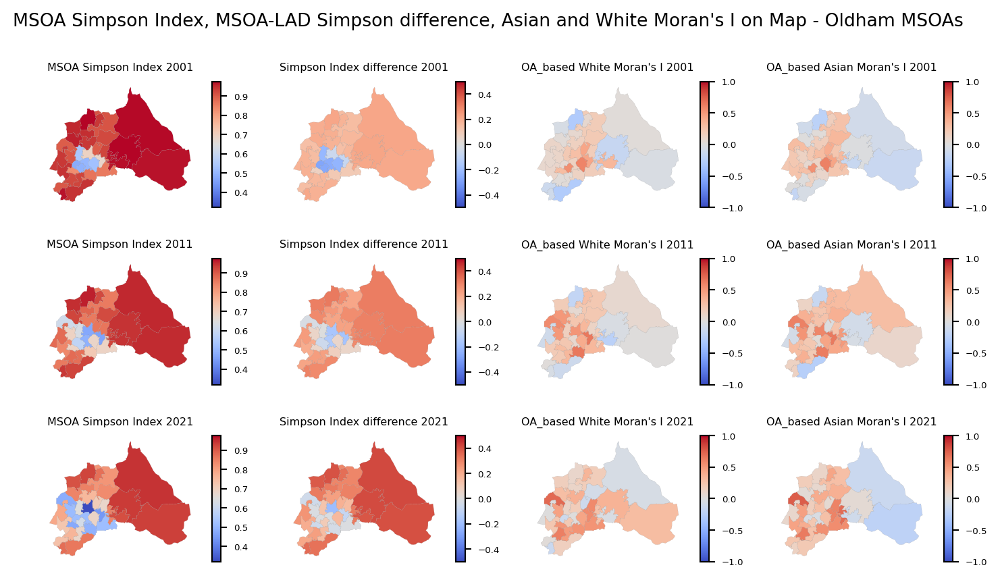

In [133]:
#| echo: false
#| label: fig-msoaolhmmap
#| fig-cap: MSOA Simpson Index, MSOA-LAD Simpson difference, Asian and White Moran's I on Map - Oldham MSOAs

years = [2001, 2011, 2021]

msoa_simpson_min, msoa_simpson_max = oldham_MSOA['MSOA_simpson'].min(), oldham_MSOA['MSOA_simpson'].max()

# Reverse the colormap for the last column
fig, axes = plt.subplots(nrows=3, ncols=4, figsize=(8, 8))

# Flatten the axes array for easier iteration
axes = axes.flatten()

# Variables and titles for the plots
variables = [
    ('MSOA_simpson', msoa_simpson_min, msoa_simpson_max, 'MSOA Simpson Index', 'coolwarm'),
    ('simp_diff', -0.5,0.5, 'Simpson Index difference', 'coolwarm'),
    ('asian_moran_OA', -1, 1, "OA_based White Moran's I", 'coolwarm'),
    ('white_moran_OA', -1, 1, "OA_based Asian Moran's I", 'coolwarm')
    
]

# Loop through years and variables to plot the maps
for j, year in enumerate(years):
    for i, (variable, min_val, max_val, title, cmap) in enumerate(variables):
        # Filter data for the given year
        data_year = oldham_MSOA[oldham_MSOA['year'] == year]

        # Determine the correct subplot index
        ax_index = j * 4 + i
        
        # Plot the variable
        ax = axes[ax_index]
        divider = make_axes_locatable(ax)
        cax = divider.append_axes("right", size="3.5%", pad=-0.3)
        data_year.plot(column=variable, cmap=cmap, linewidth=0.05, ax=ax, edgecolor='0.5',
                       vmin=min_val, vmax=max_val, legend=False)
        
        # Manually create the colorbar
        norm = plt.Normalize(vmin=min_val, vmax=max_val)
        cbar = plt.colorbar(plt.cm.ScalarMappable(norm=norm, cmap=cmap), cax=cax)
        cbar.ax.tick_params(labelsize=5)

        ax.set_title(f'{title} {year}', fontsize=6)
        ax.axis('off')


fig.suptitle('MSOA Simpson Index, MSOA-LAD Simpson difference, Asian and White Moran\'s I on Map - Oldham MSOAs', 
             fontsize=10, y=0.76)

# Adjust layout
plt.subplots_adjust(hspace=-0.75)
plt.tight_layout(rect=[0, 0, 1, 0.96])
plt.show()

### Oldham Correlations Heatmap
<p style="text-align: justify;">
@fig-olhmheatmap illustrates the linear correlation between the LSOA Simpson Index and the ethnicity fractions in each LSOA. A pattern similar to other cities can be observed, where a decrease in the White fraction correlates with a decrease in the LSOA Simpson Index.
</p>

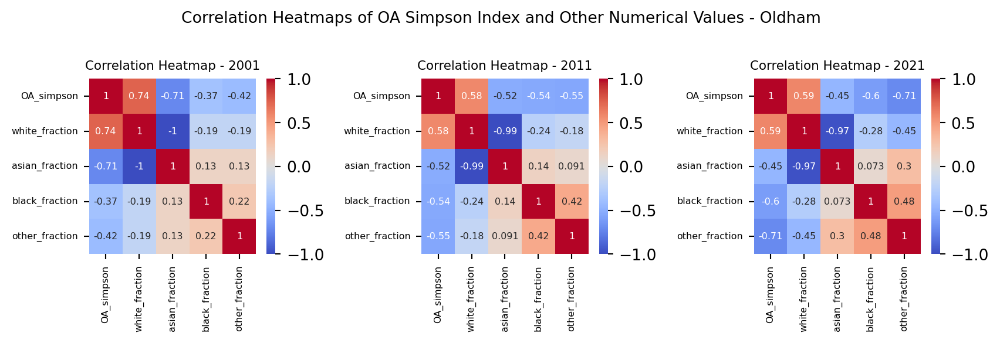

In [134]:
#| echo: false
#| label: fig-olhmheatmap
#| fig-cap: Correlation Heatmap - Oldham MSOAs
numerical_columns = ['OA_simpson', 'white_fraction', 'asian_fraction', 'black_fraction', 'other_fraction']

years = [2001, 2011, 2021]

correlation_dic = {}
for year in years:
    # Filter data for the specific year
    corr_df = oldham_OA[oldham_OA['year'] == year][numerical_columns]
    correlation_matrix = corr_df.corr()
    correlation_dic[year] = correlation_matrix

fig, axes = plt.subplots(1, 3, figsize=(9, 3))

# Plot each heatmap in a subplot
for i, year in enumerate(years):
    ax = axes[i]
    sns.heatmap(correlation_dic[year], annot=True, cmap='coolwarm', vmin=-1, vmax=1, ax=ax, annot_kws={"size": 6})
    ax.set_title(f'Correlation Heatmap - {year}', fontsize=8)
    ax.tick_params(axis='x', labelsize=6)
    ax.tick_params(axis='y', labelsize=6) 

# Adjust layout
plt.tight_layout(rect=[0, 0, 1, 0.96])
plt.suptitle('Correlation Heatmaps of OA Simpson Index and Other Numerical Values - Oldham', fontsize=10, y=1)
plt.tight_layout()
plt.show()


## Pendle
<p style="text-align: justify;" >
Pendle is a local government district in Northwest England. As shown in @fig-pndlethnicpop, between the last two censuses (held in 2011 and 2021), the population of Pendle increased by 7.0%, from around 89,321 in 2011 to around 95,804 in 2021. During this period, the population of the white ethnic group decreased from 75,814 to 67,590 while the population of Asian ethnic group doubled from 12,765 in 2001 to 25,600 in 2021. As depicted in @fig-pndlfracoverview, the fraction of the white ethnic group decreased from 84.90% in 2001 to 70.60% in 2021 and the Asian fraction increased from 14.30% in 2001 to 26.70% in 2021.
</p>

In [135]:
#| include: false
pendle_indexes = LAD_total[LAD_total['LADNM'].str.contains('Pendle')].reset_index(drop= True)
pendle_indexes['total_population']= (pendle_indexes['white']+pendle_indexes['asian'] + 
                                        pendle_indexes['black']+pendle_indexes['other'])
cols = list(pendle_indexes.columns)
cols.insert(7, cols.pop(cols.index('total_population')))
pendle_indexes = pendle_indexes[cols]
pendle_indexes

,year,LADCD,LADNM,white,asian,black,other,total_population,white_frac,asian_frac,...,MSOA_white_mor,OA_asian_mor,LSOA_asian_mor,MSOA_asian_mor,OA_black_mor,LSOA_black_mor,MSOA_black_mor,OA_other_mor,LSOA_other_mor,MSOA_other_mor
0,2001,E07000122,Pendle,75814,12765,111,631,89321,0.849,0.143,...,0.311,0.664,0.525,0.305,0.047,0.058,0.182,0.088,0.350,0.509
1,2011,E07000122,Pendle,71437,16807,126,1082,89452,0.799,0.188,...,0.403,0.735,0.655,0.398,0.046,0.131,-0.051,0.221,0.480,0.419
2,2021,E07000122,Pendle,67590,25600,242,2372,95804,0.706,0.267,...,0.432,0.813,0.739,0.427,0.031,0.252,0.150,0.291,0.574,0.455


In [136]:
#| include: false
# creating Pendle dataframe
pendle_2001= pd.read_csv('preprocessed files/2001/pendle_2001.csv')
pendle_2011= pd.read_csv('preprocessed files/2011/pendle_2011.csv')
pendle_2021= pd.read_csv('preprocessed files/2021/pendle_2021.csv')
pendle_2001['simp_diff'] = pendle_2001['OA_simpson']- pendle_indexes.LAD_simpson[0]
pendle_2011['simp_diff'] = pendle_2011['OA_simpson']- pendle_indexes.LAD_simpson[1]
pendle_2021['simp_diff'] = pendle_2021['OA_simpson']- pendle_indexes.LAD_simpson[2]

pendle_LSOA_2001= pd.read_csv('preprocessed files/2001/pendle_LSOA_2001.csv')
pendle_LSOA_2011= pd.read_csv('preprocessed files/2011/pendle_LSOA_2011.csv')
pendle_LSOA_2021= pd.read_csv('preprocessed files/2021/pendle_LSOA_2021.csv')
pendle_LSOA_2001['simp_diff'] = pendle_LSOA_2001['LSOA_simpson']- pendle_indexes.LAD_simpson[0]
pendle_LSOA_2011['simp_diff'] = pendle_LSOA_2011['LSOA_simpson']- pendle_indexes.LAD_simpson[1]
pendle_LSOA_2021['simp_diff'] = pendle_LSOA_2021['LSOA_simpson']- pendle_indexes.LAD_simpson[2]

pendle_MSOA_2001= pd.read_csv('preprocessed files/2001/pendle_MSOA_2001.csv')
pendle_MSOA_2011= pd.read_csv('preprocessed files/2011/pendle_MSOA_2011.csv')
pendle_MSOA_2021= pd.read_csv('preprocessed files/2021/pendle_MSOA_2021.csv')
pendle_MSOA_2001['simp_diff'] = pendle_MSOA_2001['MSOA_simpson']- pendle_indexes.LAD_simpson[0]
pendle_MSOA_2011['simp_diff'] = pendle_MSOA_2011['MSOA_simpson']- pendle_indexes.LAD_simpson[1]
pendle_MSOA_2021['simp_diff'] = pendle_MSOA_2021['MSOA_simpson']- pendle_indexes.LAD_simpson[2]

pendle= pd.concat([pendle_2001,pendle_2011,pendle_2021]).reset_index(drop=True)
pendle.insert(9, 'simp_diff', pendle.pop('simp_diff'))

# Converting the dataframe into GPD
pendle['geometry'] = pendle['geometry'].apply(wkt.loads)
pendle = gpd.GeoDataFrame(pendle, geometry='geometry')

pendle_center = {"lat": 53.8695, "lon": -2.1640}

In [137]:
#| include: false
# Creating df for OA level
pendle_OA = pendle.drop(['LSOACD', 'MSOACD', 'LADCD', 'LSOANM', 'MSOANM'], axis= 1)
pendle_OA = pendle_OA.set_crs(epsg=27700)
pendle_OA = pendle_OA.to_crs(epsg=4326) 

In [138]:
#| include: false
# Creating df for LSOA level
pendle_LSOA= pd.concat([pendle_LSOA_2001,pendle_LSOA_2011,pendle_LSOA_2021]).reset_index(drop=True)
pendle_LSOA.insert(3, 'simp_diff', pendle_LSOA.pop('simp_diff'))

pendle_LSOA['geometry'] = pendle_LSOA['geometry'].apply(wkt.loads)
pendle_LSOA = gpd.GeoDataFrame(pendle_LSOA, geometry='geometry')

pendle_LSOA = pendle_LSOA.set_crs(epsg=27700)
pendle_LSOA = pendle_LSOA.to_crs(epsg=4326)

In [139]:
#| include: false
# Creating df for MSOA level
pendle_MSOA= pd.concat([pendle_MSOA_2001,pendle_MSOA_2011,pendle_MSOA_2021]).reset_index(drop=True)
pendle_MSOA.insert(3, 'simp_diff', pendle_MSOA.pop('simp_diff'))

pendle_MSOA['geometry'] = pendle_MSOA['geometry'].apply(wkt.loads)
pendle_MSOA = gpd.GeoDataFrame(pendle_MSOA, geometry='geometry')

pendle_MSOA = pendle_MSOA.set_crs(epsg=27700)
pendle_MSOA = pendle_MSOA.to_crs(epsg=4326)

In [140]:
#| echo: false
#| label: fig-pndlethnicpop
#| fig-cap: Ethnicity and Total Population Line Chart - Pendle
# Ethnicity and Total Population Line Chart - Pendle

pendle_long= pendle_indexes[['year','white', 'asian', 'black', 'other']].melt(id_vars=['year'], 
                                                                                      var_name='ethnicity',
                                                                                      value_name='population',)

# Create subplots
fig = make_subplots(rows=2, cols=1, subplot_titles=("Ethnicity Population - Pendle", "Total Population - Pendle"),
                     vertical_spacing=0.15)

# Add traces for ethnicity populations
offsets = {
    'white': (10, 30),
    'asian': (10, -10),
    'black': (10, 30),
    'other': (10, -10)
}

for ethnicity in pendle_long['ethnicity'].unique():
    trace = go.Scatter(
        x=pendle_long[pendle_long['ethnicity'] == ethnicity]['year'],
        y=pendle_long[pendle_long['ethnicity'] == ethnicity]['population'],
        mode='lines+markers',
        name=ethnicity,
        legendgroup=ethnicity 
    )
    fig.add_trace(trace, row=1, col=1)
    
    # Add annotations with custom offsets for each ethnicity
    for i, row in pendle_long[pendle_long['ethnicity'] == ethnicity].iterrows():
        ax, ay = offsets.get(ethnicity, (0, 0)) 
        fig.add_annotation(
            x=row['year'],
            y=row['population'],
            text=f"{row['population']:,}",
            showarrow=True,
            arrowhead=0,
            ax=ax,
            ay=ay,
            font=dict(size=10),
            xanchor='center',
            yanchor='bottom',
            row=1,
            col=1
        )

# Add trace for total population in the second subplot
total_population_trace = go.Scatter(
    x=pendle_indexes['year'],
    y=pendle_indexes['total_population'],
    mode='lines+markers',
    name='Total Population',
    line=dict(color='black')
)
fig.add_trace(total_population_trace, row=2, col=1)

# Add annotations for total population
for i, row in pendle_indexes.iterrows():
    fig.add_annotation(
        x=row['year'],
        y=row['total_population'],
        text=f"{row['total_population']:,}",
        showarrow=True,
        arrowhead=0,
        ax=0,
        ay=-20,
        font=dict(size=10),
        xanchor='center',
        yanchor='bottom',
        row=2,
        col=1
    )

# Update x-axis and y-axis titles
fig.update_xaxes(title_text="Year", row=1, col=1)
fig.update_yaxes(title_text="Ethnicity Population", row=1, col=1)
fig.update_xaxes(title_text="Year", row=1, col=2)
fig.update_yaxes(title_text="Total Population", row=1, col=2)

# Update layout
fig.update_layout(
    height=700, 
    width=650, 
    title_text="Ethnicity and Total Population Line Chart - Pendle",
    title_x=0.5,
    title_y=0.96,
    showlegend=True,
    legend=dict(orientation="h", yanchor="top", y= 1.1, xanchor="center", x=0.5)
    )

# Display the figure
pyo.iplot(fig)


In [141]:
#| echo: false
#| label: fig-pndlfracoverview
#| fig-cap: Ethnic Group Fractions Over Time - Pendle
# Ethnic Group Fractions Over Time - Pendle

fig = go.Figure()

# Add traces for each ethnic group fraction as stacked bars with percentage annotations outside
fig.add_trace(go.Bar(x=pendle_indexes['year'], y=pendle_indexes['white_frac'], 
                     name='White', legendgroup='ethnic_group', width=4, marker=dict(color='gray'),
                     text=pendle_indexes['white_frac'] * 100, textposition='outside', 
                     texttemplate='%{text:.2f}%'))
fig.add_trace(go.Bar(x=pendle_indexes['year'], y=pendle_indexes['asian_frac'], 
                     name='Asian', legendgroup='ethnic_group', width=4, marker=dict(color='orange'),
                     text=pendle_indexes['asian_frac'] * 100, textposition='outside', 
                     texttemplate='%{text:.2f}%'))
fig.add_trace(go.Bar(x=pendle_indexes['year'], y=pendle_indexes['black_frac'], 
                     name='Black', legendgroup='ethnic_group', width=4, marker=dict(color='black'),
                     text=pendle_indexes['black_frac'] * 100, textposition='outside', 
                     texttemplate='%{text:.2f}%'))
fig.add_trace(go.Bar(x=pendle_indexes['year'], y=pendle_indexes['other_frac'], 
                     name='Other', legendgroup='ethnic_group', width=4, marker=dict(color='green'),
                     text=pendle_indexes['other_frac'] * 100, textposition='inside', 
                     texttemplate='%{text:.2f}%'))

# Update layout
fig.update_layout(title_text="Ethnic Group Fractions Over Time - Pendle ",
                  title_x=0.5,
                  title_y=0.9,
                  title_font=dict(size=16),
                  xaxis_title='Year',
                  xaxis=dict(tickvals=[2001, 2011, 2021]),
                  yaxis_title='Ethnicity Fraction',
                  yaxis=dict(
                      title='Ethnicity Fraction',
                      side='left'),
                  barmode='relative',
                  hovermode='x unified',
                  width=600,
                  height=500,
                  legend=dict(orientation="h",
                              yanchor="top",
                              y=1.1,
                              xanchor="center",
                              x=0.5,
                              traceorder='normal'))

# Display the figure
pyo.iplot(fig)

In [142]:
#| include: false
# #| echo: false
# #| label: fig-pndlsimp
# #| fig-cap: Simpson Index Line Chart - Pendle

# pendle_long= pendle_indexes[['year','OA_simpson', 'LSOA_simpson', 'MSOA_simpson', 'LAD_simpson']].melt(id_vars=['year'], var_name='level', value_name='simpson_index')

# traces = []
# for level in pendle_long['level'].unique():
#     trace = go.Scatter(
#         x= pendle_long[pendle_long['level'] == level]['year'],
#         y= pendle_long[pendle_long['level'] == level]['simpson_index'],
#         mode='lines+markers',
#         name=level
#     )
#     traces.append(trace)

# layout = go.Layout(title_text="Simpson Index Line Chart - Pendle",
#                     title_x=0.5,
#                     title_font=dict(size=16),
#                     xaxis=dict(title='Year', tickvals=pendle_long['year'].unique()),
#                     yaxis=dict(title='Simpson Index'),
#                     legend=dict(orientation="h",
#                                 yanchor="top",
#                                 y=1.2,
#                                 xanchor="center",
#                                 x=0.5),
#                     hovermode='closest',
#                     showlegend=True,
#                     height = 400,
#                     width = 700
# )

# fig = go.Figure(data=traces, layout=layout)

# pyo.iplot(fig)

In [143]:
#| include: false
# #| echo: false
# #| label: fig-pndloamap
# #| fig-cap: OA Simpson Index by Year in Pendle
# # OA Simpson Index by Year in Pendle

# fig = px.choropleth_mapbox(pendle_OA,
#                            geojson=pendle_OA.geometry,
#                            locations=pendle_OA.index,
#                            color='OA_simpson',
#                            animation_frame='year',
#                            color_continuous_scale=px.colors.diverging.RdBu[::-1],
#                            range_color=(0, 1),
#                            hover_name='OACD',
#                            hover_data={'white_fraction': True},
#                            labels={'OA_simpson': 'OA Simpson Index',
#                                    'white_fraction': 'White Fraction'},
#                            title='OA Simpson Index by Year in Pendle',
#                            center=pendle_center,
#                            zoom=10,
#                            mapbox_style='carto-positron'
#                            )

# # Customize the layout
# fig.update_layout(margin={"r":0,"t":40,"l":0,"b":0}, title_x=0.5,
#                   width=800,
#                   height=800 
#     )

# # Display the map
# fig.show()

In [144]:
#| include: false
# #| echo: false
# #| label: fig-pndllsoamap
# #| fig-cap: LSOA Simpson Index by Year in Pendle
# # LSOA Simpson Index by Year in Pendle

# fig = px.choropleth_mapbox(pendle_LSOA,
#                            geojson=pendle_LSOA.geometry,
#                            locations=pendle_LSOA.index,
#                            color='LSOA_simpson',
#                            animation_frame='year',
#                            color_continuous_scale=px.colors.diverging.RdBu[::-1],
#                            range_color=(0, 1),
#                            hover_name='LSOACD',
#                            hover_data={'white_fraction': True},
#                            labels={'LSOA_simpson': 'LSOA Simpson Index',
#                                    'white_fraction': 'White Fraction'},
#                            title='LSOA Simpson Index by Year in Pendle',
#                            center=pendle_center,
#                            zoom=10,
#                            mapbox_style='carto-positron'
#                            )

# # Customize the layout
# fig.update_layout(margin={"r":0,"t":40,"l":0,"b":0}, title_x=0.5,
#                   width=800,
#                   height=800 
#     )

# # Display the map
# fig.show()

In [145]:
#| include: false
# #| echo: false
# #| label: fig-pndlmsoamap
# #| fig-cap: MSOA Simpson Index by Year in Pendle
# # mSOA Simpson Index by Year in Pendle

# fig = px.choropleth_mapbox(pendle_MSOA,
#                            geojson=pendle_MSOA.geometry,
#                            locations=pendle_MSOA.index,
#                            color='MSOA_simpson',
#                            animation_frame='year',
#                            color_continuous_scale=px.colors.diverging.RdBu[::-1],
#                            range_color=(0, 1),
#                            hover_name='MSOACD',
#                            hover_data={'white_fraction': True},
#                            labels={'MSOA_simpson': 'MSOA Simpson Index',
#                                    'white_fraction': 'White Fraction'},
#                            title='MSOA Simpson Index by Year in Pendle',
#                            center=pendle_center,
#                            zoom=10,
#                            mapbox_style='carto-positron'
#                            )

# # Customize the layout
# fig.update_layout(margin={"r":0,"t":40,"l":0,"b":0}, title_x=0.5,
#                   width=800,
#                   height=800 
#     )

# # Display the map
# fig.show()

In [146]:
#| include: false
# #| echo: false
# #| label: fig-pndllsoamormap
# #| fig-cap: Moran's I Index by Year in Pendle LSOAs
# # Moran's I Index by Year in Pendle LSOAs

# ethnicity = 'white'
# fig = px.choropleth_mapbox(pendle_LSOA,
#                            geojson=pendle_LSOA.geometry,
#                            locations=pendle_LSOA.index,
#                            color=f'{ethnicity}_moran',
#                            animation_frame='year',
#                            color_continuous_scale=px.colors.diverging.RdBu[::-1],
#                            range_color=(-1, 1),
#                            hover_name='LSOACD',
#                            hover_data={f'{ethnicity}_fraction': True},
#                            labels={f'{ethnicity}_moran': f'{ethnicity.capitalize()} Moran Index',
#                                    f'{ethnicity}_fraction': f'{ethnicity.capitalize()} Fraction'},
#                            title="Moran's I Index by Year in Pendle LSOAs",
#                            center=pendle_center,
#                            zoom=10,
#                            mapbox_style='carto-positron'
#                            )

# # Customize the layout
# fig.update_layout(margin={"r":0,"t":40,"l":0,"b":0}, title_x=0.5,
#                   width=800,
#                   height=800 
#     )

# # Display the map
# fig.show()

In [147]:
#| include: false
# #| echo: false
# #| label: fig-pndlmsoamormapoa
# #| fig-cap: OA-based Moran's I Index by Year in Pendle MSOAs
# # OA-based Moran's I Index by Year in Pendle MSOAs
# ethnicity = 'white'
# fig = px.choropleth_mapbox(pendle_MSOA,
#                            geojson=pendle_MSOA.geometry,
#                            locations=pendle_MSOA.index,
#                            color=f'{ethnicity}_moran_OA',
#                            animation_frame='year',
#                            color_continuous_scale=px.colors.diverging.RdBu[::-1],
#                            range_color=(-1, 1),
#                            hover_name='MSOACD',
#                            hover_data={f'{ethnicity}_fraction': True},
#                            labels={f'{ethnicity}_moran_OA': f'OA-based {ethnicity.capitalize()} Moran Index',
#                                    f'{ethnicity}_fraction': f'{ethnicity.capitalize()} Fraction'},
#                            title="OA-based Moran's I Index by Year in Pendle MSOAs",
#                            center=pendle_center,
#                            zoom=10,
#                            mapbox_style='carto-positron'
#                            )

# # Customize the layout
# fig.update_layout(margin={"r":0,"t":40,"l":0,"b":0}, title_x=0.5,
#                   width=870,
#                   height=800 
#     )

# # Display the map
# fig.show()

In [148]:
#| include: false
# #| echo: false
# #| label: fig-pndlmsoamormaplsoa
# #| fig-cap: LSOA-based Moran's I Index by Year in Pendle MSOAs
# # LSOA-based Moran's I Index by Year in Pendle MSOAs

# ethnicity = 'white'
# fig = px.choropleth_mapbox(pendle_MSOA,
#                            geojson=pendle_MSOA.geometry,
#                            locations=pendle_MSOA.index,
#                            color=f'{ethnicity}_moran_LSOA',
#                            animation_frame='year',
#                            color_continuous_scale=px.colors.diverging.RdBu[::-1],
#                            range_color=(-1, 1),
#                            hover_name='MSOACD',
#                            hover_data={f'{ethnicity}_fraction': True},
#                            labels={f'{ethnicity}_moran_LSOA': f'LSOA-based {ethnicity.capitalize()} Moran Index',
#                                    f'{ethnicity}_fraction': f'{ethnicity.capitalize()} Fraction'},
#                            title="LSOA-based Moran's I Index by Year in Pendle MSOAs",
#                            center=pendle_center,
#                            zoom=10,
#                            mapbox_style='carto-positron'
#                            )

# # Customize the layout
# fig.update_layout(margin={"r":0,"t":40,"l":0,"b":0}, title_x=0.5,
#                   width=950,
#                   height=800 
#     )

# # Display the map
# fig.show()

### Pendle Map – OA Level
<p style="text-align: justify;">
@fig-oapndlmap shows the Simpson Index for each OA and its difference from the town-wide Simpson Index in Pendle. In the first column, OAs Simpson Index is decreasing in northern and southern areas, while increasing in some central areas expanded from east to west. However, the Simpson Index difference plot shows an increase in all areas. As observed from the White and Asian fractions map, the OAs in the southern areas have a lower White fraction and a higher Asian fraction.
</p>

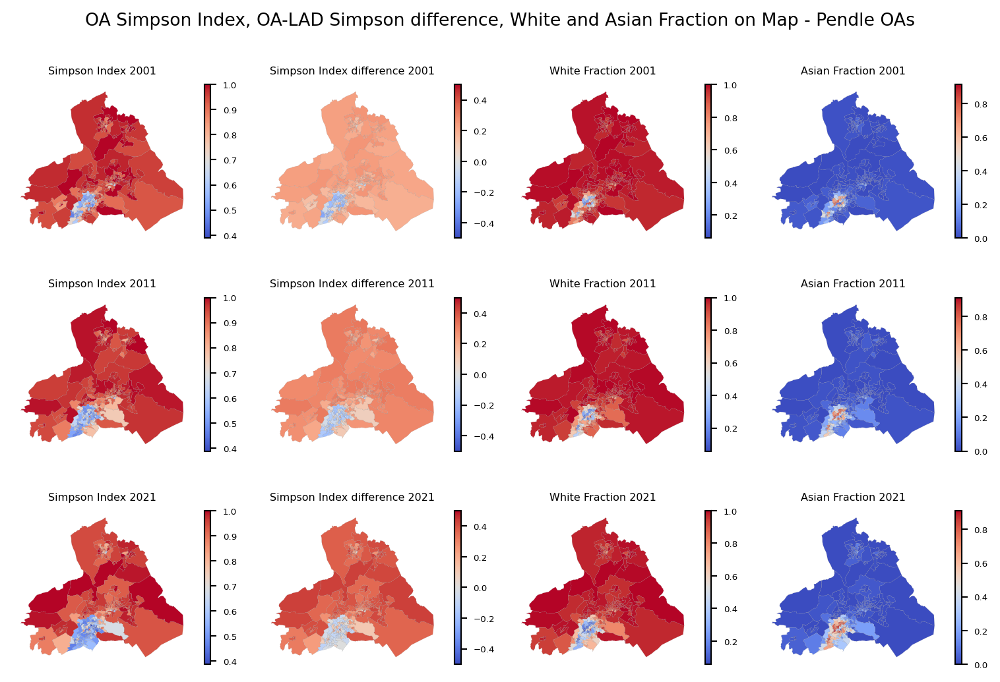

In [149]:
#| echo: false
#| label: fig-oapndlmap
#| fig-cap: OA Simpson Index, White and Asian Fraction and Asian Moran's I on Map - Pendle OAs

years = [2001, 2011, 2021]

oa_simpson_min, oa_simpson_max = pendle['OA_simpson'].min(), pendle['OA_simpson'].max()
white_fraction_min, white_fraction_max = pendle['white_fraction'].min(), pendle['white_fraction'].max()
asian_fraction_min, asian_fraction_max = pendle['asian_fraction'].min(), pendle['asian_fraction'].max()

# Reverse the colormap for the last column
fig, axes = plt.subplots(nrows=3, ncols=4, figsize=(8, 8))

# Flatten the axes array for easier iteration
axes = axes.flatten()

# Variables and titles for the plots
variables = [
    ('OA_simpson', oa_simpson_min, oa_simpson_max, 'Simpson Index', 'coolwarm'),
    ('simp_diff', -0.5,0.5, 'Simpson Index difference', 'coolwarm'),
    ('white_fraction', white_fraction_min, white_fraction_max, 'White Fraction', 'coolwarm'),
    ('asian_fraction', asian_fraction_min, asian_fraction_max, 'Asian Fraction', 'coolwarm'),
]

# Loop through years and variables to plot the maps
for j, year in enumerate(years):
    for i, (variable, min_val, max_val, title, cmap) in enumerate(variables):
        # Filter data for the given year
        data_year = pendle[pendle['year'] == year]

        # Determine the correct subplot index
        ax_index = j * 4 + i
        
        # Plot the variable
        ax = axes[ax_index]
        divider = make_axes_locatable(ax)
        cax = divider.append_axes("right", size="3.5%", pad=0.1)
        data_year.plot(column=variable, cmap=cmap, linewidth=0.05, ax=ax, edgecolor='0.5',
                       vmin=min_val, vmax=max_val, legend=False)
        # Manually create the colorbar
        norm = plt.Normalize(vmin=min_val, vmax=max_val)
        cbar = plt.colorbar(plt.cm.ScalarMappable(norm=norm, cmap=cmap), cax=cax)
        cbar.ax.tick_params(labelsize=5)

        ax.set_title(f'{title} {year}', fontsize=6)
        ax.axis('off')

fig.suptitle('OA Simpson Index, OA-LAD Simpson difference, White and Asian Fraction on Map - Pendle OAs',
             fontsize=10, y=0.82)

# Adjust layout
plt.subplots_adjust(hspace=-0.6)
plt.tight_layout(rect=[0, 0, 1, 0.96])
plt.show()

### Pendle Map – LSOA Level
<p style="text-align: justify;">
@fig-lsoapndlmap shows the Simpson Index for each LSOA in Pendle and its difference from the town-wide Simpson Index. In the right-side column of the plot, the Asian Moran's I index for each LSOA is displayed. Based on the plot, the predominant value for the Asian Moran's I index is negative or close to zero, indicating no significant clustering or dispersion of the Asian population in OAs within LSOAs.
</p>

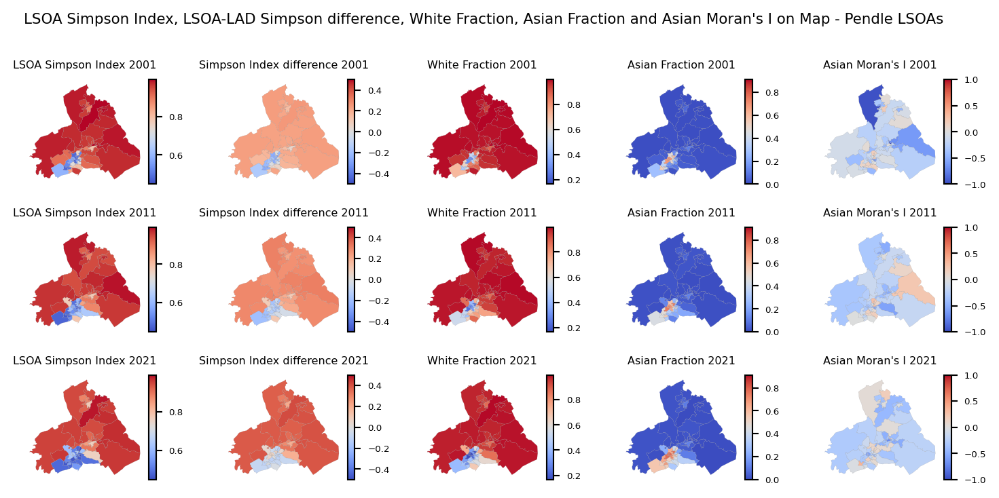

In [150]:
#| echo: false
#| label: fig-lsoapndlmap
#| fig-cap: LSOA Simpson Index, White and Asian Fraction and Asian Moran's I on Map - Pendle LSOAs

years = [2001, 2011, 2021]

lsoa_simpson_min, lsoa_simpson_max = pendle_LSOA['LSOA_simpson'].min(), pendle_LSOA['LSOA_simpson'].max()
white_fraction_min, white_fraction_max = pendle_LSOA['white_fraction'].min(), pendle_LSOA['white_fraction'].max()

# Reverse the colormap for the last column
fig, axes = plt.subplots(nrows=3, ncols=5, figsize=(8, 8))

# Flatten the axes array for easier iteration
axes = axes.flatten()

# Variables and titles for the plots
variables = [
    ('LSOA_simpson', lsoa_simpson_min, lsoa_simpson_max, 'LSOA Simpson Index', 'coolwarm'),
    ('simp_diff', -0.5,0.5, 'Simpson Index difference', 'coolwarm'),
    ('white_fraction', white_fraction_min, white_fraction_max, 'White Fraction', 'coolwarm'),
    ('asian_fraction', asian_fraction_min, asian_fraction_max, 'Asian Fraction', 'coolwarm'),
    ('asian_moran', -1, 1, "Asian Moran's I", 'coolwarm')
    
]

# Loop through years and variables to plot the maps
for j, year in enumerate(years):
    for i, (variable, min_val, max_val, title, cmap) in enumerate(variables):
        # Filter data for the given year
        data_year = pendle_LSOA[pendle_LSOA['year'] == year]

        # Determine the correct subplot index
        ax_index = j * 5 + i
        
        # Plot the variable
        ax = axes[ax_index]
        divider = make_axes_locatable(ax)
        cax = divider.append_axes("right", size="3.5%", pad=-0.3)
        data_year.plot(column=variable, cmap=cmap, linewidth=0.05, ax=ax, edgecolor='0.5',
                       vmin=min_val, vmax=max_val, legend=True, cax=cax)

        # Manually create the colorbar
        norm = plt.Normalize(vmin=min_val, vmax=max_val)
        cbar = plt.colorbar(plt.cm.ScalarMappable(norm=norm, cmap=cmap), cax=cax)
        cbar.ax.tick_params(labelsize=5)

        ax.set_title(f'{title} {year}', fontsize=6)
        ax.axis('off')

fig.suptitle('LSOA Simpson Index, LSOA-LAD Simpson difference, White Fraction, Asian Fraction and Asian Moran\'s I on Map - Pendle LSOAs',
             fontsize=8, y=0.72)

# Adjust layout
plt.subplots_adjust(hspace=-0.85)
plt.tight_layout(rect=[0, 0, 1, 0.96])
plt.show()

### Pendle Map – MSOA Level
<p style="text-align: justify;">
@fig-msoapndlmap shows the Simpson Index for each MSOA and its difference from the town-wide Simpson Index in Pendle. In the first column of the plot, it can be observed that the Simpson Index is decreasing in the western MSOAs, while the decrease in the eastern parts is less noticeable. However, based on the second column, an increase in the difference between the MSOA Simpson Index and the town-wide Simpson Index is noticeable in these areas. On the map based on the OA-based Moran's I index, positive values are observed in the eastern part of the city in 2001 and 2011, as well as in the southeastern MSOA, indicating a significant clustering of the Asian population in those areas.
</p>

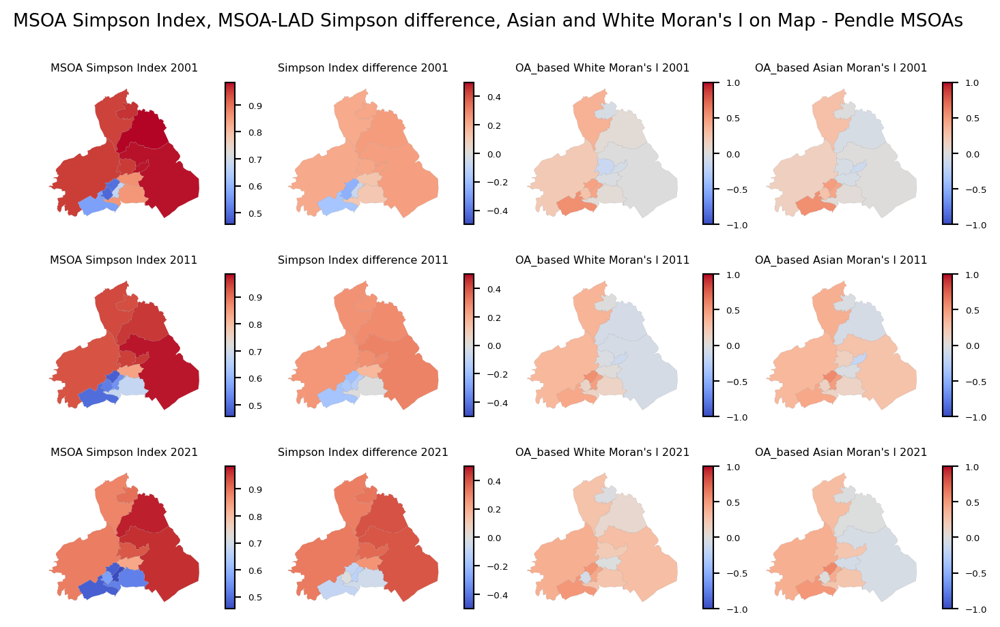

In [151]:
#| echo: false
#| label: fig-msoapndlmap
#| fig-cap: MSOA Simpson Index, MSOA-LAD Simpson difference, Asian and White Moran's I on Map - Pendle MSOAs

years = [2001, 2011, 2021]

msoa_simpson_min, msoa_simpson_max = pendle_MSOA['MSOA_simpson'].min(), pendle_MSOA['MSOA_simpson'].max()

# Reverse the colormap for the last column
fig, axes = plt.subplots(nrows=3, ncols=4, figsize=(8, 8))

# Flatten the axes array for easier iteration
axes = axes.flatten()

# Variables and titles for the plots
variables = [
    ('MSOA_simpson', msoa_simpson_min, msoa_simpson_max, 'MSOA Simpson Index', 'coolwarm'),
    ('simp_diff', -0.5,0.5, 'Simpson Index difference', 'coolwarm'),
    ('asian_moran_OA', -1, 1, "OA_based White Moran's I", 'coolwarm'),
    ('white_moran_OA', -1, 1, "OA_based Asian Moran's I", 'coolwarm')
    
    
]

# Loop through years and variables to plot the maps
for j, year in enumerate(years):
    for i, (variable, min_val, max_val, title, cmap) in enumerate(variables):
        # Filter data for the given year
        data_year = pendle_MSOA[pendle_MSOA['year'] == year]

        # Determine the correct subplot index
        ax_index = j * 4 + i
        
        # Plot the variable
        ax = axes[ax_index]
        divider = make_axes_locatable(ax)
        cax = divider.append_axes("right", size="3.5%", pad=-0.3)
        data_year.plot(column=variable, cmap=cmap, linewidth=0.05, ax=ax, edgecolor='0.5',
                       vmin=min_val, vmax=max_val, legend=False)
        
        # Manually create the colorbar
        norm = plt.Normalize(vmin=min_val, vmax=max_val)
        cbar = plt.colorbar(plt.cm.ScalarMappable(norm=norm, cmap=cmap), cax=cax)
        cbar.ax.tick_params(labelsize=5)

        ax.set_title(f'{title} {year}', fontsize=6)
        ax.axis('off')


fig.suptitle('MSOA Simpson Index, MSOA-LAD Simpson difference, Asian and White Moran\'s I on Map - Pendle MSOAs', 
             fontsize=10, y=0.78)

# Adjust layout
plt.subplots_adjust(hspace=-0.8, wspace=-0.5)
plt.tight_layout(rect=[0, 0, 1, 0.96])
plt.show()

### Pendle Correlations Heatmap
<p style="text-align: justify;">
@fig-pndlheatmap illustrates the linear correlation between the LSOA Simpson Index and the ethnicity fractions in each LSOA. Compared to other cities studied, the correlation between the Simpson Index and the White fraction in Pendle is notable, as Pendle has the highest White fraction among them.
</p>

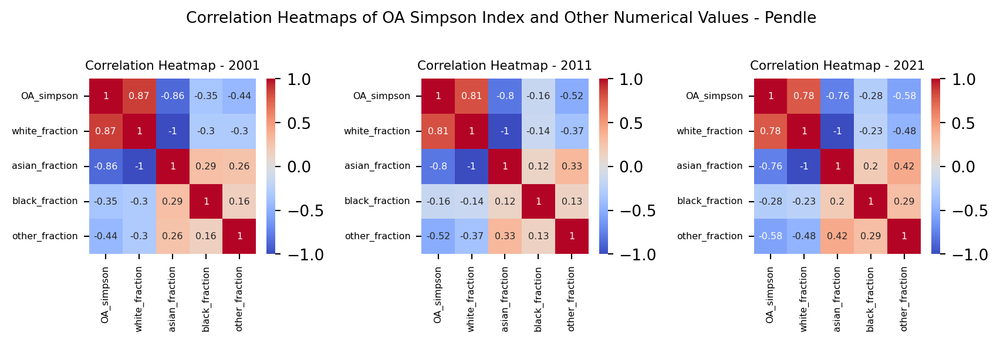

In [152]:
#| echo: false
#| label: fig-pndlheatmap
#| fig-cap: Correlation Heatmap - Pendle
numerical_columns = ['OA_simpson', 'white_fraction', 'asian_fraction', 'black_fraction', 'other_fraction']

years = [2001, 2011, 2021]

correlation_dic = {}
for year in years:
    # Filter data for the specific year
    corr_df = pendle_OA[pendle_OA['year'] == year][numerical_columns]
    correlation_matrix = corr_df.corr()
    correlation_dic[year] = correlation_matrix

fig, axes = plt.subplots(1, 3, figsize=(9, 3))

# Plot each heatmap in a subplot
for i, year in enumerate(years):
    ax = axes[i]
    sns.heatmap(correlation_dic[year], annot=True, cmap='coolwarm', vmin=-1, vmax=1, ax=ax, annot_kws={"size": 6})
    ax.set_title(f'Correlation Heatmap - {year}', fontsize=8)
    ax.tick_params(axis='x', labelsize=6)
    ax.tick_params(axis='y', labelsize=6) 

# Adjust layout
plt.tight_layout(rect=[0, 0, 1, 0.96])
plt.suptitle('Correlation Heatmaps of OA Simpson Index and Other Numerical Values - Pendle', fontsize=10, y=1)
plt.tight_layout()
plt.show()

## London
<p style="text-align: justify;" >
London, the capital of England and the United Kingdom, has become one of the most ethnically diverse and multicultural cities in the world. London is significantly more diverse than England as a whole. London consists of 33 LADs.
<p style="text-align: justify;" >
As shown in @fig-lndnethnicpop, between the last two censuses (held in 2011 and 2021), the population of Pendle increased by 7.0%, from 7,177,998 in 2001 to 8,799,882 in 2021. During this period, the population of the white ethnic group decreased from 5,103,176 to 4,731,247 while the population of Asian ethnic group increased from 1,059,689 in 2001 to 1,817,652 in 2021. London has the highest population pf black ethnicity (13.5% of its population) in the whole England. @fig-lndnfracoverview, 46.2% of Londoners are Minority Ethnic, compared to 18.3% of England as a whole. the fraction of the white ethnic group decreased from 84.90% in 2001 to 70.60% in 2021 and the Asian fraction increased from 14.30% in 2001 to 26.70% in 2021.
<p style="text-align: justify;" >

</p>

In [153]:
#| include: false
london_LAD_indexes = LAD_total[LAD_total.LADCD.str.extract('([a-zA-Z]+)([^a-zA-Z]+)', expand=True)[1].astype(int).between(9000001,9000034)].reset_index(drop= True)
london_LAD_indexes['total_population']= (london_LAD_indexes['white']+london_LAD_indexes['asian'] + 
                                        london_LAD_indexes['black']+london_LAD_indexes['other'])
cols = list(london_LAD_indexes.columns)
cols.insert(7, cols.pop(cols.index('total_population')))
london_LAD_indexes = london_LAD_indexes[cols]
london_LAD_indexes.head()

,year,LADCD,LADNM,white,asian,black,other,total_population,white_frac,asian_frac,...,MSOA_white_mor,OA_asian_mor,LSOA_asian_mor,MSOA_asian_mor,OA_black_mor,LSOA_black_mor,MSOA_black_mor,OA_other_mor,LSOA_other_mor,MSOA_other_mor
0,2001,E09000001,City of London,6074,763,169,161,7167,0.847,0.106,...,NaN,0.077,0.047,NaN,0.292,0.086,NaN,-0.087,0.085,NaN
1,2001,E09000002,Barking and Dagenham,139669,9762,11412,3087,163930,0.852,0.060,...,0.519,0.624,0.674,0.459,0.557,0.594,0.374,0.192,0.409,0.333
2,2001,E09000003,Barnet,232876,53226,18871,9440,314413,0.741,0.169,...,0.553,0.608,0.590,0.469,0.589,0.576,0.424,0.204,0.309,0.286
3,2001,E09000004,Bexley,199515,9699,6245,2856,218315,0.914,0.044,...,0.414,0.374,0.492,0.450,0.747,0.722,0.337,0.213,0.415,0.357
4,2001,E09000005,Brent,119281,81957,52303,9858,263399,0.453,0.311,...,0.738,0.775,0.790,0.688,0.668,0.759,0.535,0.129,0.360,0.356


In [154]:
#| include: false
# London indexes
london_indexes_2001= pd.read_csv('preprocessed files/2001/london_indexes_2001.csv')
london_indexes_2011= pd.read_csv('preprocessed files/2011/london_indexes_2011.csv')
london_indexes_2021= pd.read_csv('preprocessed files/2021/london_indexes_2021.csv')
london_indexes = pd.concat([london_indexes_2001,london_indexes_2011,london_indexes_2021]).reset_index(drop=True)
london_indexes

,year,LADCD,LADNM,white,asian,black,other,total_population,white_frac,asian_frac,...,MSOA_white_mor,OA_asian_mor,LSOA_asian_mor,MSOA_asian_mor,OA_black_mor,LSOA_black_mor,MSOA_black_mor,OA_other_mor,LSOA_other_mor,MSOA_other_mor
0,2001,E00000000,London,5103176,1059689,782851,226282,7171998,0.712,0.148,...,0.804,0.812,0.856,0.804,0.759,0.803,0.793,0.318,0.599,0.728
1,2011,E00000000,London,4887435,1511546,1088640,686320,8173941,0.598,0.185,...,0.802,0.854,0.889,0.848,0.732,0.768,0.728,0.561,0.737,0.786
2,2021,E00000000,London,4731247,1817652,1188309,1062674,8799882,0.538,0.207,...,0.776,0.832,0.884,0.858,0.663,0.715,0.695,0.530,0.729,0.780


In [155]:
#| include: false
# creating London dataframe

london_OA_2001= pd.read_csv('preprocessed files/2001/london_2001.csv')
london_OA_2011= pd.read_csv('preprocessed files/2011/london_2011.csv')
london_OA_2021= pd.read_csv('preprocessed files/2021/london_2021.csv')
london_OA_2001['simp_diff'] = london_OA_2001['OA_simpson']- london_indexes.LAD_simpson[0]
london_OA_2011['simp_diff'] = london_OA_2011['OA_simpson']- london_indexes.LAD_simpson[1]
london_OA_2021['simp_diff'] = london_OA_2021['OA_simpson']- london_indexes.LAD_simpson[2]


london_LSOA_2001= pd.read_csv('preprocessed files/2001/london_LSOA_2001.csv')
london_LSOA_2011= pd.read_csv('preprocessed files/2011/london_LSOA_2011.csv')
london_LSOA_2021= pd.read_csv('preprocessed files/2021/london_LSOA_2021.csv')
london_LSOA_2001['simp_diff'] = london_LSOA_2001['LSOA_simpson']- london_indexes.LAD_simpson[0]
london_LSOA_2011['simp_diff'] = london_LSOA_2011['LSOA_simpson']- london_indexes.LAD_simpson[1]
london_LSOA_2021['simp_diff'] = london_LSOA_2021['LSOA_simpson']- london_indexes.LAD_simpson[2]

london_MSOA_2001= pd.read_csv('preprocessed files/2001/london_MSOA_2001.csv')
london_MSOA_2011= pd.read_csv('preprocessed files/2011/london_MSOA_2011.csv')
london_MSOA_2021= pd.read_csv('preprocessed files/2021/london_MSOA_2021.csv')
london_MSOA_2001['simp_diff'] = london_MSOA_2001['MSOA_simpson']- london_indexes.LAD_simpson[0]
london_MSOA_2011['simp_diff'] = london_MSOA_2011['MSOA_simpson']- london_indexes.LAD_simpson[1]
london_MSOA_2021['simp_diff'] = london_MSOA_2021['MSOA_simpson']- london_indexes.LAD_simpson[2]

london_LAD_2001= pd.read_csv('preprocessed files/2001/london_LAD_2001.csv')
london_LAD_2011= pd.read_csv('preprocessed files/2011/london_LAD_2011.csv')
london_LAD_2021= pd.read_csv('preprocessed files/2021/london_LAD_2021.csv')
london_LAD_2001['simp_diff'] = london_LAD_2001['LAD_simpson']- london_indexes.LAD_simpson[0]
london_LAD_2011['simp_diff'] = london_LAD_2011['LAD_simpson']- london_indexes.LAD_simpson[1]
london_LAD_2021['simp_diff'] = london_LAD_2021['LAD_simpson']- london_indexes.LAD_simpson[2]

london= pd.concat([london_OA_2001,london_OA_2011,london_OA_2021]).reset_index(drop=True)

# Converting the dataframe into GPD
london['geometry'] = london['geometry'].apply(wkt.loads)
london = gpd.GeoDataFrame(london, geometry='geometry')

london_center = {"lat": 51.5072, "lon": -0.1240}


In [156]:
#| include: false
# Creating df for OA level
london_OA = london.drop(['LSOACD', 'MSOACD', 'LADCD', 'LSOANM', 'MSOANM'], axis= 1)
london_OA.insert(4, 'simp_diff', london_OA.pop('simp_diff'))

london_OA = london_OA.set_crs(epsg=27700)
london_OA = london_OA.to_crs(epsg=4326)

In [157]:
#| include: false
# Creating df for LSOA level
london_LSOA= pd.concat([london_LSOA_2001,london_LSOA_2011,london_LSOA_2021]).reset_index(drop=True)
london_LSOA.insert(3, 'simp_diff', london_LSOA.pop('simp_diff'))

london_LSOA['geometry'] = london_LSOA['geometry'].apply(wkt.loads)
london_LSOA = gpd.GeoDataFrame(london_LSOA, geometry='geometry')

london_LSOA = london_LSOA.set_crs(epsg=27700)
london_LSOA = london_LSOA.to_crs(epsg=4326)

In [158]:
#| include: false
# Creating df for MSOA level
london_MSOA= pd.concat([london_MSOA_2001,london_MSOA_2011,london_MSOA_2021]).reset_index(drop=True)
london_MSOA.insert(3, 'simp_diff', london_MSOA.pop('simp_diff'))

london_MSOA['geometry'] = london_MSOA['geometry'].apply(wkt.loads)
london_MSOA = gpd.GeoDataFrame(london_MSOA, geometry='geometry')

london_MSOA = london_MSOA.set_crs(epsg=27700)
london_MSOA = london_MSOA.to_crs(epsg=4326)

In [159]:
#| include: false
# Creating df for LAD level
london_LAD= pd.concat([london_LAD_2001,london_LAD_2011,london_LAD_2021]).reset_index(drop=True)
london_LAD.insert(3, 'simp_diff', london_LAD.pop('simp_diff'))

london_LAD['geometry'] = london_LAD['geometry'].apply(wkt.loads)
london_LAD = gpd.GeoDataFrame(london_LAD, geometry='geometry')

london_LAD = london_LAD.set_crs(epsg=27700)
london_LAD = london_LAD.to_crs(epsg=4326)

In [160]:
#| echo: false
#| label: fig-lndnethnicpop
#| fig-cap: Ethnicity and Total Population Line Chart - London
# Ethnicity and Total Population Line Chart - London

london_long= london_indexes[['year','white', 'asian', 'black', 'other']].melt(id_vars=['year'], 
                                                                                      var_name='ethnicity',
                                                                                      value_name='population',)

# Create subplots
fig = make_subplots(rows=2, cols=1, subplot_titles=("Ethnicity Population - London", "Total Population - London"),
                     vertical_spacing=0.15)

# Add traces for ethnicity populations
offsets = {
    'white': (10, 30),
    'asian': (10, -10),
    'black': (10, 0),
    'other': (10, 30)
}

for ethnicity in london_long['ethnicity'].unique():
    trace = go.Scatter(
        x=london_long[london_long['ethnicity'] == ethnicity]['year'],
        y=london_long[london_long['ethnicity'] == ethnicity]['population'],
        mode='lines+markers',
        name=ethnicity,
        legendgroup=ethnicity 
    )
    fig.add_trace(trace, row=1, col=1)
    
    # Add annotations with custom offsets for each ethnicity
    for i, row in london_long[london_long['ethnicity'] == ethnicity].iterrows():
        ax, ay = offsets.get(ethnicity, (0, 0)) 
        fig.add_annotation(
            x=row['year'],
            y=row['population'],
            text=f"{row['population']:,}",
            showarrow=True,
            arrowhead=0,
            ax=ax,
            ay=ay,
            font=dict(size=10),
            xanchor='center',
            yanchor='bottom',
            row=1,
            col=1
        )

# Add trace for total population in the second subplot
total_population_trace = go.Scatter(
    x=london_indexes['year'],
    y=london_indexes['total_population'],
    mode='lines+markers',
    name='Total Population',
    line=dict(color='black')
)
fig.add_trace(total_population_trace, row=2, col=1)

# Add annotations for total population
for i, row in london_indexes.iterrows():
    fig.add_annotation(
        x=row['year'],
        y=row['total_population'],
        text=f"{row['total_population']:,}",
        showarrow=True,
        arrowhead=0,
        ax=0,
        ay=-20,
        font=dict(size=10),
        xanchor='center',
        yanchor='bottom',
        row=2,
        col=1
    )

# Update x-axis and y-axis titles
fig.update_xaxes(title_text="Year", row=1, col=1)
fig.update_yaxes(title_text="Ethnicity Population", row=1, col=1)
fig.update_xaxes(title_text="Year", row=1, col=2)
fig.update_yaxes(title_text="Total Population", row=1, col=2)

# Update layout
fig.update_layout(
    height=700, 
    width=650, 
    title_text="Ethnicity and Total Population Line Chart - London",
    title_x=0.5,
    title_y=0.96,
    showlegend=True,
    legend=dict(orientation="h", yanchor="top", y= 1.1, xanchor="center", x=0.5)
    )

# Display the figure
pyo.iplot(fig)


In [161]:
#| echo: false
#| label: fig-lndnfracoverview
#| fig-cap: Ethnic Group Fractions Over Time - London
# Ethnic Group Fractions Over Time - London

fig = go.Figure()

# Add traces for each ethnic group fraction as stacked bars with percentage annotations outside
fig.add_trace(go.Bar(x=london_indexes['year'], y=london_indexes['white_frac'], 
                     name='White', legendgroup='ethnic_group', width=4, marker=dict(color='gray'),
                     text=london_indexes['white_frac'] * 100, textposition='outside', 
                     texttemplate='%{text:.2f}%'))
fig.add_trace(go.Bar(x=london_indexes['year'], y=london_indexes['asian_frac'], 
                     name='Asian', legendgroup='ethnic_group', width=4, marker=dict(color='orange'),
                     text=london_indexes['asian_frac'] * 100, textposition='outside', 
                     texttemplate='%{text:.2f}%'))
fig.add_trace(go.Bar(x=london_indexes['year'], y=london_indexes['black_frac'], 
                     name='Black', legendgroup='ethnic_group', width=4, marker=dict(color='black'),
                     text=london_indexes['black_frac'] * 100, textposition='outside', 
                     texttemplate='%{text:.2f}%'))
fig.add_trace(go.Bar(x=london_indexes['year'], y=london_indexes['other_frac'], 
                     name='Other', legendgroup='ethnic_group', width=4, marker=dict(color='green'),
                     text=london_indexes['other_frac'] * 100, textposition='inside', 
                     texttemplate='%{text:.2f}%'))

# Update layout
fig.update_layout(title_text="Ethnic Group Fractions Over Time - London ",
                  title_x=0.5,
                  title_y=0.9,
                  title_font=dict(size=16),
                  xaxis_title='Year',
                  xaxis=dict(tickvals=[2001, 2011, 2021]),
                  yaxis_title='Ethnicity Fraction',
                  yaxis=dict(
                      title='Ethnicity Fraction',
                      side='left'),
                  barmode='relative',
                  hovermode='x unified',
                  width=600,
                  height=500,
                  legend=dict(orientation="h",
                              yanchor="top",
                              y=1.1,
                              xanchor="center",
                              x=0.5,
                              traceorder='normal'))

# Display the figure
pyo.iplot(fig)



In [162]:
#| include: false
# #| echo: false
# #| label: fig-lndnsimp
# #| fig-cap: Simpson Index Line Chart - London

# london_long= london_indexes[['year','OA_simpson', 'LSOA_simpson', 'MSOA_simpson', 'LAD_simpson','London_simpson']].melt(id_vars=['year'], var_name='level', value_name='simpson_index')

# traces = []
# for level in london_long['level'].unique():
#     trace = go.Scatter(
#         x= london_long[london_long['level'] == level]['year'],
#         y= london_long[london_long['level'] == level]['simpson_index'],
#         mode='lines+markers',
#         name=level
#     )
#     traces.append(trace)

# layout = go.Layout(title_text="Simpson Index Line Chart - London",
#                     title_x=0.5,
#                     title_font=dict(size=16),
#                     xaxis=dict(title='Year', tickvals=london_long['year'].unique()),
#                     yaxis=dict(title='Simpson Index'),
#                     legend=dict(orientation="h",
#                                 yanchor="top",
#                                 y=1.2,
#                                 xanchor="center",
#                                 x=0.5),
#                     hovermode='closest',
#                     showlegend=True,
#                     height = 400,
#                     width = 850
# )

# fig = go.Figure(data=traces, layout=layout)

# pyo.iplot(fig)


In [163]:
#| include: false
# #| echo: false
# #| label: fig-lndnoamap
# #| fig-cap: OA Simpson Index by Year in London
# # OA Simpson Index by Year in London

# fig = px.choropleth_mapbox(london_OA,
#                            geojson=london_OA.geometry,
#                            locations=london_OA.index,
#                            color='OA_simpson',
#                            animation_frame='year',
#                            color_continuous_scale=px.colors.diverging.RdBu[::-1],
#                            range_color=(0, 1),
#                            hover_name='OACD',
#                            hover_data={'white_fraction': True},
#                            labels={'OA_simpson': 'OA Simpson Index',
#                                    'white_fraction': 'White Fraction'},
#                            title='OA Simpson Index by Year in London',
#                            center=london_center,
#                            zoom=9,
#                            mapbox_style='carto-positron'
#                            )

# # Customize the layout
# fig.update_layout(margin={"r":0,"t":40,"l":0,"b":0}, title_x=0.5,
#                   width=800,
#                   height=800 
#     )

# # Display the map
# fig.show()


In [164]:
#| include: false
# #| echo: false
# #| label: fig-lndnlsoamap
# #| fig-cap: LSOA Simpson Index by Year in London
# # LSOA Simpson Index by Year in London

# fig = px.choropleth_mapbox(london_LSOA,
#                            geojson=london_LSOA.geometry,
#                            locations=london_LSOA.index,
#                            color='LSOA_simpson',
#                            animation_frame='year',
#                            color_continuous_scale=px.colors.diverging.RdBu[::-1],
#                            range_color=(0, 1),
#                            hover_name='LSOACD',
#                            hover_data={'white_fraction': True},
#                            labels={'LSOA_simpson': 'LSOA Simpson Index',
#                                    'white_fraction': 'White Fraction'},
#                            title='LSOA Simpson Index by Year in London',
#                            center=london_center,
#                            zoom=8.8,
#                            mapbox_style='carto-positron'
#                            )

# # Customize the layout
# fig.update_layout(margin={"r":0,"t":40,"l":0,"b":0}, title_x=0.5,
#                   width=800,
#                   height=800 
#     )

# # Display the map
# fig.show()

In [165]:
#| include: false
# #| echo: false
# #| label: fig-lndnmsoamap
# #| fig-cap: MSOA Simpson Index by Year in London
# # mSOA Simpson Index by Year in London

# fig = px.choropleth_mapbox(london_MSOA,
#                            geojson=london_MSOA.geometry,
#                            locations=london_MSOA.index,
#                            color='MSOA_simpson',
#                            animation_frame='year',
#                            color_continuous_scale=px.colors.diverging.RdBu[::-1],
#                            range_color=(0, 1),
#                            hover_name='MSOACD',
#                            hover_data={'white_fraction': True},
#                            labels={'MSOA_simpson': 'MSOA Simpson Index',
#                                    'white_fraction': 'White Fraction'},
#                            title='MSOA Simpson Index by Year in London',
#                            center=london_center,
#                            zoom=8.8,
#                            mapbox_style='carto-positron'
#                            )

# # Customize the layout
# fig.update_layout(margin={"r":0,"t":40,"l":0,"b":0}, title_x=0.5,
#                   width=800,
#                   height=800 
#     )

# # Display the map
# fig.show()

In [166]:
#| include: false
# #| echo: false
# #| label: fig-lndnmsoamap
# #| fig-cap: LAD Simpson Index by Year in London
# # LAD Simpson Index by Year in London

# fig = px.choropleth_mapbox(london_LAD,
#                            geojson=london_LAD.geometry,
#                            locations=london_LAD.index,
#                            color='LAD_simpson',
#                            animation_frame='year',
#                            color_continuous_scale=px.colors.diverging.RdBu[::-1],
#                            range_color=(0, 1),
#                            hover_name='LADNM',
#                            hover_data={'white_fraction': True},
#                            labels={'LAD_simpson': 'LAD Simpson Index',
#                                    'white_fraction': 'White Fraction'},
#                            title='LAD Simpson Index by Year in London',
#                            center=london_center,
#                            zoom=8.8,
#                            mapbox_style='carto-positron'
#                            )

# # Customize the layout
# fig.update_layout(margin={"r":0,"t":40,"l":0,"b":0}, title_x=0.5,
#                   width=800,
#                   height=800 
#     )

# # Display the map
# fig.show()

In [167]:
#| include: false
# #| echo: false
# #| label: fig-lndnlsoamormap
# #| fig-cap: Moran's I Index by Year in London LSOAs
# # Moran's I Index by Year in London LSOAs

# ethnicity = 'white'
# fig = px.choropleth_mapbox(london_LSOA,
#                            geojson=london_LSOA.geometry,
#                            locations=london_LSOA.index,
#                            color=f'{ethnicity}_moran',
#                            animation_frame='year',
#                            color_continuous_scale=px.colors.diverging.RdBu[::-1],
#                            range_color=(-1, 1),
#                            hover_name='LSOACD',
#                            hover_data={f'{ethnicity}_fraction': True},
#                            labels={f'{ethnicity}_moran': f'{ethnicity.capitalize()} Moran Index',
#                                    f'{ethnicity}_fraction': f'{ethnicity.capitalize()} Fraction'},
#                            title="Moran's I Index by Year in London LSOAs",
#                            center=london_center,
#                            zoom=8.8,
#                            mapbox_style='carto-positron'
#                            )

# # Customize the layout
# fig.update_layout(margin={"r":0,"t":40,"l":0,"b":0}, title_x=0.5,
#                   width=800,
#                   height=800 
#     )

# # Display the map
# fig.show()

In [168]:
#| include: false
# #| echo: false
# #| label: fig-lndnmsoamormapoa
# #| fig-cap: OA-based Moran's I Index by Year in London MSOAs
# # OA-based Moran's I Index by Year in London MSOAs
# ethnicity = 'white'
# fig = px.choropleth_mapbox(london_MSOA,
#                            geojson=london_MSOA.geometry,
#                            locations=london_MSOA.index,
#                            color=f'{ethnicity}_moran_OA',
#                            animation_frame='year',
#                            color_continuous_scale=px.colors.diverging.RdBu[::-1],
#                            range_color=(-1, 1),
#                            hover_name='MSOACD',
#                            hover_data={f'{ethnicity}_fraction': True},
#                            labels={f'{ethnicity}_moran_OA': f'OA-based {ethnicity.capitalize()} Moran Index',
#                                    f'{ethnicity}_fraction': f'{ethnicity.capitalize()} Fraction'},
#                            title="OA-based Moran's I Index by Year in London MSOAs",
#                            center=london_center,
#                            zoom=8.8,
#                            mapbox_style='carto-positron'
#                            )

# # Customize the layout
# fig.update_layout(margin={"r":0,"t":40,"l":0,"b":0}, title_x=0.5,
#                   width=870,
#                   height=800 
#     )

# # Display the map
# fig.show()

In [169]:
#| include: false
# #| echo: false
# #| label: fig-lndnmsoamormaplsoa
# #| fig-cap: LSOA-based Moran's I Index by Year in London MSOAs
# # LSOA-based Moran's I Index by Year in London MSOAs

# ethnicity = 'white'
# fig = px.choropleth_mapbox(london_MSOA,
#                            geojson=london_MSOA.geometry,
#                            locations=london_MSOA.index,
#                            color=f'{ethnicity}_moran_LSOA',
#                            animation_frame='year',
#                            color_continuous_scale=px.colors.diverging.RdBu[::-1],
#                            range_color=(-1, 1),
#                            hover_name='MSOACD',
#                            hover_data={f'{ethnicity}_fraction': True},
#                            labels={f'{ethnicity}_moran_LSOA': f'LSOA-based {ethnicity.capitalize()} Moran Index',
#                                    f'{ethnicity}_fraction': f'{ethnicity.capitalize()} Fraction'},
#                            title="LSOA-based Moran's I Index by Year in London MSOAs",
#                            center=london_center,
#                            zoom=8.5,
#                            mapbox_style='carto-positron'
#                            )

# # Customize the layout
# fig.update_layout(margin={"r":0,"t":40,"l":0,"b":0}, title_x=0.5,
#                   width=950,
#                   height=800 
#     )

# # Display the map
# fig.show()

### London Map – OA Level
<p style="text-align: justify;">
London consists of 25,053 OAs in 2021. @fig-oalndnmap shows the Simpson Index for each OA and its difference from the town-wide Simpson Index in London. In the first column, the Simpson Index for OAs is decreasing, especially in OAs close to the borders of the city. Unlike other studied cities, the Simpson Index and Simpson Index differences show the same trend. As observed from the White and Asian fractions map, except for three areas, the White fraction is rather high in 2001 but decreases in 2011 and 2021. The Asian fraction did not have a drastic change and remains high in the same three areas where the Simpson Index is low.
</p>

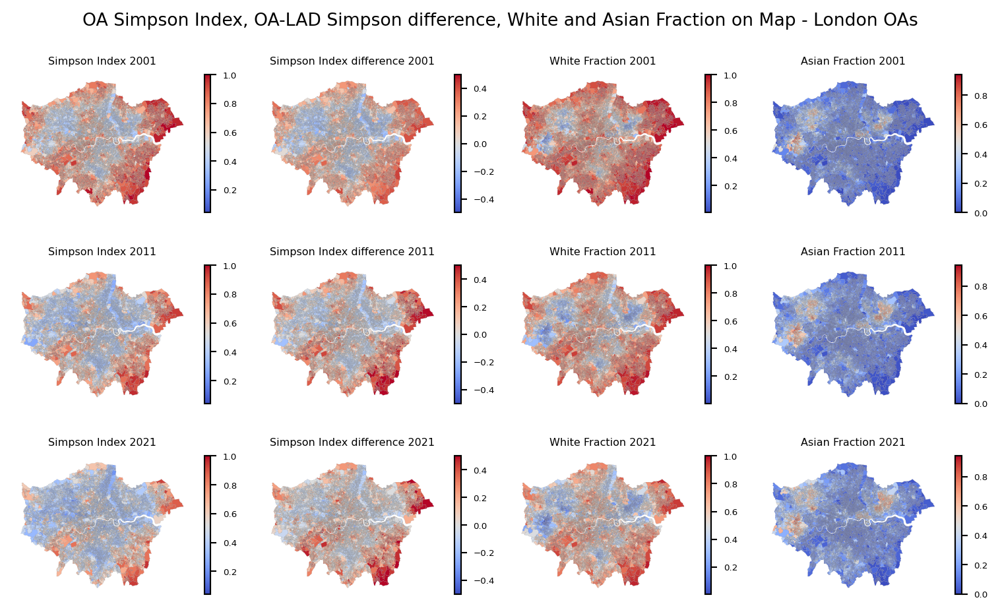

In [170]:
#| echo: false
#| label: fig-oalndnmap
#| fig-cap: OA Simpson Index, White and Asian Fraction and Asian Moran's I on Map - London OAs

years = [2001, 2011, 2021]

oa_simpson_min, oa_simpson_max = london['OA_simpson'].min(), london['OA_simpson'].max()
white_fraction_min, white_fraction_max = london['white_fraction'].min(), london['white_fraction'].max()
asian_fraction_min, asian_fraction_max = london['asian_fraction'].min(), london['asian_fraction'].max()

# Reverse the colormap for the last column
fig, axes = plt.subplots(nrows=3, ncols=4, figsize=(8, 8))

# Flatten the axes array for easier iteration
axes = axes.flatten()

# Variables and titles for the plots
variables = [
    ('OA_simpson', oa_simpson_min, oa_simpson_max, 'Simpson Index', 'coolwarm'),
    ('simp_diff', -0.5,0.5, 'Simpson Index difference', 'coolwarm'),
    ('white_fraction', white_fraction_min, white_fraction_max, 'White Fraction', 'coolwarm'),
    ('asian_fraction', asian_fraction_min, asian_fraction_max, 'Asian Fraction', 'coolwarm'),
]

# Loop through years and variables to plot the maps
for j, year in enumerate(years):
    for i, (variable, min_val, max_val, title, cmap) in enumerate(variables):
        # Filter data for the given year
        data_year = london[london['year'] == year]

        # Determine the correct subplot index
        ax_index = j * 4 + i
        
        # Plot the variable
        ax = axes[ax_index]
        divider = make_axes_locatable(ax)
        cax = divider.append_axes("right", size="3.5%", pad=0.1)
        data_year.plot(column=variable, cmap=cmap, linewidth=0.05, ax=ax, edgecolor='0.5',
                       vmin=min_val, vmax=max_val, legend=False)
        # Manually create the colorbar
        norm = plt.Normalize(vmin=min_val, vmax=max_val)
        cbar = plt.colorbar(plt.cm.ScalarMappable(norm=norm, cmap=cmap), cax=cax)
        cbar.ax.tick_params(labelsize=5)

        ax.set_title(f'{title} {year}', fontsize=6)
        ax.axis('off')

fig.suptitle('OA Simpson Index, OA-LAD Simpson difference, White and Asian Fraction on Map - London OAs', fontsize=10, y= 0.78)

# Adjust layout
plt.subplots_adjust(hspace=-0.7)
plt.tight_layout(rect=[0, 0, 1, 0.96])
plt.show()



### London Map – LSOA Level
<p style="text-align: justify;">
@fig-lsoalndnmap shows the Simpson Index for each LSOA in London and its difference from the town-wide Simpson Index. In the right-side column of the plot, the Asian Moran's I index for each LSOA is displayed. Based on the plot, no pattern can be observed and the predominant value for the Asian Moran's I index is negative or close to zero, indicating no significant clustering or dispersion of the Asian population in OAs within LSOAs.
</p>

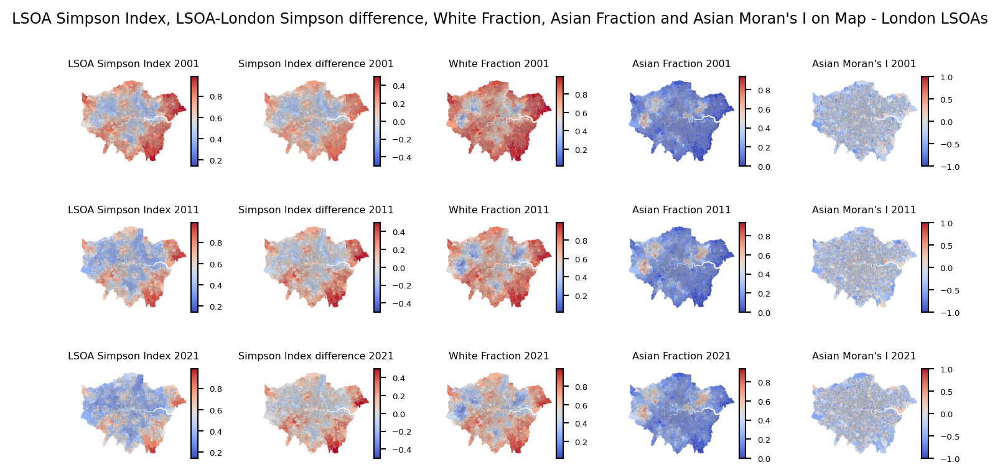

In [171]:
#| echo: false
#| label: fig-lsoalndnmap
#| fig-cap: LSOA Simpson Index, LSOA-London Simpson difference, White Fraction, Asian Fraction and Asian Moran\'s I on Map- London LSOAs

years = [2001, 2011, 2021]

lsoa_simpson_min, lsoa_simpson_max = london_LSOA['LSOA_simpson'].min(), london_LSOA['LSOA_simpson'].max()
white_fraction_min, white_fraction_max = london_LSOA['white_fraction'].min(), london_LSOA['white_fraction'].max()

# Reverse the colormap for the last column
fig, axes = plt.subplots(nrows=3, ncols=5, figsize=(8, 8))

# Flatten the axes array for easier iteration
axes = axes.flatten()

# Variables and titles for the plots
variables = [
    ('LSOA_simpson', lsoa_simpson_min, lsoa_simpson_max, 'LSOA Simpson Index', 'coolwarm'),
    ('simp_diff', -0.5,0.5, 'Simpson Index difference', 'coolwarm'),
    ('white_fraction', white_fraction_min, white_fraction_max, 'White Fraction', 'coolwarm'),
    ('asian_fraction', asian_fraction_min, asian_fraction_max, 'Asian Fraction', 'coolwarm'),
    ('asian_moran', -1, 1, "Asian Moran's I", 'coolwarm')
    
]

# Loop through years and variables to plot the maps
for j, year in enumerate(years):
    for i, (variable, min_val, max_val, title, cmap) in enumerate(variables):
        # Filter data for the given year
        data_year = london_LSOA[london_LSOA['year'] == year]

        # Determine the correct subplot index
        ax_index = j * 5 + i
        
        # Plot the variable
        ax = axes[ax_index]
        divider = make_axes_locatable(ax)
        cax = divider.append_axes("right", size="3.5%", pad=-0.3)
        data_year.plot(column=variable, cmap=cmap, linewidth=0.05, ax=ax, edgecolor='0.5',
                       vmin=min_val, vmax=max_val, legend=False)

        # Manually create the colorbar
        norm = plt.Normalize(vmin=min_val, vmax=max_val)
        cbar = plt.colorbar(plt.cm.ScalarMappable(norm=norm, cmap=cmap), cax=cax)
        cbar.ax.tick_params(labelsize=5)

        ax.set_title(f'{title} {year}', fontsize=6)
        ax.axis('off')
        
fig.suptitle('LSOA Simpson Index, LSOA-London Simpson difference, White Fraction, Asian Fraction and Asian Moran\'s I on Map - London LSOAs', 
             fontsize=9, y=0.73)

# Adjust layout
plt.subplots_adjust(hspace=-0.8)
plt.tight_layout(rect=[0, 0, 1, 0.96])
plt.show()

### London Map – MSOA Level
<p style="text-align: justify;">
@fig-msoalndnmap displays the Simpson Index for each MSOA and its deviation from the city-wide Simpson Index in London. In the first column of the plot, the Simpson Index shows a decreasing trend. However, according to the second column, the disparity between the MSOA Simpson Index and the city-wide Simpson Index approaches from negative values to zero where the Simpson Index is low but appears to increase at some edges.

<p style="text-align: justify;">
On the map of the OA-based Asian Moran's I index, positive values predominate, primarily in areas where the Simpson Index is low. Regarding the White Moran's I index, the values appear higher than for Asians, with no discernible pattern observed.
</p>

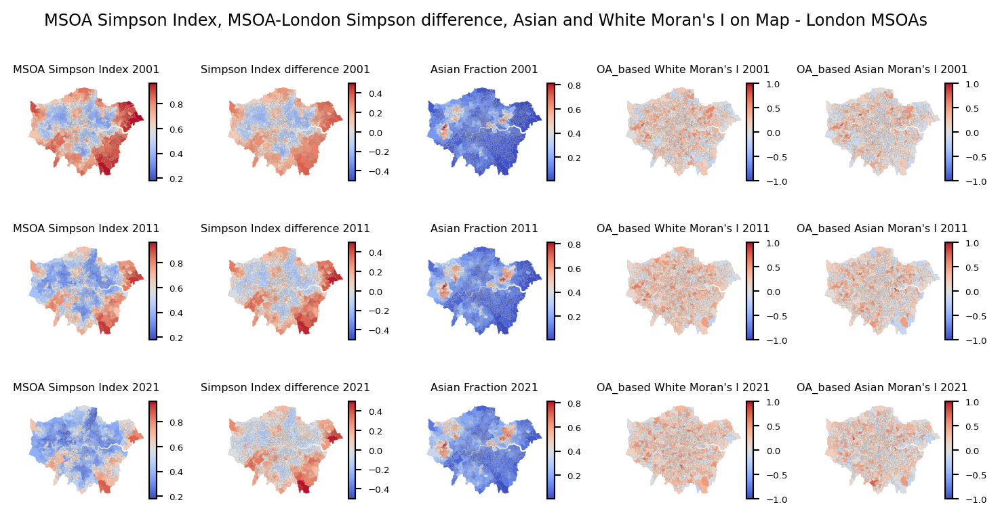

In [172]:
#| echo: false
#| label: fig-msoalndnmap
#| fig-cap: MSOA Simpson Index, MSOA-London Simpson difference, Asian and White Moran's I on Map - London MSOAs

years = [2001, 2011, 2021]

msoa_simpson_min, msoa_simpson_max = london_MSOA['MSOA_simpson'].min(), london_MSOA['MSOA_simpson'].max()
asian_fraction_min, asian_fraction_max = london_MSOA['asian_fraction'].min(), london_MSOA['asian_fraction'].max()

# Reverse the colormap for the last column
fig, axes = plt.subplots(nrows=3, ncols=5, figsize=(8, 8))

# Flatten the axes array for easier iteration
axes = axes.flatten()

# Variables and titles for the plots
variables = [
    ('MSOA_simpson', msoa_simpson_min, msoa_simpson_max, 'MSOA Simpson Index', 'coolwarm'),
    ('simp_diff', -0.5,0.5, 'Simpson Index difference', 'coolwarm'),
    ('asian_fraction', asian_fraction_min, asian_fraction_max, 'Asian Fraction', 'coolwarm'),
    ('white_moran_OA', -1, 1, "OA_based White Moran's I", 'coolwarm'),
    ('asian_moran_OA', -1, 1, "OA_based Asian Moran's I", 'coolwarm')
    
]

# Loop through years and variables to plot the maps
for j, year in enumerate(years):
    for i, (variable, min_val, max_val, title, cmap) in enumerate(variables):
        # Filter data for the given year
        data_year = london_MSOA[london_MSOA['year'] == year]

        # Determine the correct subplot index
        ax_index = j * 5 + i
        
        # Plot the variable
        ax = axes[ax_index]
        divider = make_axes_locatable(ax)
        cax = divider.append_axes("right", size="3.5%", pad=-0.3)
        data_year.plot(column=variable, cmap=cmap, linewidth=0.05, ax=ax, edgecolor='0.5',
                       vmin=min_val, vmax=max_val, legend=False)
        
        # Manually create the colorbar
        norm = plt.Normalize(vmin=min_val, vmax=max_val)
        cbar = plt.colorbar(plt.cm.ScalarMappable(norm=norm, cmap=cmap), cax=cax)
        cbar.ax.tick_params(labelsize=5)

        ax.set_title(f'{title} {year}', fontsize=6)
        ax.axis('off')

fig.suptitle('MSOA Simpson Index, MSOA-London Simpson difference, Asian and White Moran\'s I on Map - London MSOAs', 
             fontsize=9, y=0.73)

# Adjust layout
plt.subplots_adjust(hspace=-0.8)
plt.tight_layout(rect=[0, 0, 1, 0.96])
plt.show()


### London Map – LAD Level
<p style="text-align: justify;">
@fig-ladlndnmap depicts the 33 LADs of London. In the first column of the plot, it is observed that the Simpson Index in the eastern areas of London was rather high in 2001 but decreased in the subsequent years. The difference between the LADs' Simpson Index and the city-wide Simpson Index did not show a significant change, especially from 2011 to 2021. The Asian fraction is considerably increasing in the western parts of the city, as well as in three LADs in the northeast. The White and Asian Moran's I indices did not experience a drastic change; generally, the White Moran's I appears to be higher than the Asian Moran's I.
</p>

In [173]:
#| include: false
london_LAD= pd.merge(london_LAD,LAD_moran_total[['LADCD','year','OA_white_mor', 'LSOA_white_mor',
       'MSOA_white_mor', 'OA_asian_mor', 'LSOA_asian_mor', 'MSOA_asian_mor']], on=['LADCD','year'], how= 'left')

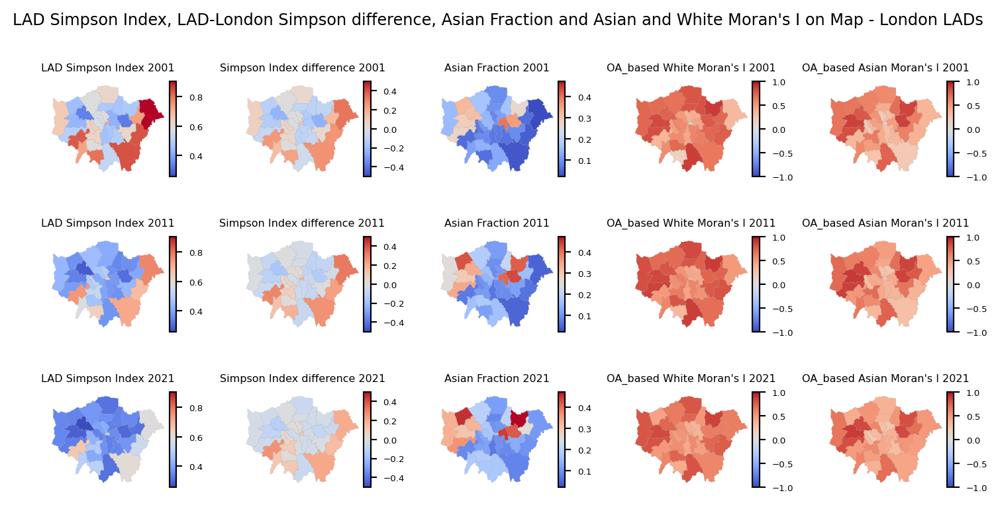

In [174]:
#| echo: false
#| label: fig-ladlndnmap
#| fig-cap: LAD Simpson Index, LAD-London Simpson difference, Asian Fraction and Asian and White Moran's I on Map - London LADs

years = [2001, 2011, 2021]

lad_simpson_min, lad_simpson_max = london_LAD['LAD_simpson'].min(), london_LAD['LAD_simpson'].max()
asian_fraction_min, asian_fraction_max = london_LAD['asian_fraction'].min(), london_LAD['asian_fraction'].max()

# Reverse the colormap for the last column
fig, axes = plt.subplots(nrows=3, ncols=5, figsize=(8, 8))

# Flatten the axes array for easier iteration
axes = axes.flatten()

# Variables and titles for the plots
variables = [
    ('LAD_simpson', lad_simpson_min, lad_simpson_max, 'LAD Simpson Index', 'coolwarm'),
    ('simp_diff', -0.5,0.5, 'Simpson Index difference', 'coolwarm'),
    ('asian_fraction', asian_fraction_min, asian_fraction_max, 'Asian Fraction', 'coolwarm'),
    ('OA_white_mor', -1, 1, "OA_based White Moran's I", 'coolwarm'),
    ('OA_asian_mor', -1, 1, "OA_based Asian Moran's I", 'coolwarm')
    
]

# Loop through years and variables to plot the maps
for j, year in enumerate(years):
    for i, (variable, min_val, max_val, title, cmap) in enumerate(variables):
        # Filter data for the given year
        data_year = london_LAD[london_LAD['year'] == year]

        # Determine the correct subplot index
        ax_index = j * 5 + i
        
        # Plot the variable
        ax = axes[ax_index]
        divider = make_axes_locatable(ax)
        cax = divider.append_axes("right", size="3.5%", pad=-0.3)
        data_year.plot(column=variable, cmap=cmap, linewidth=0.05, ax=ax, edgecolor='0.5',
                       vmin=min_val, vmax=max_val, legend=False)
        
        # Manually create the colorbar
        norm = plt.Normalize(vmin=min_val, vmax=max_val)
        cbar = plt.colorbar(plt.cm.ScalarMappable(norm=norm, cmap=cmap), cax=cax)
        cbar.ax.tick_params(labelsize=5)

        ax.set_title(f'{title} {year}', fontsize=6)
        ax.axis('off')

fig.suptitle('LAD Simpson Index, LAD-London Simpson difference, Asian Fraction and Asian and White Moran\'s I on Map - London LADs', 
             fontsize=9, y=0.73)

# Adjust layout
plt.subplots_adjust(hspace=-0.8)
plt.tight_layout(rect=[0, 0, 1, 0.96])
plt.show()


### London Correlations Heatmap
<p style="text-align: justify;">
@fig-lndnheatmap illustrates the linear correlation between the LSOA Simpson Index and the ethnicity fractions in each LSOA. Compared to other cities studied, the correlation between the Simpson Index and the White fraction in London is rather high but decreasing across the years.
</p>

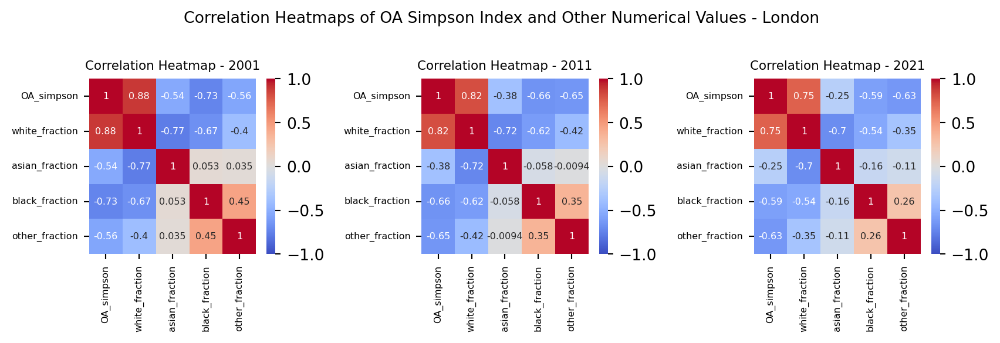

In [175]:
#| echo: false
#| label: fig-lndnheatmap
#| fig-cap: Correlation Heatmap - London
numerical_columns = ['OA_simpson', 'white_fraction', 'asian_fraction', 'black_fraction', 'other_fraction']

years = [2001, 2011, 2021]

correlation_dic = {}
for year in years:
    # Filter data for the specific year
    corr_df = london_OA[london_OA['year'] == year][numerical_columns]
    correlation_matrix = corr_df.corr()
    correlation_dic[year] = correlation_matrix

fig, axes = plt.subplots(1, 3, figsize=(9, 3))

# Plot each heatmap in a subplot
for i, year in enumerate(years):
    ax = axes[i]
    sns.heatmap(correlation_dic[year], annot=True, cmap='coolwarm', vmin=-1, vmax=1, ax=ax, annot_kws={"size": 6})
    ax.set_title(f'Correlation Heatmap - {year}', fontsize=8)
    ax.tick_params(axis='x', labelsize=6)
    ax.tick_params(axis='y', labelsize=6) 

# Adjust layout
plt.tight_layout(rect=[0, 0, 1, 0.96])
plt.suptitle('Correlation Heatmaps of OA Simpson Index and Other Numerical Values - London', fontsize=10, y=1)
plt.tight_layout()
plt.show()

# Comparing the cities
<p style="text-align: justify;">
In this part of the study, all the aforementioned cities are compared based on various aspects. Table below presents the correlation coefficient between the OA-based Simpson index and the White fraction in each city. The table indicates that this correlation is positive and rather strong. However, the correlation of the OA-based Simpson index with other ethnicity fractions is negative across all cities. By 2021, as the White fraction in all the selected cities decreases, this correlation also diminishes.
<p style="text-align: justify;">
In 2011, in Leicester, the White ethnicity remains the largest among other ethnicities, but the Asian fraction has increased, reducing the difference between the White and Asian fractions to less than 15%. Consequently, the Simpson Index does not have a strong correlation with the White fraction, though its value is still positive. By 2021, this correlation in Leicester turns negative as the Asian ethnic fraction surpasses the White ethnic fraction, resulting in a positive correlation (0.45) with the Asian fraction.
</p>

| Year | Birmingham | Leicester | Bradford | Blackburn | Oldham | Pendle | London |
|------|------------|-----------|----------|-----------|--------|--------|--------|
| 2001 | 0.75       | 0.54      | 0.73     | 0.70      | 0.74   | 0.87   | 0.88   |
| 2011 | 0.66       | 0.20      | 0.65     | 0.61      | 0.58   | 0.81   | 0.82   |
| 2021 | 0.53       | -0.27*    | 0.60     | 0.52      | 0.59   | 0.78   | 0.75   |

In [176]:
#| include: false
selected_cities = pd.concat(
    [birmingham_indexes.drop(columns=['LAD_pop', 'OA_LAD_diff', 'LSOA_LAD_diff','MSOA_LAD_diff','geometry'], axis = 1), 
    leicester_indexes.drop(columns=['LAD_pop', 'OA_LAD_diff', 'LSOA_LAD_diff','MSOA_LAD_diff','geometry'], axis = 1), 
    bradford_indexes.drop(columns=['LAD_pop', 'OA_LAD_diff', 'LSOA_LAD_diff','MSOA_LAD_diff','geometry'], axis = 1), 
    blackburn_indexes.drop(columns=['LAD_pop', 'OA_LAD_diff', 'LSOA_LAD_diff','MSOA_LAD_diff','geometry'], axis = 1), 
    oldham_indexes.drop(columns=['LAD_pop', 'OA_LAD_diff', 'LSOA_LAD_diff','MSOA_LAD_diff','geometry'], axis = 1), 
    pendle_indexes.drop(columns=['LAD_pop', 'OA_LAD_diff', 'LSOA_LAD_diff','MSOA_LAD_diff','geometry'], axis = 1),
    london_indexes.drop(columns=['London_simpson'], axis = 1)]).reset_index(drop=True)


<p style="text-align: justify;">
@fig-citytrend illustrates the changes in various indices over the years for each city, along with a comparison to other selected cities.
In the first row of the figure, it is evident that in all cities, the White fraction is decreasing while the Asian fraction is increasing. Leicester has the lowest White fraction and the highest Asian fraction.
<p style="text-align: justify;">
In the second row, it can be observed that London has the lowest dissimilarity index for both the White and Asian fractions, indicating a more even distribution of these ethnicities across OAs. However, Blackburn and Pendle show a slight increase in the White dissimilarity index in 2021, while other cities exhibit a decreasing trend. The Asian dissimilarity index shows an increasing trend in Pendle in 2021.
<p style="text-align: justify;">
The third row shows that the Simpson index, based on both OA and LAD levels, exhibits a decreasing trend across all cities.
<p style="text-align: justify;">
In the fourth row, which depicts Moran’s I index, it is clear that, except for London and Birmingham, the White and Asian Moran’s I index values are increasing. Pendle is experiencing the highest rate of increase. This indicates that in these cities, OAs with similar values are becoming more clustered.


In [177]:
#| echo: false
#| label: fig-citytrend
#| fig-cap: Indices Trends in Selected English Cities (2001-2021)

# Extend the color list
colors = ['#636EFA', '#EF553B', '#00CC96', '#AB63FA', '#FFA15A', '#19D3F3','#FF6692']

# Create subplots
fig = make_subplots(rows=4, cols=2, subplot_titles=('White Fraction', 'Asian Fraction',
                                                    'White OA-based Dissimilarity','Asian OA-based Dissimilarity',
                                                    'OA-based Simpsom', 'LAD-based Simpsom',
                                                    'White Moran\'s I ','Asian Moran\'s I'),
                    vertical_spacing=0.08, horizontal_spacing=0.05,
                    row_heights=[0.3, 0.3, 0.3,0.3])


# Plot White fraction trend
for i, city in enumerate(selected_cities.LADNM.unique()):
    city_data = selected_cities[selected_cities['LADNM'] == city]
    fig.add_trace(go.Scatter(x=city_data['year'], y=city_data['white_frac'], mode='lines+markers', 
                             name=city, line=dict(color=colors[i]), showlegend=True), row=1, col=1)

# Plot Asian fraction trend
for i, city in enumerate(selected_cities.LADNM.unique()):
    city_data = selected_cities[selected_cities['LADNM'] == city]
    fig.add_trace(go.Scatter(x=city_data['year'], y=city_data['asian_frac'], mode='lines+markers', 
                             name=city, line=dict(color=colors[i]), showlegend=False), row=1, col=2)

for i, city in enumerate(selected_cities.LADNM.unique()):
    city_data = selected_cities[selected_cities['LADNM'] == city]
    fig.add_trace(go.Scatter(x=city_data['year'], y=city_data['OA_white_diss'], mode='lines+markers', 
                             name=city, line=dict(color=colors[i]), showlegend=False), row=2, col=1)

for i, city in enumerate(selected_cities.LADNM.unique()):
    city_data = selected_cities[selected_cities['LADNM'] == city]
    fig.add_trace(go.Scatter(x=city_data['year'], y=city_data['OA_asian_diss'], mode='lines+markers', 
                             name=city, line=dict(color=colors[i]), showlegend=False), row=2, col=2)

for i, city in enumerate(selected_cities.LADNM.unique()):
    city_data = selected_cities[selected_cities['LADNM'] == city]
    fig.add_trace(go.Scatter(x=city_data['year'], y=city_data['OA_simpson'], mode='lines+markers', 
                             name=city, line=dict(color=colors[i]), showlegend=False), row=3, col=1)

for i, city in enumerate(selected_cities.LADNM.unique()):
    city_data = selected_cities[selected_cities['LADNM'] == city]
    fig.add_trace(go.Scatter(x=city_data['year'], y=city_data['LAD_simpson'], mode='lines+markers', 
                             name=city, line=dict(color=colors[i]), showlegend=False), row=3, col=2)
    
for i, city in enumerate(selected_cities.LADNM.unique()):
    city_data = selected_cities[selected_cities['LADNM'] == city]
    fig.add_trace(go.Scatter(x=city_data['year'], y=city_data['OA_white_mor'], mode='lines+markers', 
                             name=city, line=dict(color=colors[i]), showlegend=False), row=4, col=1)

for i, city in enumerate(selected_cities.LADNM.unique()):
    city_data = selected_cities[selected_cities['LADNM'] == city]
    fig.add_trace(go.Scatter(x=city_data['year'], y=city_data['OA_asian_mor'], mode='lines+markers', 
                             name=city, line=dict(color=colors[i]), showlegend=False), row=4, col=2)

# Update layout
fig.update_layout(height=850, width=850, title_text="Indices Trends in Selected English Cities (2001-2021)", 
                  title_x=0.5,
                  title_y=1,
                  legend=dict(orientation="h",y= 1.12, xanchor="center", x=0.5))
fig.update_xaxes(tickvals=[2001, 2011, 2021])

# Show plot
fig.show()

# Conclusion
<p style="text-align: justify;" >
In this study, a comprehensive analysis of segregation indexes was performed at the country level, LAD level, and in selected cities of England. The results show that in Output Areas (OAs), which are small and designed to be relatively homogeneous, the Simpson Index reflects micro-level variations within neighborhoods. Some OAs, predominantly composed of a single ethnic group, have higher Simpson Index values, indicating lower diversity within those OAs. However, aggregating across all OAs balances out these variations, providing a more generalized measure of diversity for the entire urban area.
<p style="text-align: justify;" >
Individual neighborhoods within a city might show higher Simpson Indices due to localized ethnic concentrations. However, when considering the city as a whole, the town-wide Simpson Index is lower (or equal) because the overall composition includes a mix of diverse neighborhoods. LAD-wise indices, which aggregate data across a larger sample size, offer a broader view compared to OAs, smoothing out local variations and providing a more comprehensive measure of diversity.
<p style="text-align: justify;" >
A higher Simpson Index indicates lower diversity, suggesting a dominant ethnic group within the area. This dominance means individuals are more likely to be from the same ethnic group when chosen randomly. The maps show that higher White ethnicity fractions correspond to higher Simpson Index values. When the OA Simpson Index is much higher than the town-wide Simpson Index, it indicates strong local concentration. For example, a high OA-based Simpson Index, which is the probability that a randomly selected pair of individuals from the same OA belongs to one ethnic group, shows that the OA is less diverse compared to an OA with a lower Simpson Index. In addition, the results show that moving from 2001 to 2021, Simpson index at country and LAD level is generally decreasing.
<p style="text-align: justify;" >
Based on the analysis of the dissimilarity index at various geographic levels, the findings indicate a general decrease in the index values for both White and Asian ethnicities over the studied period and by expanding the area of study. This decline in the dissimilarity index suggests increasing spatial integration and a reduction in ethnic segregation within these communities. These findings reflect positive strides toward achieving greater ethnic cohesion and reducing segregation in urban settings.
<p style="text-align: justify;" >
The different spatial scales of analysis—OAs, LSOAs, and LADs—affect our interpretation of diversity and spatial patterns. OAs are smaller and more homogeneous, leading to higher Moran's I values, indicating stronger spatial clustering. LSOAs are larger and encompass a greater diversity of neighborhoods, which can dilute spatial autocorrelation and lead to lower Moran's I values. This trend is especially observed when comparing data from 2011 to 2021.
<p style="text-align: justify;" >
The spatial scale effect is evident: at the local scale (OAs), Moran's I captures fine-scale variations and local clusters within neighborhoods. At the aggregated scale (LSOAs), Moran's I smooths out local variations, offering a broader view that may reduce spatial autocorrelation. This highlights the importance of considering the scale of analysis when interpreting spatial patterns and autocorrelation.
<p style="text-align: justify;" >
The overall trends from 2001 to 2021 indicate a positive movement towards greater ethnic cohesion and reduced segregation in England. The decrease in both the dissimilarity and Simpson indices at the country and LAD levels points to increasing diversity and integration within urban areas. However, the increase in Moran's I at the OA level within LADs suggests that while broader integration is occurring, localized clustering of ethnic groups persists. By understanding both macro and micro-level trends, more effective and targeted interventions can be developed to enhance social cohesion and integration in England's urban landscapes.



Comprehensive Analysis: Segregation indexes examined at country, LAD, and city levels in England.
Simpson Index Findings: Higher values in homogeneous OAs; overall diversity balanced out across all OAs.
Neighborhood Diversity: Localized ethnic concentrations in neighborhoods; town-wide indices reflect broader diversity.
Dissimilarity Index Trends: Decrease in values for White and Asian ethnicities, indicating increased integration.
Spatial Scale Effects: Higher Moran's I at local scales (OAs) vs. broader scales (LSOAs).
Overall Trends (2001-2021): Positive movement towards greater ethnic cohesion and reduced segregation; persistent localized clustering at OA level.
</p>